In [ ]:
!pip install wget

  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9672 sha256=1782cc17577a208c09c1088dd3c7edb96a9948b40bfbcfb31d31b485bfd3a9f6
  Stored in directory: /root/.cache/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built wget


In [ ]:
from typing import Dict

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
import torch
from torch import nn, optim
from torch.utils.data import DataLoader
from torch.autograd import Variable
import torch.nn.functional as F
from torch.distributions import Normal
from torch.utils.data import Dataset
from torchvision import transforms, datasets

In [ ]:
from pathlib import Path

In [ ]:
from tqdm import tqdm as tqdm

In [ ]:
import wget
import os
import requests
import json

In [ ]:
from os import listdir
from os.path import isfile, join

In [ ]:
IMG_SIZE = 28

def image_normalize(img):
    img_min = img.min()
    img_max = img.max()
    if img_min < img_max:
        img = (img - img_min) / (img_max - img_min)
    return img


def to_image_tensor(input_tensor, n_rows=15, n_cols=15, width=IMG_SIZE, height=IMG_SIZE):
    images_to_plot = n_rows * n_cols
    tensor_to_plot = input_tensor[:images_to_plot, :]
    image_grid = np.zeros((1, n_rows * height, n_cols * width))
    for i in range(images_to_plot):
        r = i//n_rows
        c = i%n_cols
        image_grid[:, r * height:(r + 1) * height, c * width:(c + 1) * width] = tensor_to_plot[i, :].reshape(1, width, height)
    return torch.Tensor(image_normalize(image_grid))


def latent_space_embeddings(size: int, sigma: float = 1.) -> torch.Tensor:
    x_values = np.linspace(-3 * sigma, 3 * sigma, size)
    y_values = np.linspace(-3 * sigma, 3 * sigma, size)
    xx, yy = np.meshgrid(x_values, y_values)
    xx, yy = xx.reshape(-1), yy.reshape(-1)
    grid = np.vstack((xx, yy)).T
    return torch.FloatTensor(grid)



def sample_latent_space_embeddings(model: nn.Module, sample_size: int) -> torch.Tensor:
    with torch.no_grad():
        size = int(np.sqrt(sample_size))
        model.train(False)
        device = model.device
        grid = latent_space_embeddings(size)
        grid = grid.view(grid.size(0), -1).to(device)
        generated_batch = model.decode(grid)
        generated_grid = to_image_tensor(generated_batch.cpu(), n_cols=size, n_rows=size)
        return generated_grid


In [ ]:
def get_links(user: str, repo: str, path: str):
    url = f'https://api.github.com/repos/{user}/{repo}/contents/{path}'
    files = requests.get(url=url).json()
    return list(map(lambda file: file['download_url'], files))

here

In [ ]:
def download_data():
    urls = get_links(user="niazangels", repo="vae-pokedex", path="data/pokemon/jpeg")
    path = os.getcwd()
    path = path + '/data'
    try:
        os.mkdir(path)
    except OSError:
        print (f'Exists {path}')
    else:
        print (f'Created {path}')
    for url in urls:
        url = url.replace('%20', ' ')
        filename = url.rpartition('/')[2]
        try:
            print(f'\r Downloading: {filename}', end='')
            wget.download(url, out=path + '/' + filename)
        except requests.exceptions.HTTPError as e:
            print(e)

In [ ]:
download_data()

Created /content/data
 Downloading: Litwick-3.jpg

In [ ]:
def read_images_content(filepath: Path):
    files = [f for f in listdir(filepath) if isfile(join(filepath, f))]
    dirname = os.path.basename(filepath)
    images = [plt.imread(dirname + '/' + f) for f in files]
    return images

In [ ]:
IMG_SIZE = 28

In [ ]:
transform = transforms.Compose([transforms.ToPILImage(),
                                transforms.Resize((IMG_SIZE, IMG_SIZE)),
                                transforms.Grayscale(),
                                transforms.ToTensor()])

In [ ]:
class PokemonDataset(Dataset):
    def __init__(self, data_file: Path, transform=None):
        self.data = read_images_content(data_file)
        self.transform = transform

    def __getitem__(self, index: int) -> torch.Tensor:
        sample = self.data[index]
        if self.transform:
            sample = self.transform(sample)
        return sample.squeeze()

    def __len__(self):
        return len(self.data)

In [ ]:
data = PokemonDataset(Path('data/'), transform=transform)

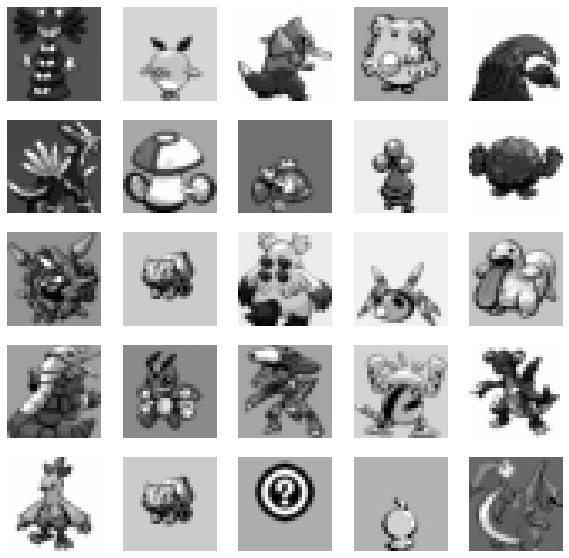

In [ ]:
ind = np.random.randint(1, high=len(data), size=25)
pokemons = [data[i] for i in ind]
fig, ax = plt.subplots(5, 5, sharex='col', sharey='row', figsize=(10,10))
for i in range(5):
    for j in range(5):
        ax[i,j].imshow(pokemons[i*5 + j].reshape(IMG_SIZE, IMG_SIZE), cmap='gray')
        ax[i,j].axis('off')

In [ ]:
batch_size = 100
dataloader = torch.utils.data.DataLoader(data, batch_size=batch_size, shuffle=True)
num_batches = len(dataloader)

In [ ]:
FEAT_SIZE = IMG_SIZE * IMG_SIZE

In [ ]:
def loss_function(out, inp, mu, gamma):
    bce = F.binary_cross_entropy(out, inp.view(-1, FEAT_SIZE), reduction='mean')
    kld = -0.5 * torch.sum(1 + gamma - mu.pow(2) - gamma.exp())
    batch_size = inp.shape[0]
    kld /= batch_size * FEAT_SIZE
    return bce, kld

In [ ]:
class VariationalAutoencoder(nn.Module):
    def __init__(self, latent_dim, negative_slope=0.2):
        super().__init__()
        self.latent_dim = latent_dim

        self.mu = nn.Linear(128, latent_dim)
        self.gamma = nn.Linear(128, latent_dim)

        self.normal = Normal(loc=0., scale=1.)

        self.encoder_1 = nn.Sequential(
            nn.Conv2d(1, 8, kernel_size=5, stride=1, padding=2),
            nn.LeakyReLU(negative_slope=negative_slope),
            nn.MaxPool2d(2, 2),
            nn.Conv2d(8, 16, kernel_size=5, stride=1, padding=2),
            nn.LeakyReLU(negative_slope=negative_slope),
            nn.MaxPool2d(2, 2))
        self.encoder_2 = nn.Sequential(nn.Linear(7 * 7 * 16, 256),
            nn.LeakyReLU(negative_slope=negative_slope),
            nn.Linear(256, 128),

            nn.LeakyReLU(negative_slope=negative_slope),
        )

        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, 128),
            nn.LeakyReLU(negative_slope=negative_slope),
            nn.Linear(128, 256),
            nn.LeakyReLU(negative_slope=negative_slope),
            nn.Linear(256, 512),
            nn.LeakyReLU(negative_slope=negative_slope),
            nn.Linear(512, FEAT_SIZE),
            nn.Sigmoid()
        )

    @property
    def device(self) -> torch.device:
        return self.encoder[0].weight.device

    def forward(self, x, *args):
        mu, gamma = self.encode(x)
        encoding = self.reparameterize(mu, gamma)
        x = self.decoder(encoding)
        return x, mu, gamma

    def reparameterize(self, mu, gamma):
        if self.training:
            sigma = torch.exp(0.5*gamma)
            std_z = self.normal.sample(sample_shape=sigma.size())
            encoding = std_z.mul(sigma).add(mu)
            return encoding
        else:
            return mu

    def encode(self, x):
        x = self.encoder_1(x)
        x = x.reshape(x.size(0), -1)
        x = self.encoder_2(x)
        mu = self.mu(x)
        gamma = self.gamma(x)
        return mu, gamma

    def decode(self, x):
        return self.decoder(x)

    def latent(self, x):
        mu, gamma = self.encode(x)
        encoding = self.reparameterize(mu, gamma)
        return encoding

    def noise(self, sample_size: int) -> torch.Tensor:
        z = self.normal.sample(sample_shape=(sample_size, self.latent_dim))
        return z

    def sample(self, sample_size: int) -> torch.Tensor:
        z = self.noise(sample_size)
        return self.decode(z)

In [ ]:
model = VariationalAutoencoder(10)
if torch.cuda.is_available():
    model.cuda()

In [ ]:
learning_rate = 0.0002

In [ ]:
optimizer = optim.Adam(model.parameters(), lr=learning_rate, betas=(0.5, 0.999))

In [ ]:
def images_to_vectors(images, n_features=FEAT_SIZE):
    return images.view(images.size(0), n_features)

In [ ]:
def plot_sample_images(generator, cols=5, rows=5, width=256, height=256, figsize=(10, 10)):
    sample = generator.sample(cols * rows).data.cpu().numpy()
    fig, ax = plt.subplots(cols, rows, sharex='col', sharey='row', figsize=figsize)
    for i in range(rows):
        for j in range(cols):
            ax[i,j].imshow(sample[i*rows + j].reshape(width, height), cmap='gray')
            ax[i,j].axis('off')

In [ ]:
def train_vae(num_epochs=100):
    losses = []
    for epoch in range(num_epochs):
        print(f'\r epoch: [{epoch+1}/{num_epochs}]', end='')
        loss, b = 0, 0
        for batch in tqdm(dataloader, ncols=340, desc=f'Epoch {epoch + 1}'):
            inp = batch.view(batch.shape[0], 1, batch.shape[1], batch.shape[2]).float()
            sample_size = inp.size(0)
            print(inp.shape)
            out, mu, gamma = model(inp)
            bce, kld = loss_function(out, inp, mu, gamma)
            total_loss = bce + kld
            total_loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            loss += total_loss.data.cpu()
            b += 1
        loss /= float(b)
        losses.append(loss)
    return losses

In [ ]:
num_epochs = 2500
losses = train_vae(num_epochs=num_epochs)

 epoch: [1/2500]

Epoch 1:   0%|                                                                                                                                                                                                                                                                                                               | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
Epoch 1:  30%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                              | 3/10 [00:00<00:01,  6.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                        | 7/10 [00:00<00:00, 10.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.21it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2/2500]

Epoch 2:  20%|███████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 2/10 [00:00<00:00, 13.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                      | 6/10 [00:00<00:00, 13.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 8/10 [00:00<00:00, 14.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [3/2500]

Epoch 3:   0%|                                                                                                                                                                                                                                                                                                               | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 3:  20%|███████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 2/10 [00:00<00:00, 12.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 3:  40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                 | 4/10 [00:00<00:00, 12.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 3:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                      | 6/10 [00:00<00:00, 13.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 3:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 8/10 [00:00<00:00, 13.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 3: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.36it/s]


torch.Size([100, 1, 28, 28])
 epoch: [4/2500]

Epoch 4:   0%|                                                                                                                                                                                                                                                                                                               | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 4:  20%|███████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 2/10 [00:00<00:00, 12.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 4:  40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                 | 4/10 [00:00<00:00, 13.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 4:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                      | 6/10 [00:00<00:00, 13.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 4:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 8/10 [00:00<00:00, 13.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 4: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.99it/s]


 epoch: [5/2500]

Epoch 5:   0%|                                                                                                                                                                                                                                                                                                               | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 5:  20%|███████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 2/10 [00:00<00:00, 12.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 5:  40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                 | 4/10 [00:00<00:00, 13.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 5:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                      | 6/10 [00:00<00:00, 13.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 5:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 8/10 [00:00<00:00, 12.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 5: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.19it/s]


torch.Size([100, 1, 28, 28])
 epoch: [6/2500]

Epoch 6:   0%|                                                                                                                                                                                                                                                                                                               | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 6:  20%|███████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 2/10 [00:00<00:00, 13.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 6:  40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                 | 4/10 [00:00<00:00, 12.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 6:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                      | 6/10 [00:00<00:00, 12.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 6:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 8/10 [00:00<00:00, 12.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 6: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.14it/s]


torch.Size([100, 1, 28, 28])
 epoch: [7/2500]

Epoch 7:   0%|                                                                                                                                                                                                                                                                                                               | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 7:  20%|███████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 2/10 [00:00<00:00, 12.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 7:  40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                 | 4/10 [00:00<00:00, 13.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 7:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                      | 6/10 [00:00<00:00, 13.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 7:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 8/10 [00:00<00:00, 12.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 7: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.19it/s]

torch.Size([100, 1, 28, 28])


 epoch: [8/2500]

Epoch 8:   0%|                                                                                                                                                                                                                                                                                                               | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 8:  20%|███████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 2/10 [00:00<00:00, 12.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 8:  40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                 | 4/10 [00:00<00:00, 12.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 8:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                      | 6/10 [00:00<00:00, 13.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 8:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 8/10 [00:00<00:00, 13.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 8: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.15it/s]

torch.Size([100, 1, 28, 28])


 epoch: [9/2500]

Epoch 9:   0%|                                                                                                                                                                                                                                                                                                               | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 9:  20%|███████████████████████████████████████████████████████████                                                                                                                                                                                                                                            | 2/10 [00:00<00:00, 12.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 9:  40%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                 | 4/10 [00:00<00:00, 13.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 9:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                      | 6/10 [00:00<00:00, 13.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 9:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 8/10 [00:00<00:00, 13.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 9: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.30it/s]


 epoch: [10/2500]

Epoch 10:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 10:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 10:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 10:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 10:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 13.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 10: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.83it/s]


 epoch: [11/2500]

Epoch 11:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 11:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 13.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 11:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 13.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 11:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 11:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 11: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 11: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 13.07it/s]


 epoch: [12/2500]

Epoch 12:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 12:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 12:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 12:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 12:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 12: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.70it/s]

torch.Size([100, 1, 28, 28])


 epoch: [13/2500]

Epoch 13:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 13:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 13:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 13:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 13:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 13: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.44it/s]


 epoch: [14/2500]

Epoch 14:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 14:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 14:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 14:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 14:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 13.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 14: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.76it/s]


 epoch: [15/2500]

Epoch 15:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 15:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 15:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 15:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 15:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 15: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.61it/s]


 epoch: [16/2500]

Epoch 16:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 16:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 16:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 12.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 16:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 16:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 16:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 16: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.48it/s]


 epoch: [17/2500]

Epoch 17:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 17:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 17:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 17:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 13.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 17:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 17: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.44it/s]


 epoch: [18/2500]

Epoch 18:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 18:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 18:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 18:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 18:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 18: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.51it/s]


 epoch: [19/2500]

Epoch 19:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 19:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 19:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 19:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 19:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 19: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [20/2500]

Epoch 20:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 20:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 20:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 13.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 20:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 20:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 20: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.73it/s]


 epoch: [21/2500]

Epoch 21:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 21:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 21:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 21:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 21:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 21: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.62it/s]


 epoch: [22/2500]

Epoch 22:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 22:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 22:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 22:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 22:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 22: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.69it/s]


 epoch: [23/2500]

Epoch 23:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 23:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 23:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 23:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 23:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 23: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.39it/s]


 epoch: [24/2500]

Epoch 24:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 24:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 24:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 24:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 24:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 24:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 24: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.21it/s]


 epoch: [25/2500]

Epoch 25:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 25:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 25:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 25:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 25:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 25: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.33it/s]


 epoch: [26/2500]

Epoch 26:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 26:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 26:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 26:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 26:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 26: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.09it/s]


 epoch: [27/2500]

Epoch 27:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 27:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 27:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 27:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 27:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 27: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.15it/s]


 epoch: [28/2500]

Epoch 28:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 28:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 28:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 28:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 28:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 28: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.60it/s]


 epoch: [29/2500]

Epoch 29:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 29:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 29:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 12.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 29:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 29:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 13.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 29:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 29: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.63it/s]


 epoch: [30/2500]

Epoch 30:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 30:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 30:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 30:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 30:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 30: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.54it/s]


 epoch: [31/2500]

Epoch 31:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 31:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 31:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 31:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 31:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 31: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.59it/s]


 epoch: [32/2500]

Epoch 32:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 32:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 32:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 32:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 32:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 32: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.63it/s]


 epoch: [33/2500]

Epoch 33:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 33:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 33:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 33:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 33:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 33:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 33: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.11it/s]


 epoch: [34/2500]

Epoch 34:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 34:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 34:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 34:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 34:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 34: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.61it/s]


 epoch: [35/2500]

Epoch 35:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 35:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 35:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 35:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 35:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 35:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 35: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.24it/s]


 epoch: [36/2500]

Epoch 36:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 36:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 36:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 36:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 36:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 36: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.42it/s]


 epoch: [37/2500]

Epoch 37:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 37:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 37:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 37:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 37:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 37:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 37: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.16it/s]


 epoch: [38/2500]

Epoch 38:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 38:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 38:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 38:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 38:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 38: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.17it/s]


 epoch: [39/2500]

Epoch 39:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 39:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 39:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 39:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 39:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 39: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.33it/s]


 epoch: [40/2500]

Epoch 40:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 40:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 40:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 40:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 40:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 40:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 40: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.92it/s]


 epoch: [41/2500]

Epoch 41:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 41:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 41:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 41:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 41:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 41: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.43it/s]


 epoch: [42/2500]

Epoch 42:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 42:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 42:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 42:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 42:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 42:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 42: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.55it/s]


 epoch: [43/2500]

Epoch 43:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 43:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 43:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 43:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 43:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 43: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [44/2500]

Epoch 44:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 44:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 44:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 44:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 44:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 44: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.22it/s]


 epoch: [45/2500]

Epoch 45:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 45:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 45:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 45:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 45:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 45: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.05it/s]


 epoch: [46/2500]

Epoch 46:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 46:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 46:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 46:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 46:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 46:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 46: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.70it/s]


 epoch: [47/2500]

Epoch 47:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 47:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 47:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 47:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 47:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 47: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.38it/s]


 epoch: [48/2500]

Epoch 48:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 48:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 48:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 48:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 48:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 48:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 48: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.85it/s]


 epoch: [49/2500]

Epoch 49:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 49:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 49:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 49:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 49:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 49: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.46it/s]


 epoch: [50/2500]

Epoch 50:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 50:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 50:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 50:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 50:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 11.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 50: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.01it/s]


 epoch: [51/2500]

Epoch 51:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 51:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 51:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 51:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 51:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 51: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.29it/s]


 epoch: [52/2500]

Epoch 52:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 52:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 52:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 52:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 11.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 52:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 52: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.92it/s]


 epoch: [53/2500]

Epoch 53:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 53:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 53:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 53:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 53:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 53:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 53: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.86it/s]


 epoch: [54/2500]

Epoch 54:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 54:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 54:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 54:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 54:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 54: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.13it/s]


torch.Size([100, 1, 28, 28])
 epoch: [55/2500]

Epoch 55:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 55:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 55:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 55:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 55:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 55:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 55: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.04it/s]


 epoch: [56/2500]

Epoch 56:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 56:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 56:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 56:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 56:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 56: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [57/2500]

Epoch 57:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 57:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 57:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 57:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 57:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 57:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 57: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.66it/s]


 epoch: [58/2500]

Epoch 58:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 58:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 58:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 13.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 58:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 58:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 58: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [59/2500]

Epoch 59:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 59:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 59:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 59:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 59:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 59:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 59: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.23it/s]


 epoch: [60/2500]

Epoch 60:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 60:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 60:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 60:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 11.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 60:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 60: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.22it/s]


torch.Size([100, 1, 28, 28])
 epoch: [61/2500]

Epoch 61:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 61:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 61:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 61:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 61:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 61:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 61: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.88it/s]


 epoch: [62/2500]

Epoch 62:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 62:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 62:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 62:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 62:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 62: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.13it/s]


torch.Size([100, 1, 28, 28])
 epoch: [63/2500]

Epoch 63:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 63:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 63:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 63:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 63:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 63:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 63: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.75it/s]


 epoch: [64/2500]

Epoch 64:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 64:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 12.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 64:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 64:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 64:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 64: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.41it/s]


torch.Size([100, 1, 28, 28])
 epoch: [65/2500]

Epoch 65:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 65:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 65:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 65:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 65:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 65: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.08it/s]


 epoch: [66/2500]

Epoch 66:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 66:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 66:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 66:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 66:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 66:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 66: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.60it/s]


 epoch: [67/2500]

Epoch 67:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 67:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 67:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 67:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 67:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 67:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 67: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.62it/s]


 epoch: [68/2500]

Epoch 68:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 68:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 68:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 68:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 68:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 68:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 68: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.86it/s]


 epoch: [69/2500]

Epoch 69:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 69:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 69:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 69:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 69:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 69:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 69: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.49it/s]


 epoch: [70/2500]

Epoch 70:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 70:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 70:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 70:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 70:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 70:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 70: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.84it/s]


 epoch: [71/2500]

Epoch 71:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 71:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 71:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 71:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 71:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 71:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 71: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.84it/s]


 epoch: [72/2500]

Epoch 72:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 72:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 72:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 72:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 11.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 72:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 11.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 72: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.70it/s]


 epoch: [73/2500]

Epoch 73:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 73:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 73:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 73:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 73:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 73:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 73: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.51it/s]


 epoch: [74/2500]

Epoch 74:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 74:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 74:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 74:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 74:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 74:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 74: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.65it/s]


 epoch: [75/2500]

Epoch 75:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 75:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 75:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 75:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 75:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 75: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [76/2500]

Epoch 76:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 76:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 76:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 76:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 76:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 76:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 76: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.72it/s]


 epoch: [77/2500]

Epoch 77:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 77:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 77:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 77:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 77:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 77: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.94it/s]


 epoch: [78/2500]

Epoch 78:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 78:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 78:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 78:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 78:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 78:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 78: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.37it/s]


 epoch: [79/2500]

Epoch 79:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 79:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 79:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 79:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 10.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 79:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 11.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 79:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 79: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.61it/s]


 epoch: [80/2500]

Epoch 80:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 80:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 80:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 80:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 80:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 80:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 80: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.45it/s]


 epoch: [81/2500]

Epoch 81:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 81:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 81:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 81:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 81: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [82/2500]

Epoch 82:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 82:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 82:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 82:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 82:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 82:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 82: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.91it/s]


 epoch: [83/2500]

Epoch 83:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 83:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 83:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 83:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 83:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 83: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.32it/s]


torch.Size([100, 1, 28, 28])
 epoch: [84/2500]

Epoch 84:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 84:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 84:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 84:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 84:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 84:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 84: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.01it/s]


 epoch: [85/2500]

Epoch 85:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 85:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 85:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 85:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 85: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.90it/s]


torch.Size([100, 1, 28, 28])
 epoch: [86/2500]

Epoch 86:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 86:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 86:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 86:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 12.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 86:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 86:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 86: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.09it/s]


 epoch: [87/2500]

Epoch 87:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 87:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 87:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 87:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 87:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 87: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.36it/s]


 epoch: [88/2500]

Epoch 88:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 88:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 88:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 88:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 11.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 88:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 88: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.01it/s]


torch.Size([100, 1, 28, 28])
 epoch: [89/2500]

Epoch 89:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 89:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 89:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 89:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 89:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 12.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 89:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 12.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 89: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.62it/s]


 epoch: [90/2500]

Epoch 90:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 90:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 10.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 90:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 90:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 11.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 90:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 90: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.10it/s]


torch.Size([100, 1, 28, 28])
 epoch: [91/2500]

Epoch 91:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 91:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 91:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 91:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 91:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 91:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 91: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.37it/s]


 epoch: [92/2500]

Epoch 92:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 92:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 92:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 12.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 92:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 92:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 92: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.31it/s]


torch.Size([100, 1, 28, 28])
 epoch: [93/2500]

Epoch 93:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 93:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 93:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 93:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 10.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 93:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 93:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 93: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.18it/s]


 epoch: [94/2500]

Epoch 94:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 94:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 94:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 94:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 94:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 94: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.34it/s]


 epoch: [95/2500]

Epoch 95:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 95:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 95:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 95:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 95:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 95:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 95: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.35it/s]


 epoch: [96/2500]

Epoch 96:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 96:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 96:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 96:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 96:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 10.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 96:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 96: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.88it/s]


 epoch: [97/2500]

Epoch 97:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 97:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 97:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 10.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 97:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 97:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 97: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.92it/s]


 epoch: [98/2500]

Epoch 98:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 98:  20%|██████████████████████████████████████████████████████████▊                                                                                                                                                                                                                                           | 2/10 [00:00<00:00, 11.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 98:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                | 4/10 [00:00<00:00, 11.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 98:  60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                     | 6/10 [00:00<00:00, 12.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 98:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 8/10 [00:00<00:00, 12.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 98: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 12.04it/s]


torch.Size([100, 1, 28, 28])
 epoch: [99/2500]

Epoch 99:   0%|                                                                                                                                                                                                                                                                                                              | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 99:  10%|█████████████████████████████▍                                                                                                                                                                                                                                                                        | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 99:  30%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 99:  50%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                   | 5/10 [00:00<00:00, 11.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 99:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                        | 7/10 [00:00<00:00, 11.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 99:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 9/10 [00:00<00:00, 11.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 99: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.55it/s]


 epoch: [100/2500]

Epoch 100:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 100:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 100:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 100:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 11.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 100:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 100:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 100: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.44it/s]


 epoch: [101/2500]

Epoch 101:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 101:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 101:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 101:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 101:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 101:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 101: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.14it/s]


 epoch: [102/2500]

Epoch 102:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 102:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 102:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 102:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 102:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 102:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 10.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 102: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.84it/s]


 epoch: [103/2500]

Epoch 103:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 103:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 103:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 103:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 103:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 103:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 103: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.03it/s]


 epoch: [104/2500]

Epoch 104:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])

Epoch 104:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.37it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 104:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 104:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 104:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 104:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 104: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.93it/s]


 epoch: [105/2500]

Epoch 105:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 105:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 105:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 105:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 105:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 105: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.08it/s]


 epoch: [106/2500]

Epoch 106:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 106:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 106:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 106:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 106:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 106: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.82it/s]


 epoch: [107/2500]

Epoch 107:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 107:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 107:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 107:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 107:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 107: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.43it/s]


 epoch: [108/2500]

Epoch 108:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 108:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 108:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 108:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 108:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 12.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 108: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.41it/s]


 epoch: [109/2500]

Epoch 109:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 109:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 109:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 109:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 109:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 109:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 109: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.72it/s]


 epoch: [110/2500]

Epoch 110:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 110:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00, 11.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 110:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 11.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 110:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 110:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 110: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.61it/s]


 epoch: [111/2500]

Epoch 111:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 111:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 111:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 111:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 111:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 111:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 111: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.74it/s]


 epoch: [112/2500]

Epoch 112:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 112:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 112:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 112:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 112:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 112: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.94it/s]


 epoch: [113/2500]

Epoch 113:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 113:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 113:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 113:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 113:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 113:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 113: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.81it/s]


 epoch: [114/2500]

Epoch 114:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 114:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 114:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 114:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 114:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 114: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.09it/s]


 epoch: [115/2500]

Epoch 115:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 115:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00, 11.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 115:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 12.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 115:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 115:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 115: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [116/2500]

Epoch 116:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 116:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 116:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 116:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 116:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 12.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 116:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 12.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 116: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.54it/s]


 epoch: [117/2500]

Epoch 117:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 117:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 117:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 117:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 117:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 117: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.36it/s]


 epoch: [118/2500]

Epoch 118:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 118:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 118:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 118:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 118:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 118:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 118: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.15it/s]


 epoch: [119/2500]

Epoch 119:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 119:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 119:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 119:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 119: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.58it/s]


torch.Size([100, 1, 28, 28])
 epoch: [120/2500]

Epoch 120:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 120:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00, 11.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 120:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 11.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 120:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 120:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 120: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.74it/s]


torch.Size([100, 1, 28, 28])
 epoch: [121/2500]

Epoch 121:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 121:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 121:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 121:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 121:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 121:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 121: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.13it/s]


 epoch: [122/2500]

Epoch 122:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 122:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00, 10.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 122:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 122:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 122:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 122: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.24it/s]


 epoch: [123/2500]

Epoch 123:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 123:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 123:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 123:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 123:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 123:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 123: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.81it/s]


 epoch: [124/2500]

Epoch 124:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 124:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00, 11.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 124:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 12.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 124:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 12.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 124:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 12.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 124: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [125/2500]

Epoch 125:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 125:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 125:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 125:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 125:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 125: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.29it/s]


 epoch: [126/2500]

Epoch 126:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 126:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 126:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 11.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 126:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 126:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 126: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.43it/s]


 epoch: [127/2500]

Epoch 127:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 127:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 127:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 127:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 127:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 127:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 127: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.30it/s]


 epoch: [128/2500]

Epoch 128:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 128:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 128:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 128:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 128:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 128:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 128: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.41it/s]


 epoch: [129/2500]

Epoch 129:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 129:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 129:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 129:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 129:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 129:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 129: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.30it/s]


 epoch: [130/2500]

Epoch 130:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 130:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 130:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 130:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 130:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 130:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 130: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.23it/s]


 epoch: [131/2500]

Epoch 131:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 131:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 131:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 131:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 131:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 131:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 131: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.80it/s]


 epoch: [132/2500]

Epoch 132:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 132:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00, 11.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 132:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 11.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 132:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 132:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 132: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.66it/s]


torch.Size([100, 1, 28, 28])
 epoch: [133/2500]

Epoch 133:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 133:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 133:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 133:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 133:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 133:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 133: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.13it/s]


 epoch: [134/2500]

Epoch 134:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 134:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 134:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 134:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 134:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 134: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.41it/s]


 epoch: [135/2500]

Epoch 135:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 135:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 135:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 135:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 135:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 135:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 135: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.45it/s]


 epoch: [136/2500]

Epoch 136:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 136:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 136:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 136:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 11.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 136:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 136:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 136: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.19it/s]


 epoch: [137/2500]

Epoch 137:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 137:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 137:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 137:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 137: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.54it/s]


torch.Size([100, 1, 28, 28])
 epoch: [138/2500]

Epoch 138:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 138:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 138:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 11.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 138:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 138:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 138:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 138: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.48it/s]


 epoch: [139/2500]

Epoch 139:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 139:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 139:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 11.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 139:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 139:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 139: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.37it/s]


 epoch: [140/2500]

Epoch 140:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 140:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 140:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 140:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 140:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 140:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 140: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.96it/s]


 epoch: [141/2500]

Epoch 141:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 141:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 141:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 141:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 141:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 141:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 141: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.18it/s]


 epoch: [142/2500]

Epoch 142:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 142:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 142:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 142:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 142:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 142:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 142: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.19it/s]


 epoch: [143/2500]

Epoch 143:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 143:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 143:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 143:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 143:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 143:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 143: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.14it/s]


 epoch: [144/2500]

Epoch 144:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 144:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 144:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 144:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 144:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 144:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 144: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.17it/s]


 epoch: [145/2500]

Epoch 145:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 145:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 145:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 145:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 145:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 145:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 145: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.96it/s]


 epoch: [146/2500]

Epoch 146:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 146:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 146:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 146:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 146:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 146: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.65it/s]


torch.Size([100, 1, 28, 28])
 epoch: [147/2500]

Epoch 147:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 147:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 147:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 147:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 147:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 147:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 147: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.15it/s]


 epoch: [148/2500]

Epoch 148:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 148:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 148:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 148:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 148:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 148:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 148: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.92it/s]


 epoch: [149/2500]

Epoch 149:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 149:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 149:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 149:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 149:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 149:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 149: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.98it/s]


 epoch: [150/2500]

Epoch 150:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 150:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 150:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 150:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 150:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 150:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 150: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.90it/s]


 epoch: [151/2500]

Epoch 151:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 151:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 151:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 151:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 151:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 151:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 151: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.73it/s]


 epoch: [152/2500]

Epoch 152:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 152:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 152:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 152: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.14it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [153/2500]

Epoch 153:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 153:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 153:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 153:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 153:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 153: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.91it/s]


 epoch: [154/2500]

Epoch 154:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 154:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 154:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 154:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 154:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 154:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 154: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.84it/s]


 epoch: [155/2500]

Epoch 155:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 155:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 11.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 155:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 155: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.56it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [156/2500]

Epoch 156:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 156:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 156:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 156:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 156:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 156: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.17it/s]


 epoch: [157/2500]

Epoch 157:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 157:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 157:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 157:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 157:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 157: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.54it/s]


torch.Size([100, 1, 28, 28])
 epoch: [158/2500]

Epoch 158:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 158:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 158:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 158:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 158:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 158:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 158: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.09it/s]


 epoch: [159/2500]

Epoch 159:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 159:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 159:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 159:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 159:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 159: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.99it/s]


 epoch: [160/2500]

Epoch 160:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 160:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 160:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 160:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 160:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 160:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 160: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.66it/s]


 epoch: [161/2500]

Epoch 161:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 161:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 11.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 161:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 161: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.54it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [162/2500]

Epoch 162:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 162:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 11.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 162:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 162: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.16it/s]


torch.Size([100, 1, 28, 28])
 epoch: [163/2500]

Epoch 163:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 163:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 163:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 163:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 163:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 163: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.10it/s]


 epoch: [164/2500]

Epoch 164:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 164:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 164:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 164:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 164:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 164:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 164:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 164: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.50it/s]


 epoch: [165/2500]

Epoch 165:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 165:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 165:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 165: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.35it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [166/2500]

Epoch 166:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 166:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 166:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 166:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 166:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 166: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.00it/s]


 epoch: [167/2500]

Epoch 167:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 167:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 167:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 167:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 167:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 167:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 167:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 167: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.23it/s]


 epoch: [168/2500]

Epoch 168:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 168:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 168:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 168:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 168:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 168: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.98it/s]


 epoch: [169/2500]

Epoch 169:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 169:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 169:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 169:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 169:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 169: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [170/2500]

Epoch 170:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 170:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 170:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 170:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 170:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 170:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 170: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.42it/s]


 epoch: [171/2500]

Epoch 171:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 171:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 171:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 171:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 171:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 171:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 171: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.97it/s]


 epoch: [172/2500]

Epoch 172:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])

Epoch 172:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.04it/s]


torch.Size([100, 1, 28, 28])


Epoch 172:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 172:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 172: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.89it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [173/2500]

Epoch 173:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 173:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 173:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00, 10.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 173:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 173:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 173:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 173: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.16it/s]


 epoch: [174/2500]

Epoch 174:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 174:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 174:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 174:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 174:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 174: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.84it/s]


 epoch: [175/2500]

Epoch 175:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 175:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 175:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 175:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 175:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 175:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 175:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 175: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.64it/s]


 epoch: [176/2500]

Epoch 176:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 176:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 176:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 176:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 176:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 176:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 176: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.03it/s]


 epoch: [177/2500]

Epoch 177:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 177:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 177:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 177:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 177:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 177: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.31it/s]


torch.Size([100, 1, 28, 28])
 epoch: [178/2500]

Epoch 178:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 178:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 178:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 178:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 178:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 178: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [179/2500]

Epoch 179:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 179:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 179:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 179:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 179:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 179: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.00it/s]


 epoch: [180/2500]

Epoch 180:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 180:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 180:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 180:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 180:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 180:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 180: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.45it/s]


 epoch: [181/2500]

Epoch 181:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 181:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 181:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 181:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 181:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 181:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 181: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.47it/s]


 epoch: [182/2500]

Epoch 182:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 182:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 182:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 182:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 182:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 182: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.24it/s]


torch.Size([100, 1, 28, 28])
 epoch: [183/2500]

Epoch 183:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 183:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 183:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 183:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 183:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 183:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 183: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.30it/s]


 epoch: [184/2500]

Epoch 184:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 184:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 184:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 184:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 184:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 184: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.29it/s]


torch.Size([100, 1, 28, 28])
 epoch: [185/2500]

Epoch 185:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 185:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 185:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 185:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 185:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 185: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.75it/s]


 epoch: [186/2500]

Epoch 186:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 186:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 186:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 186:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 186:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 186:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 186: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.40it/s]


torch.Size([100, 1, 28, 28])
 epoch: [187/2500]

Epoch 187:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 187:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 187:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 187:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 187:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 187:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 187: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.26it/s]


torch.Size([100, 1, 28, 28])
 epoch: [188/2500]

Epoch 188:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 188:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 188:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 188:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 188:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 188: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.57it/s]


torch.Size([100, 1, 28, 28])
 epoch: [189/2500]

Epoch 189:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 189:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 189:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 189:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 189:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 189:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 189:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 10.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 189: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.39it/s]


 epoch: [190/2500]

Epoch 190:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 190:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 190:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 190:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 190:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 190: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.76it/s]


 epoch: [191/2500]

Epoch 191:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 191:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 191:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 191:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 191:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 191:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 191:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 10.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 191: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.76it/s]


 epoch: [192/2500]

Epoch 192:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 192:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 192:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 192:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 192:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 11.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 192: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.05it/s]


 epoch: [193/2500]

Epoch 193:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 193:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 193:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 193:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 193:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 193:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 193:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 193: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.87it/s]


 epoch: [194/2500]

Epoch 194:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 194:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 194:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 194:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 194:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 194:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 194:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 194: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.99it/s]


 epoch: [195/2500]

Epoch 195:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 195:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 195:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 11.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 195: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.28it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [196/2500]

Epoch 196:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 196:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 196:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 196:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 196:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 196:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 196:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 196:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 10.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 196: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.59it/s]


 epoch: [197/2500]

Epoch 197:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 197:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 197:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 197:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 197:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 197: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.30it/s]


torch.Size([100, 1, 28, 28])
 epoch: [198/2500]

Epoch 198:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 198:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 198:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 198:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 198:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 198:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 198:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 10.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 198: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.11it/s]


 epoch: [199/2500]

Epoch 199:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 199:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 199:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 199:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00, 10.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 199:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 199:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 199:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 199: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.65it/s]


 epoch: [200/2500]

Epoch 200:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 200:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 200:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 200:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 200:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 200:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 200: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.78it/s]


 epoch: [201/2500]

Epoch 201:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 201:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 201:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 201:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 201:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 201:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 201:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 201:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 201: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.68it/s]


 epoch: [202/2500]

Epoch 202:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 202:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 202:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 202: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.12it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [203/2500]

Epoch 203:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 203:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 203:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 203:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 203:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00, 10.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 203:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 203:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 10.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 203: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.08it/s]


 epoch: [204/2500]

Epoch 204:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 204:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 204:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 204:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 204:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 204:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 204:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 204:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 204: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.22it/s]


torch.Size([100, 1, 28, 28])
 epoch: [205/2500]

Epoch 205:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 205:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 205:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 205:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 205:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 205:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 205:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 10.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 205: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.97it/s]


 epoch: [206/2500]

Epoch 206:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 206:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 206:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 206: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.13it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [207/2500]

Epoch 207:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 207:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 207:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 207:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 207:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 207:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 207:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 207: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.99it/s]


torch.Size([100, 1, 28, 28])
 epoch: [208/2500]

Epoch 208:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 208:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 208:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 208:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 208:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 208:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 208:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 10.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 208: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.86it/s]


 epoch: [209/2500]

Epoch 209:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 209:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 209:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 209:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00, 10.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 209:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 209:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 209: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.36it/s]


torch.Size([100, 1, 28, 28])
 epoch: [210/2500]

Epoch 210:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 210:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 210:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 210:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 210:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 210:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 210: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [211/2500]

Epoch 211:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 211:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 211:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 211:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])

Epoch 211:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.53it/s]

Epoch 211:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 211:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00, 10.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 211: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.07it/s]


 epoch: [212/2500]

Epoch 212:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 212:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 212:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 212:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 212:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 212:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 212:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 212:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 212:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 212: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.04it/s]


torch.Size([100, 1, 28, 28])
 epoch: [213/2500]

Epoch 213:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 213:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 213:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 213:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 213:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 213:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 213:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 213:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 213:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 213: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.13it/s]


torch.Size([100, 1, 28, 28])
 epoch: [214/2500]

Epoch 214:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 214:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 214:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 214:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 214:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 214:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 214:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 214:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 214:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 214: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.23it/s]


torch.Size([100, 1, 28, 28])
 epoch: [215/2500]

Epoch 215:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 215:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 215:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 215:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 215:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 215:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 215:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 215:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 215:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 215: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.15it/s]


torch.Size([100, 1, 28, 28])
 epoch: [216/2500]

Epoch 216:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 216:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 216:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 216:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 216:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 216:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 216:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 216:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 216: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.31it/s]


 epoch: [217/2500]

Epoch 217:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 217:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 217:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 217:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 217:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 217:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 217:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 217:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 217:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 217: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.13it/s]


torch.Size([100, 1, 28, 28])
 epoch: [218/2500]

Epoch 218:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 218:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 218:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 218:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 218:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 218:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 218:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 218:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 218: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [219/2500]

Epoch 219:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 219:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 219:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 219:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 219:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 219:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 10.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 219: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.87it/s]


 epoch: [220/2500]

Epoch 220:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 220:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 220:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 220:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 220:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 220:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 220:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 220: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.44it/s]


 epoch: [221/2500]

Epoch 221:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 221:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 221:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 221:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00, 11.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 221: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.63it/s]


 epoch: [222/2500]

Epoch 222:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 222:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 222:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 10.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 222: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 10.40it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [223/2500]

Epoch 223:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 223:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 223:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 223:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 223:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 223:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 223:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 223:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 223:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 223: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.10it/s]


torch.Size([100, 1, 28, 28])
 epoch: [224/2500]

Epoch 224:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 224:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 224:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 224:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 224:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 224:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 224:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])

Epoch 224: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.33it/s]



torch.Size([100, 1, 28, 28])
 epoch: [225/2500]

Epoch 225:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 225:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 225:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00, 11.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 225: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 11.06it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [226/2500]

Epoch 226:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 226:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 226:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 226:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 226:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 226:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 226:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 226:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 226:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 226: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.23it/s]


torch.Size([100, 1, 28, 28])
 epoch: [227/2500]

Epoch 227:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 227:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 227:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 227:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 227:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 227:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 227:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 227:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 227:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 227: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.00it/s]


torch.Size([100, 1, 28, 28])
 epoch: [228/2500]

Epoch 228:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 228:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 228:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 228:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 228:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 228:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 228:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 228:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 228:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 228: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.00it/s]


torch.Size([100, 1, 28, 28])
 epoch: [229/2500]

Epoch 229:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 229:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 229:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 229:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 229:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 229:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 229:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 229:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 229:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 229: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.00it/s]


torch.Size([100, 1, 28, 28])
 epoch: [230/2500]

Epoch 230:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 230:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 230:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 230:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 230:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 230:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 230:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 230:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 230:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 230: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.98it/s]


torch.Size([100, 1, 28, 28])
 epoch: [231/2500]

Epoch 231:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 231:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 231:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 231:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 231:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 231:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 231:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 231:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 231: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


torch.Size([100, 1, 28, 28])
 epoch: [232/2500]

Epoch 232:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 232:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 232:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 232:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 232:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 232:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 232:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 232:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 232:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 232: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.09it/s]


torch.Size([100, 1, 28, 28])
 epoch: [233/2500]

Epoch 233:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 233:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 233:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 233:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 233:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 233:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 233:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 233:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 233:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 233: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [234/2500]

Epoch 234:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 234:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 234:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 234:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 234:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 234:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 234:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 234:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 234:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 234: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [235/2500]

Epoch 235:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 235:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 235:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 235:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 235:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 235:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 235:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 235:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 235: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
 epoch: [236/2500]

Epoch 236:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 236:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 236:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 236:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 236:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 236:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 236:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 236:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 236:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 236: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [237/2500]

Epoch 237:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 237:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 237:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 237:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 237:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 237:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 237:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 237:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 237: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [238/2500]

Epoch 238:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 238:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 238:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 238:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 238:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 238:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 238:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 238:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 238:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 238: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


 epoch: [239/2500]

Epoch 239:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 239:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 239:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 239:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 239:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 239:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 239:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 239:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 239: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 239: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.01it/s]


 epoch: [240/2500]

Epoch 240:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 240:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 240:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 240:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 240:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 240:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 240:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 240:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 240:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 240: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


 epoch: [241/2500]

Epoch 241:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 241:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 241:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 241:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 241:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 241:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 241:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 241:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 241: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [242/2500]

Epoch 242:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 242:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 242:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 242:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 242:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 242:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 242:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 242:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 242: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


torch.Size([100, 1, 28, 28])
 epoch: [243/2500]

Epoch 243:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 243:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 243:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 243:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 243:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 243:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 243:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 243:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 243:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 243: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


 epoch: [244/2500]

Epoch 244:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 244:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 244:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 244:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 244:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 244:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 244:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 244:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 244:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 244: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.15it/s]


torch.Size([100, 1, 28, 28])
 epoch: [245/2500]

Epoch 245:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 245:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 245:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 245:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 245:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 245:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 245:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 245:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 245:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 245: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.17it/s]


torch.Size([100, 1, 28, 28])
 epoch: [246/2500]

Epoch 246:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 246:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 246:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 246:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 246:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 246:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 246:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 246:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 246:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 246: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [247/2500]

Epoch 247:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 247:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 247:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 247:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 247:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 247:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 247:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 247:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 247:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 247: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


 epoch: [248/2500]

Epoch 248:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 248:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 248:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 248:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 248:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 248:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 248:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 248:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 248:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 248: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [249/2500]

Epoch 249:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 249:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 249:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 249:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 249:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 249:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 249:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 249: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [250/2500]

Epoch 250:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 250:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 250:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 250:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 250:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 250:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 250:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 250:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 250: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 250: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [251/2500]

Epoch 251:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 251:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 251:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 251:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 251:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 251:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 251:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 251:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 251:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 251: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


 epoch: [252/2500]

Epoch 252:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 252:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 252:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 252:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 252:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 252:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 252:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 252:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 252: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [253/2500]

Epoch 253:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 253:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 253:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 253:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 253:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 253:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 253:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 253:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 253:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 253: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.96it/s]


torch.Size([100, 1, 28, 28])
 epoch: [254/2500]

Epoch 254:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 254:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 254:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 254:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 254:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 254:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 254:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 254:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 254:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 254: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.12it/s]


torch.Size([100, 1, 28, 28])
 epoch: [255/2500]

Epoch 255:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 255:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 255:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 255:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 255:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 255:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 255:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 255:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 255: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 255: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [256/2500]

Epoch 256:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 256:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 256:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 256:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 256:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 256:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 256:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 256:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 256: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
 epoch: [257/2500]

Epoch 257:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 257:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 257:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 257:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 257:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 257:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 257:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 257:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 257: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [258/2500]

Epoch 258:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 258:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 258:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 258:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 258:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 258:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 258:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 258:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 258:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 258: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [259/2500]

Epoch 259:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 259:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 259:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 259:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 259:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 259:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 259:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 259:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 259: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [260/2500]

Epoch 260:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 260:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 260:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 260:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 260:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 260:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 260:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 260:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 260: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 260: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [261/2500]

Epoch 261:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 261:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 261:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 261:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 261:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 261:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 261:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 261:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 261: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 261: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [262/2500]

Epoch 262:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 262:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 262:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 262:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 262:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 262:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 262:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 262:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 262: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [263/2500]

Epoch 263:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 263:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 263:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 263:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 263:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 263:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 263:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 263: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [264/2500]

Epoch 264:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 264:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 264:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 264:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 264:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 264:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 264:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 264:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 264: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
 epoch: [265/2500]


Epoch 265:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 265:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 265:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 265:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 265:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 265:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 265:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 265:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 265:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 265: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [266/2500]

Epoch 266:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 266:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 266:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 266:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 266:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 266:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 266:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 266:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 266:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 266: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


 epoch: [267/2500]

Epoch 267:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 267:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 267:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 267:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 267:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 267:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 267:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 267:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 267: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
 epoch: [268/2500]


Epoch 268:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 268:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 268:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 268:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 268:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 268:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 268:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 268:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 268:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 268: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]


torch.Size([100, 1, 28, 28])
 epoch: [269/2500]

Epoch 269:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 269:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 269:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 269:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 269:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 269:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 269:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 269:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 269:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 269: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 269: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


 epoch: [270/2500]

Epoch 270:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 270:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 270:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 270:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 270:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 270:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 270:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 270:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 270:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 270: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.85it/s]


torch.Size([100, 1, 28, 28])
 epoch: [271/2500]

Epoch 271:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 271:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 271:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 271:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 271:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 271:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 271:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 271:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 271:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 271: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
 epoch: [272/2500]

Epoch 272:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 272:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 272:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 272:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 272:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 272:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 272:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 272:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 272: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [273/2500]

Epoch 273:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 273:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 273:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 273:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 273:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 273:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 273:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 273:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 273:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 273: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 273: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


 epoch: [274/2500]

Epoch 274:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 274:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 274:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 274:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 274:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 274:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 274:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 274:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 274: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


 epoch: [275/2500]

Epoch 275:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 275:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 275:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 275:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 275:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 275:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 275:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 275: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


 epoch: [276/2500]

Epoch 276:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 276:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 276:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 276:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 276:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 276:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 276:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 276:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 276: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [277/2500]

Epoch 277:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 277:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 277:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 277:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 277:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 277:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 277:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 277:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 277:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 277: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


 epoch: [278/2500]

Epoch 278:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 278:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 278:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 278:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 278:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 278:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 278:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 278:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 278:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 278: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


 epoch: [279/2500]

Epoch 279:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 279:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 279:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 279:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 279:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 279:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 279:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 279:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 279:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 279: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 279: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


 epoch: [280/2500]

Epoch 280:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 280:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 280:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 280:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 280:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 280:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 280:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 280:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 280:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 280: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


 epoch: [281/2500]

Epoch 281:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 281:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 281:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 281:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 281:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 281:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 281:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 281:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 281:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 281: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


 epoch: [282/2500]

Epoch 282:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 282:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 282:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 282:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 282:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 282:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 282:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 282:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 282:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 282: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


 epoch: [283/2500]

Epoch 283:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 283:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 283:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 283:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 283:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 283:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 283:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 283:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 283:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 283: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
 epoch: [284/2500]

Epoch 284:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 284:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 284:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 284:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 284:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 284:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 284:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 284:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 284:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 284: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [285/2500]

Epoch 285:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 285:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 285:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 285:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 285:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 285:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 285:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 285:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 285: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [286/2500]

Epoch 286:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 286:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 286:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 286:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 286:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 286:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 286:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 286:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 286:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 286: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]


torch.Size([100, 1, 28, 28])
 epoch: [287/2500]

Epoch 287:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 287:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 287:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 287:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 287:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 287:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 287:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 287:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 287: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


 epoch: [288/2500]

Epoch 288:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 288:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 288:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 288:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 288:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 288:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 288:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 288:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 288: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


torch.Size([100, 1, 28, 28])
 epoch: [289/2500]

Epoch 289:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 289:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 289:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 289:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 289:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 289:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 289:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 289:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 289:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 289: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [290/2500]

Epoch 290:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 290:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 290:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 290:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 290:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 290:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 290:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 290:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 290:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 290: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


torch.Size([100, 1, 28, 28])
 epoch: [291/2500]

Epoch 291:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 291:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 291:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 291:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 291:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 291:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 291:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 291:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 291:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 291: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.98it/s]


torch.Size([100, 1, 28, 28])
 epoch: [292/2500]

Epoch 292:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 292:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 292:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 292:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 292:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 292:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 292:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 292:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 292:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 292: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 292: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


 epoch: [293/2500]

Epoch 293:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 293:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 293:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 293:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 293:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 293:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 293:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 293:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 293:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 293: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]


torch.Size([100, 1, 28, 28])
 epoch: [294/2500]

Epoch 294:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 294:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 294:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 294:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 294:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 294:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 294:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 294:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 294:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 294: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [295/2500]

Epoch 295:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 295:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 295:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 295:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 295:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 295:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 295:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 295:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 295: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


 epoch: [296/2500]

Epoch 296:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 296:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 296:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 296:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 296:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 296:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 296:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 296:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 296:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 296: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]


torch.Size([100, 1, 28, 28])
 epoch: [297/2500]

Epoch 297:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 297:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 297:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 297:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 297:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 297:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 297:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 297:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 297:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 297: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


 epoch: [298/2500]

Epoch 298:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 298:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 298:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 298:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 298:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 298:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 298:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 298:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 298: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [299/2500]

Epoch 299:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 299:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 299:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 299:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 299:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 299:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 299:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 299:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 299:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 299: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
 epoch: [300/2500]

Epoch 300:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 300:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 300:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 300:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 300:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 300:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 300:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 300:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 300: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


 epoch: [301/2500]

Epoch 301:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 301:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 301:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 301:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 301:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 301:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 301:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 301:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 301:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 301: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])
 epoch: [302/2500]


Epoch 302:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 302:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 302:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 302:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 302:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 302:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 302:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 302:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 302:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 302: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


 epoch: [303/2500]

Epoch 303:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 303:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 303:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 303:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 303:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 303:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 303:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 303:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 303:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 303: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 303: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [304/2500]

Epoch 304:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 304:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 304:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 304:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 304:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 304:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 304:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 304:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 304:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 304: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


 epoch: [305/2500]

Epoch 305:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 305:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 305:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 305:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 305:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 305:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 305:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 305:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 305:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 305: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.19it/s]


torch.Size([100, 1, 28, 28])
 epoch: [306/2500]

Epoch 306:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 306:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 306:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 306:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 306:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 306:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 306:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 306: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 306: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


 epoch: [307/2500]

Epoch 307:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 307:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 307:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 307:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 307:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 307:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 307:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 307:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 307: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


torch.Size([100, 1, 28, 28])
 epoch: [308/2500]

Epoch 308:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 308:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 308:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 308:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 308:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 308:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 308:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 308:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 308: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


torch.Size([100, 1, 28, 28])
 epoch: [309/2500]

Epoch 309:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 309:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 309:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 309:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 309:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 309:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 309:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 309:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 309:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 309: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
 epoch: [310/2500]

Epoch 310:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 310:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 310:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 310:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 310:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 310:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 310:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 310:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 310: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


 epoch: [311/2500]

Epoch 311:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 311:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 311:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 311:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 311:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 311:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 311:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 311:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 311:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 311: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.14it/s]


torch.Size([100, 1, 28, 28])
 epoch: [312/2500]

Epoch 312:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 312:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 312:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 312:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 312:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 312:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 312:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 312:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 312: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [313/2500]

Epoch 313:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 313:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 313:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 313:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 313:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 313:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 313:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 313: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [314/2500]

Epoch 314:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 314:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 314:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 314:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 314:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 314:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 314:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 314:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 314: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


 epoch: [315/2500]

Epoch 315:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 315:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 315:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 315:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 315:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 315:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 315:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 315:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 315:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 315: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 315: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


 epoch: [316/2500]

Epoch 316:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 316:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 316:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 316:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 316:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 316:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 316:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 316:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 316:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 316: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.83it/s]


torch.Size([100, 1, 28, 28])
 epoch: [317/2500]

Epoch 317:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 317:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 317:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 317:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 317:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 317:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 317:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 317:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 317:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 317: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


 epoch: [318/2500]

Epoch 318:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 318:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 318:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 318:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 318:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 318:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 318:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 318:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 318:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 318: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [319/2500]

Epoch 319:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 319:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 319:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 319:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 319:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 319:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 319:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 319:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 319:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 319: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 319: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


 epoch: [320/2500]

Epoch 320:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 320:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 320:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 320:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 320:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 320:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 320:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 320:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 320:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 320: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [321/2500]

Epoch 321:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 321:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 321:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 321:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 321:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 321:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 321:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 321:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 321:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 321: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]


torch.Size([100, 1, 28, 28])
 epoch: [322/2500]

Epoch 322:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 322:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 322:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 322:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 322:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 322:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 322:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 322:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 322:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 322: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [323/2500]

Epoch 323:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 323:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 323:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 323:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 323:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 323:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 323:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 323:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 323:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 323: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


torch.Size([100, 1, 28, 28])
 epoch: [324/2500]

Epoch 324:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 324:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 324:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 324:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 324:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 324:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 324:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 324:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 324:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 324: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 324: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


 epoch: [325/2500]

Epoch 325:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 325:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 325:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 325:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 325:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 325:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 325:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 325:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 325:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 325: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


 epoch: [326/2500]

Epoch 326:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 326:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 326:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 326:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 326:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 326:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 326:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 326:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 326:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 326: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 326: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]


 epoch: [327/2500]

Epoch 327:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 327:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 327:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 327:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 327:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 327:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 327:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 327:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 327: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [328/2500]

Epoch 328:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 328:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 328:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 328:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 328:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 328:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 328:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 328:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 328:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 328: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [329/2500]

Epoch 329:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 329:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 329:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 329:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 329:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 329:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 329:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 329:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 329:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 329: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [330/2500]

Epoch 330:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 330:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 330:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 330:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 330:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 330:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 330:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 330:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 330:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 330: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [331/2500]

Epoch 331:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 331:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 331:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 331:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 331:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 331:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 331:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 331:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 331:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 331: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 331: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


 epoch: [332/2500]

Epoch 332:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 332:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 332:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 332:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 332:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 332:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 332:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 332:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 332: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 332: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


 epoch: [333/2500]

Epoch 333:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 333:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 333:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 333:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 333:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 333:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 333:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 333:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 333:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 333: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [334/2500]

Epoch 334:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 334:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 334:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 334:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 334:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 334:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 334:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 334:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 334: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 334: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [335/2500]

Epoch 335:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 335:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 335:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 335:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 335:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 335:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 335:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 335:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 335: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [336/2500]

Epoch 336:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 336:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 336:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 336:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 336:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 336:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 336:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 336:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 336:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 336: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.41it/s]


torch.Size([100, 1, 28, 28])
 epoch: [337/2500]

Epoch 337:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 337:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 337:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 337:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 337:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 337:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 337:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 337:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 337:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 337: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]


torch.Size([100, 1, 28, 28])
 epoch: [338/2500]

Epoch 338:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 338:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 338:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 338:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 338:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 338:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 338:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 338:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 338:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 338: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


 epoch: [339/2500]

Epoch 339:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 339:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 339:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 339:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 339:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 339:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 339:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 339:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 339:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 339: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [340/2500]

Epoch 340:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 340:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 340:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 340:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 340:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 340:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 340:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 340:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 340:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 340: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.08it/s]


torch.Size([100, 1, 28, 28])
 epoch: [341/2500]

Epoch 341:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 341:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 341:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 341:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 341:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 341:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 341:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 341:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 341:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 341: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 341: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]


 epoch: [342/2500]

Epoch 342:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 342:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 342:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 342:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 342:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 342:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 342:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 342:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 342:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 342: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


 epoch: [343/2500]

Epoch 343:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 343:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 343:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 343:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 343:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 343:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 343:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 343:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 343:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 343: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
 epoch: [344/2500]

Epoch 344:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 344:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 344:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 344:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 344:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 344:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 344:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 344: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


 epoch: [345/2500]

Epoch 345:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 345:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 345:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 345:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 345:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 345:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 345:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 345:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 345:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 345: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]


 epoch: [346/2500]

Epoch 346:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 346:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 346:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 346:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 346:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 346:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 346:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 346:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 346:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 346: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


torch.Size([100, 1, 28, 28])
 epoch: [347/2500]

Epoch 347:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 347:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 347:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 347:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 347:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 347:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 347:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 347:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 347: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [348/2500]

Epoch 348:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 348:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 348:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 348:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 348:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 348:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 348:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 348:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 348: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]


torch.Size([100, 1, 28, 28])
 epoch: [349/2500]

Epoch 349:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 349:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 349:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 349:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 349:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 349:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 349:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 349:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 349:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 349: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
 epoch: [350/2500]


Epoch 350:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 350:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 350:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 350:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 350:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 350:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 350:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 350:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 350:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 350: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [351/2500]

Epoch 351:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 351:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 351:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 351:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 351:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 351:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 351:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 351:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 351: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
 epoch: [352/2500]

Epoch 352:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 352:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 352:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 352:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 352:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 352:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 352:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 352:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 352:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 352: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 352: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


 epoch: [353/2500]

Epoch 353:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 353:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 353:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 353:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 353:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 353:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 353:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 353: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 353: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [354/2500]

Epoch 354:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 354:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 354:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 354:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 354:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 354:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 354:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 354:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 354:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 354: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 354: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


 epoch: [355/2500]

Epoch 355:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 355:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 355:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 355:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 355:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 355:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 355:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 355:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 355: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [356/2500]

Epoch 356:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 356:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 356:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 356:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 356:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 356:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 356:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 356: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


torch.Size([100, 1, 28, 28])
 epoch: [357/2500]

Epoch 357:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 357:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 357:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 357:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 357:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 357:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 357:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 357:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 357:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 357: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
 epoch: [358/2500]

Epoch 358:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 358:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 358:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 358:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 358:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 358:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 358:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 358:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 358:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 358: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
 epoch: [359/2500]


Epoch 359:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 359:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 359:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 359:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 359:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 359:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 359:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 359:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 359:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 359: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


 epoch: [360/2500]

Epoch 360:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 360:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 360:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 360:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 360:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 360:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 360:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 360:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 360:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 360: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [361/2500]

Epoch 361:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 361:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 361:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 361:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 361:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 361:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 361:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 361:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 361: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


 epoch: [362/2500]

Epoch 362:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 362:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 362:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 362:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 362:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 362:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 362:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 362:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 362: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [363/2500]

Epoch 363:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 363:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 363:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 363:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 363:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 363:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 363:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 363:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 363:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 363: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 363: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [364/2500]

Epoch 364:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 364:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 364:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 364:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 364:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 364:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 364:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 364:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 364:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 364: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 364: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [365/2500]

Epoch 365:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 365:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 365:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 365:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 365:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 365:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 365:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 365: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 365: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [366/2500]

Epoch 366:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 366:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 366:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 366:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 366:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 366:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 366:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 366:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 366: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [367/2500]

Epoch 367:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 367:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 367:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 367:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 367:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 367:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 367:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 367:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 367:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 367: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.05it/s]


torch.Size([100, 1, 28, 28])
 epoch: [368/2500]

Epoch 368:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 368:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 368:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 368:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 368:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 368:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 368:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 368:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 368: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


 epoch: [369/2500]

Epoch 369:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 369:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 369:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 369:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 369:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 369:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 369:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 369:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 369: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [370/2500]

Epoch 370:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 370:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 370:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 370:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 370:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 370:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 370:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 370:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 370:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 370: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [371/2500]

Epoch 371:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 371:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 371:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 371:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 371:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 371:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 371:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 371:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 371: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [372/2500]

Epoch 372:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 372:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 372:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 372:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 372:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 372:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 372:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 372: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [373/2500]

Epoch 373:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 373:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 373:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 373:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 373:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 373:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 373:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 373: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 373: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [374/2500]

Epoch 374:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 374:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 374:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 374:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 374:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 374:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 374:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 374:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 374:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 374: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 374: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [375/2500]

Epoch 375:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 375:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 375:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 375:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 375:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 375:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 375:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 375:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 375:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 375: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


 epoch: [376/2500]

Epoch 376:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 376:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 376:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 376:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 376:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 376:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 376:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 376: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [377/2500]

Epoch 377:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 377:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 377:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 377:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 377:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 377:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 377:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 377:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 377:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 377: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


 epoch: [378/2500]

Epoch 378:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 378:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 378:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 378:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 378:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 378:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 378:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 378:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 378: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 378: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [379/2500]

Epoch 379:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 379:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 379:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 379:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 379:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 379:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 379:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 379:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 379:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 379: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [380/2500]

Epoch 380:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 380:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 380:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 380:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 380:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 380:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 380:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 380:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 380: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


 epoch: [381/2500]

Epoch 381:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 381:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 381:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 381:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 381:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 381:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 381:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 381:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 381:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 381: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [382/2500]

Epoch 382:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 382:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 382:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 382:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 382:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 382:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 382:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 382:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 382:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 382: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [383/2500]

Epoch 383:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 383:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 383:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 383:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 383:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 383:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 383:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 383:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 383: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


 epoch: [384/2500]

Epoch 384:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 384:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 384:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 384:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 384:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 384:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 384:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 384: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


 epoch: [385/2500]

Epoch 385:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 385:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 385:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 385:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 385:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 385:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 385:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 385:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 385: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


 epoch: [386/2500]

Epoch 386:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 386:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 386:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 386:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 386:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 386:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 386:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 386:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 386: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 386: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [387/2500]

Epoch 387:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 387:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 387:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 387:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 387:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 387:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 387:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 387:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 387:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 387: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


 epoch: [388/2500]

Epoch 388:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 388:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 388:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 388:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 388:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 388:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 388:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 388:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 388:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 388: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 388: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


 epoch: [389/2500]

Epoch 389:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 389:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 389:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 389:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 389:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 389:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 389:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 389:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 389:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 389: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [390/2500]

Epoch 390:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 390:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 390:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 390:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 390:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 390:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 390:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 390:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 390:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 390: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [391/2500]

Epoch 391:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 391:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 391:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 391:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 391:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 391:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 391:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 391:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 391: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [392/2500]

Epoch 392:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 392:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 392:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 392:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 392:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 392:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 392:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 392:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 392:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 392: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


 epoch: [393/2500]

Epoch 393:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 393:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 393:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 393:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 393:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 393:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 393:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 393:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 393:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 393: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


 epoch: [394/2500]

Epoch 394:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 394:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 394:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 394:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 394:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 394:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 394:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 394:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 394: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


 epoch: [395/2500]

Epoch 395:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 395:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 395:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 395:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 395:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 395:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 395:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 395:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 395:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 395: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [396/2500]

Epoch 396:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 396:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 396:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 396:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 396:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 396:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 396:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 396:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 396:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 396: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 396: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [397/2500]

Epoch 397:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 397:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 397:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 397:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 397:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 397:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 397:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 397:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 397:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 397: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 397: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [398/2500]

Epoch 398:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 398:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 398:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 398:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 398:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 398:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 398:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 398:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 398: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


torch.Size([100, 1, 28, 28])
 epoch: [399/2500]

Epoch 399:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 399:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 399:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 399:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 399:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 399:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 399:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 399:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 399:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 399: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.85it/s]


torch.Size([100, 1, 28, 28])
 epoch: [400/2500]

Epoch 400:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 400:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 400:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 400:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 400:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 400:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 400:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 400:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 400: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [401/2500]

Epoch 401:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 401:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 401:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 401:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 401:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 401:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 401:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 401:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 401:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 401: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [402/2500]

Epoch 402:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 402:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 402:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 402:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 402:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 402:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 402:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 402:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 402: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


torch.Size([100, 1, 28, 28])
 epoch: [403/2500]

Epoch 403:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 403:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 403:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 403:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 403:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 403:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 403:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 403: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [404/2500]

Epoch 404:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 404:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 404:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 404:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 404:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 404:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 404:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 404:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 404:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 404: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


 epoch: [405/2500]

Epoch 405:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 405:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 405:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 405:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 405:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 405:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 405:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 405:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 405:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 405: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]


torch.Size([100, 1, 28, 28])
 epoch: [406/2500]

Epoch 406:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 406:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 406:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 406:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 406:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 406:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 406:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 406:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 406:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 406: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


 epoch: [407/2500]

Epoch 407:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 407:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 407:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 407:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 407:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 407:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 407:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 407:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 407: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


 epoch: [408/2500]

Epoch 408:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 408:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 408:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 408:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 408:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 408:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 408:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 408:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 408:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 408: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]


torch.Size([100, 1, 28, 28])
 epoch: [409/2500]

Epoch 409:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 409:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 409:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 409:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 409:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 409:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 409:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 409: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


 epoch: [410/2500]

Epoch 410:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 410:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 410:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 410:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 410:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 410:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 410:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 410:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 410: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


 epoch: [411/2500]

Epoch 411:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 411:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 411:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 411:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 411:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 411:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 411:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 411:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 411:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 411: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 411: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [412/2500]

Epoch 412:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 412:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 412:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 412:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 412:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 412:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 412:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 412:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 412: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 412: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [413/2500]

Epoch 413:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 413:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 413:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 413:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 413:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 413:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 413:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 413:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 413:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 413: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [414/2500]

Epoch 414:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 414:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 414:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 414:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 414:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 414:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 414:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 414:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 414:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 414: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


torch.Size([100, 1, 28, 28])
 epoch: [415/2500]

Epoch 415:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 415:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 415:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 415:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 415:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 415:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 415:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 415:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 415: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [416/2500]

Epoch 416:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 416:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 416:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 416:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 416:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 416:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 416: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [417/2500]

Epoch 417:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 417:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 417:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 417:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 417:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 417:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 417:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 417:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 417: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


 epoch: [418/2500]

Epoch 418:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 418:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 418:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 418:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 418:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 418:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 418:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 418:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 418: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 418: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [419/2500]

Epoch 419:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 419:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 419:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 419:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 419:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 419:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 419:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 419:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 419:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 419: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [420/2500]

Epoch 420:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 420:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 420:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 420:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 420:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 420:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 420:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 420:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 420:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 420: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


 epoch: [421/2500]

Epoch 421:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 421:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 421:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 421:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 421:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 421:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 421:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 421:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 421: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [422/2500]

Epoch 422:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 422:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 422:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 422:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 422:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 422:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 422:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 422:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 422: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [423/2500]

Epoch 423:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 423:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 423:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 423:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 423:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 423:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 423:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 423:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 423:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 423: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [424/2500]

Epoch 424:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 424:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 424:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 424:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 424:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 424:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 424:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 424:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 424: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [425/2500]

Epoch 425:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 425:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 425:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 425:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 425:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 425:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 425:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 425:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 425: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 425: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [426/2500]

Epoch 426:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 426:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 426:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 426:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 426:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 426:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 426:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 426:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 426: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


torch.Size([100, 1, 28, 28])
 epoch: [427/2500]

Epoch 427:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 427:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 427:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 427:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 427:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 427:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 427:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 427:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 427:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 427: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


 epoch: [428/2500]

Epoch 428:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 428:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 428:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 428:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 428:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 428:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 428:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 428:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 428: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 428: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [429/2500]

Epoch 429:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 429:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 429:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 429:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 429:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 429:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 429:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 429:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 429: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [430/2500]

Epoch 430:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 430:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 430:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 430:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 430:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 430:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 430:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 430:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 430:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 430: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


 epoch: [431/2500]

Epoch 431:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 431:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 431:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 431:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 431:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 431:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 431:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 431:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 431: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [432/2500]

Epoch 432:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 432:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 432:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 432:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 432:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 432:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 432:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 432:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 432:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 432: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [433/2500]

Epoch 433:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 433:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 433:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 433:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 433:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 433:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 433:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 433:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 433:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 433: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.14it/s]


torch.Size([100, 1, 28, 28])
 epoch: [434/2500]

Epoch 434:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 434:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 434:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 434:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 434:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 434:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 434:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 434: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


torch.Size([100, 1, 28, 28])
 epoch: [435/2500]

Epoch 435:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 435:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 435:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 435:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 435:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 435:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 435:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 435:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 435: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [436/2500]

Epoch 436:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 436:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 436:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 436:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 436:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 436:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 436:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 436:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 436: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 436: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


 epoch: [437/2500]

Epoch 437:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 437:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 437:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 437:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 437:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 437:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 437:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 437:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 437:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 437: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
 epoch: [438/2500]


Epoch 438:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 438:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 438:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 438:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 438:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 438:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 438:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 438:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 438:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 438: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


 epoch: [439/2500]

Epoch 439:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 439:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 439:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 439:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 439:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 439:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 439:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 439:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 439:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 439: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


 epoch: [440/2500]

Epoch 440:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 440:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 440:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 440:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 440:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 440:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 440:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 440:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 440: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [441/2500]

Epoch 441:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 441:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 441:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 441:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 441:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 441:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 441:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 441: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 441: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


 epoch: [442/2500]

Epoch 442:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 442:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 442:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 442:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 442:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 442:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 442:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 442:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 442:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 442: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]


torch.Size([100, 1, 28, 28])
 epoch: [443/2500]

Epoch 443:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 443:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 443:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 443:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 443:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 443:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 443:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 443:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 443:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 443: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.97it/s]


torch.Size([100, 1, 28, 28])
 epoch: [444/2500]

Epoch 444:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 444:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 444:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 444:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 444:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 444:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 444:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 444: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]


 epoch: [445/2500]

Epoch 445:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 445:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 445:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 445:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 445:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 445:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 445:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 445:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 445:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 445: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [446/2500]

Epoch 446:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 446:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 446:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 446:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 446:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 446:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 446:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 446:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 446: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 446: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [447/2500]

Epoch 447:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 447:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 447:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 447:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 447:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 447:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 447:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 447:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 447: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [448/2500]

Epoch 448:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 448:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 448:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 448:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 448:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 448:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 448:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 448: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 448: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [449/2500]

Epoch 449:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 449:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 449:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 449:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 449:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 449:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 449:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 449:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 449:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 449: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [450/2500]

Epoch 450:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 450:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 450:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 450:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 450:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 450:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 450:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 450:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 450: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


 epoch: [451/2500]

Epoch 451:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 451:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 451:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 451:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 451:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 451:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 451:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 451:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 451:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 451: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
 epoch: [452/2500]

Epoch 452:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 452:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 452:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 452:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 452:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 452:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 452:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 452:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 452: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [453/2500]

Epoch 453:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 453:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 453:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 453:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 453:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 453:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 453:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 453:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 453: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


torch.Size([100, 1, 28, 28])
 epoch: [454/2500]

Epoch 454:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 454:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 454:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 454:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 454:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 454:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 454:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 454:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 454: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [455/2500]

Epoch 455:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 455:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 455:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 455:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 455:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 455:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 455:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 455:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 455: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


 epoch: [456/2500]

Epoch 456:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 456:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 456:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 456:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 456:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 456:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 456:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 456:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 456:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 456: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 456: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [457/2500]

Epoch 457:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 457:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 457:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 457:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 457:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 457:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 457:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 457:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 457: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


 epoch: [458/2500]

Epoch 458:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 458:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 458:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 458:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 458:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 458:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 458:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 458:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 458: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [459/2500]

Epoch 459:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 459:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 459:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 459:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 459:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 459:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 459:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 459:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 459: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [460/2500]

Epoch 460:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 460:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 460:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 460:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 460:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 460:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 460:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 460:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 460: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [461/2500]

Epoch 461:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 461:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 461:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 461:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 461:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 461:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 461:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 461:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 461: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 461: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [462/2500]

Epoch 462:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 462:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 462:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 462:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 462:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 462:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 462:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 462:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 462:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 462: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [463/2500]

Epoch 463:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 463:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:01,  6.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 463:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 463:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 463:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 463:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 463:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 463:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 463: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 463: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.87it/s]


 epoch: [464/2500]

Epoch 464:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 464:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 464:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 464:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 464:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 464:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 464:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 464:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 464:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 464: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [465/2500]

Epoch 465:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 465:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 465:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 465:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 465:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 465:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 465:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 465:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 465: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 465: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


 epoch: [466/2500]

Epoch 466:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 466:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 466:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 466:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 466:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 466:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 466:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 466:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 466:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 466: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [467/2500]

Epoch 467:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 467:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 467:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 467:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 467:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 467:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 467:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 467:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 467: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 467: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


 epoch: [468/2500]

Epoch 468:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 468:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 468:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 468:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 468:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 468:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 468:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 468:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 468:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 468: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


torch.Size([100, 1, 28, 28])
 epoch: [469/2500]

Epoch 469:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 469:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 469:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 469:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 469:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 469:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 469:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 469:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 469: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [470/2500]

Epoch 470:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 470:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 470:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 470:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 470:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 470:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 470:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 470:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 470: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [471/2500]

Epoch 471:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 471:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 471:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 471:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 471:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 471:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 471:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 471:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 471: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [472/2500]

Epoch 472:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 472:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 472:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 472:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 472:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 472:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 472:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 472:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 472:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 472: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


 epoch: [473/2500]

Epoch 473:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 473:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 473:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 473:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 473:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 473:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 473:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 473:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 473: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 473: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


 epoch: [474/2500]

Epoch 474:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 474:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 474:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 474:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 474:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 474:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 474:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 474:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 474:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 474: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
 epoch: [475/2500]


Epoch 475:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 475:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 475:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 475:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 475:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 475:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 475:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 475:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 475: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.11it/s]


torch.Size([100, 1, 28, 28])
 epoch: [476/2500]

Epoch 476:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 476:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 476:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 476:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 476:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 476:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 476:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 476: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 476: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [477/2500]

Epoch 477:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 477:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 477:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 477:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 477:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 477:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 477:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 477:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 477: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [478/2500]

Epoch 478:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 478:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 478:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 478:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 478:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 478:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 478:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 478: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 478: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [479/2500]

Epoch 479:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 479:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 479:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 479:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 479:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 479:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 479:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 479:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 479: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [480/2500]

Epoch 480:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 480:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 480:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 480:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 480:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 480:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 480:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 480:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 480:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 480: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


 epoch: [481/2500]

Epoch 481:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 481:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 481:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 481:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 481:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 481:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 481:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 481:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 481: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


torch.Size([100, 1, 28, 28])
 epoch: [482/2500]

Epoch 482:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 482:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 482:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 482:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 482:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 482:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 482:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 482:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 482:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 482: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 482: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


 epoch: [483/2500]

Epoch 483:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 483:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 483:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 483:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 483:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 483:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 483:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 483:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 483: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 483: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [484/2500]

Epoch 484:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 484:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 484:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 484:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 484:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 484:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 484:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 484:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 484:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 484: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [485/2500]

Epoch 485:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 485:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 485:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 485:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 485:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 485:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 485:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 485:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 485:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 485: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [486/2500]

Epoch 486:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 486:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 486:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 486:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 486:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 486:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 486:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 486:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 486:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 486: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [487/2500]

Epoch 487:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 487:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 487:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 487:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 487:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 487:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 487:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 487: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


torch.Size([100, 1, 28, 28])
 epoch: [488/2500]

Epoch 488:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 488:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 488:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 488:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 488:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 488:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 488:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 488:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 488: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]


torch.Size([100, 1, 28, 28])
 epoch: [489/2500]

Epoch 489:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 489:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 489:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 489:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 489:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 489:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 489:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 489:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 489: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


 epoch: [490/2500]

Epoch 490:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 490:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 490:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 490:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 490:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 490:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 490:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 490:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 490:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 490: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


torch.Size([100, 1, 28, 28])
 epoch: [491/2500]

Epoch 491:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 491:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 491:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 491:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 491:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 491:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 491:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 491:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 491:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 491: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.00it/s]


 epoch: [492/2500]

Epoch 492:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 492:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 492:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 492:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 492:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 492:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 492:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 492:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 492: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


torch.Size([100, 1, 28, 28])
 epoch: [493/2500]

Epoch 493:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 493:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 493:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 493:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 493:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 493:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 493:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 493: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [494/2500]

Epoch 494:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 494:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 494:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 494:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 494:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 494:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 494:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 494:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 494: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [495/2500]

Epoch 495:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 495:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 495:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 495:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 495:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 495:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 495:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 495: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [496/2500]

Epoch 496:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 496:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 496:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 496:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 496:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 496:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 496:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 496:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 496:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 496: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]


torch.Size([100, 1, 28, 28])
 epoch: [497/2500]

Epoch 497:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 497:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 497:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 497:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 497:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 497:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 497:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 497:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 497:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 497: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 497: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [498/2500]

Epoch 498:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 498:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 498:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 498:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 498:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 498:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 498:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 498:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 498: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [499/2500]

Epoch 499:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 499:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 499:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 499:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 499:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 499:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 499:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 499: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [500/2500]

Epoch 500:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 500:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 500:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 500:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 500:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 500:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 500:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 500:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 500: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
 epoch: [501/2500]

Epoch 501:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 501:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 501:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 501:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 501:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 501:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 501:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 501:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 501:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 501: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


 epoch: [502/2500]

Epoch 502:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 502:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 502:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 502:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 502:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 502:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 502:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 502:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 502: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [503/2500]

Epoch 503:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 503:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 503:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 503:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 503:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 503:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 503:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 503:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 503:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 503: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [504/2500]

Epoch 504:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 504:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 504:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 504:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 504:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 504:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 504:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 504:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 504:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 504: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [505/2500]

Epoch 505:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 505:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 505:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 505:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 505:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 505:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 505:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 505:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 505: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [506/2500]

Epoch 506:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 506:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 506:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 506:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 506:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 506:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 506:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 506:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 506: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [507/2500]

Epoch 507:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 507:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 507:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 507:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 507:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 507:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 507:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 507: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


 epoch: [508/2500]

Epoch 508:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 508:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 508:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 508:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 508:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 508:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 508:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 508:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 508: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [509/2500]

Epoch 509:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 509:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 509:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 509:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 509:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 509:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 509:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 509:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 509:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 509: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [510/2500]

Epoch 510:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 510:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 510:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 510:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 510:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 510:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 510:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 510:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 510: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


torch.Size([100, 1, 28, 28])
 epoch: [511/2500]

Epoch 511:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 511:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 511:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 511:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 511:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 511:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 511:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 511:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 511:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 511: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.09it/s]


torch.Size([100, 1, 28, 28])
 epoch: [512/2500]

Epoch 512:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 512:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 512:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 512:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 512:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 512:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 512:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 512:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 512: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [513/2500]

Epoch 513:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 513:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 513:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 513:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 513:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 513:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 513:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 513:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 513: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [514/2500]

Epoch 514:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 514:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 514:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 514:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 514:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 514:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 514:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 514:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 514:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 514: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [515/2500]

Epoch 515:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 515:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 515:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 515:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 515:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 515:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 515:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 515:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 515:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 515: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [516/2500]

Epoch 516:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 516:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 516:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 516:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 516:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 516:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 516:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 516:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 516:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 516: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 516: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [517/2500]

Epoch 517:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 517:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 517:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 517:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 517:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 517:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 517:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 517:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 517: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


 epoch: [518/2500]

Epoch 518:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 518:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 518:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 518:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 518:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 518:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 518:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 518:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 518:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 518: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [519/2500]

Epoch 519:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 519:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 519:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 519:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 519:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 519:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 519:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 519: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 519: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [520/2500]

Epoch 520:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 520:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 520:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 520:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 520:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 520:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 520:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 520:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 520:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 520: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
 epoch: [521/2500]

Epoch 521:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 521:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 521:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 521:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 521:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 521:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 521:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 521:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 521:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 521: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


 epoch: [522/2500]

Epoch 522:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 522:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 522:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 522:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 522:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 522:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 522:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 522:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 522: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [523/2500]

Epoch 523:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 523:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 523:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 523:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 523:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 523:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 523:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 523:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 523:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 523: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [524/2500]

Epoch 524:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 524:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 524:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 524:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 524:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 524:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 524:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 524:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 524: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [525/2500]

Epoch 525:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 525:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 525:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 525:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 525:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 525:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 525:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 525:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 525: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


torch.Size([100, 1, 28, 28])
 epoch: [526/2500]

Epoch 526:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 526:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 526:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 526:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 526:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 526:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 526:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 526: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


torch.Size([100, 1, 28, 28])
 epoch: [527/2500]

Epoch 527:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 527:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 527:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 527:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 527:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 527:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 527:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 527:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 527: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 527: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


 epoch: [528/2500]

Epoch 528:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 528:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 528:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 528:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 528:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 528:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 528:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 528:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 528:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 528: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


 epoch: [529/2500]

Epoch 529:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 529:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 529:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 529:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 529:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 529:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 529:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 529:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 529:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 529: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [530/2500]

Epoch 530:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 530:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 530:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 530:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 530:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 530:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 530:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 530:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 530:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 530: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
 epoch: [531/2500]

Epoch 531:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 531:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 531:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 531:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 531:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 531:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 531:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 531: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.89it/s]


torch.Size([100, 1, 28, 28])
 epoch: [532/2500]

Epoch 532:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 532:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 532:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 532:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 532:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 532:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 532:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 532:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 532:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 532: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [533/2500]

Epoch 533:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 533:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 533:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 533:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 533:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 533:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 533:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 533:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 533: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [534/2500]

Epoch 534:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 534:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 534:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 534:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 534:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 534:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 534:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 534:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 534: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [535/2500]

Epoch 535:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 535:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 535:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 535:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 535:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 535:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 535:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 535:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 535:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 535: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
 epoch: [536/2500]


Epoch 536:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 536:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 536:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 536:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 536:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 536:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 536:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 536:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 536: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [537/2500]

Epoch 537:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 537:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 537:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 537:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 537:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 537:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 537:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 537:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 537:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 537: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 537: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]


 epoch: [538/2500]

Epoch 538:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 538:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 538:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 538:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 538:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 538:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 538:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 538:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 538:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 538: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]


torch.Size([100, 1, 28, 28])
 epoch: [539/2500]

Epoch 539:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 539:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 539:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 539:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 539:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 539:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 539:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 539:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 539: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [540/2500]

Epoch 540:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 540:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 540:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 540:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 540:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 540:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 540:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 540:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 540:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 540: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [541/2500]

Epoch 541:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 541:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 541:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 541:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 541:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 541:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 541:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 541:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 541:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 541: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 541: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [542/2500]

Epoch 542:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 542:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 542:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 542:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 542:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 542:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 542:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 542:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 542: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 542: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [543/2500]

Epoch 543:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 543:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 543:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 543:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 543:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 543:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 543:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 543:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 543: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


torch.Size([100, 1, 28, 28])
 epoch: [544/2500]

Epoch 544:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 544:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 544:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 544:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 544:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 544:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 544:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 544:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 544: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [545/2500]

Epoch 545:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 545:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 545:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 545:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 545:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 545:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 545:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 545:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 545: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [546/2500]

Epoch 546:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 546:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 546:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 546:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 546:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 546:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 546:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 546:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 546:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 546: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.85it/s]


torch.Size([100, 1, 28, 28])
 epoch: [547/2500]

Epoch 547:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 547:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 547:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 547:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 547:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 547:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 547:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 547:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 547:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 547: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]


torch.Size([100, 1, 28, 28])
 epoch: [548/2500]

Epoch 548:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 548:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 548:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 548:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 548:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 548:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 548:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 548:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 548:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 548: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [549/2500]

Epoch 549:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 549:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 549:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 549:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 549:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 549:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 549:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 549:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 549:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 549: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


torch.Size([100, 1, 28, 28])
 epoch: [550/2500]

Epoch 550:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 550:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 550:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 550:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 550:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 550:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 550:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 550:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 550:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 550: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
 epoch: [551/2500]

Epoch 551:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 551:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 551:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 551:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 551:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 551:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 551:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 551:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 551: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [552/2500]

Epoch 552:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 552:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 552:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 552:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 552:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 552:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 552:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 552:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 552: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


 epoch: [553/2500]

Epoch 553:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 553:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 553:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 553:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 553:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 553:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 553:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 553:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 553: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [554/2500]

Epoch 554:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 554:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 554:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 554:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 554:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 554:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 554:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 554:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 554:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 554: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [555/2500]

Epoch 555:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 555:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 555:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 555:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 555:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 555:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 555:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 555:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 555: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [556/2500]

Epoch 556:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 556:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 556:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 556:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 556:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 556:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 556:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 556:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 556: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


torch.Size([100, 1, 28, 28])
 epoch: [557/2500]

Epoch 557:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 557:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 557:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 557:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 557:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 557:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 557:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 557:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 557:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 557: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


 epoch: [558/2500]

Epoch 558:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 558:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 558:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 558:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 558:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 558:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 558:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 558:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 558:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 558: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
 epoch: [559/2500]

Epoch 559:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 559:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 559:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 559:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 559:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 559:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 559:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 559:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 559: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [560/2500]

Epoch 560:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 560:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 560:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 560:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 560:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 560:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 560:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 560:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 560:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 560: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 560: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [561/2500]

Epoch 561:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 561:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 561:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 561:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 561:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 561:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 561:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 561:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 561:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 561: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


torch.Size([100, 1, 28, 28])
 epoch: [562/2500]

Epoch 562:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 562:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 562:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 562:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 562:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 562:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 562:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 562:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 562: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


 epoch: [563/2500]

Epoch 563:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 563:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 563:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 563:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 563:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 563:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 563:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 563:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 563:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 563: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [564/2500]

Epoch 564:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 564:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 564:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 564:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 564:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 564:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 564:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 564:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 564: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [565/2500]

Epoch 565:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 565:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 565:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 565:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 565:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 565:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 565:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 565:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 565: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [566/2500]

Epoch 566:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 566:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 566:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 566:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 566:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 566:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 566:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 566:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 566: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


 epoch: [567/2500]

Epoch 567:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 567:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 567:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 567:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 567:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 567:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 567:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 567:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 567: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [568/2500]

Epoch 568:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 568:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 568:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 568:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 568:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 568:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 568:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 568:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 568:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 568: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [569/2500]

Epoch 569:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 569:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 569:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 569:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 569:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 569:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 569:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 569:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 569: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [570/2500]

Epoch 570:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 570:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 570:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 570:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 570:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 570:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 570:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 570:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 570: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


 epoch: [571/2500]

Epoch 571:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 571:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 571:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 571:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 571:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 571:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 571:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 571:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 571:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 571: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [572/2500]

Epoch 572:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 572:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 572:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 572:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 572:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 572:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 572:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 572:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 572: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 572: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [573/2500]

Epoch 573:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 573:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 573:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 573:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 573:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 573:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 573:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 573:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 573:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 573: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [574/2500]

Epoch 574:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 574:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 574:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 574:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 574:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 574:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 574:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 574:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 574:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 574: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


 epoch: [575/2500]

Epoch 575:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 575:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 575:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 575:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 575:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 575:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 575:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 575:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 575:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 575: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


 epoch: [576/2500]

Epoch 576:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 576:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 576:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 576:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 576:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 576:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 576:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 576:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 576:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 576: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [577/2500]

Epoch 577:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 577:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 577:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 577:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 577:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 577:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 577:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 577:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 577: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [578/2500]

Epoch 578:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 578:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 578:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 578:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 578:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 578:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 578:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 578:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 578: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [579/2500]

Epoch 579:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 579:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 579:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 579:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 579:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 579:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 579:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 579:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 579:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 579: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


torch.Size([100, 1, 28, 28])
 epoch: [580/2500]

Epoch 580:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 580:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 580:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 580:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 580:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 580:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 580:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 580:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 580:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 580: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


 epoch: [581/2500]

Epoch 581:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 581:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 581:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 581:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 581:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 581:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 581:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 581:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 581: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [582/2500]

Epoch 582:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 582:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 582:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 582:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 582:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 582:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 582:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 582:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 582: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [583/2500]

Epoch 583:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 583:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 583:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 583:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 583:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 583:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 583:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 583:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 583: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [584/2500]

Epoch 584:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 584:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 584:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 584:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 584:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 584:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 584:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 584:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 584:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 584: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


 epoch: [585/2500]

Epoch 585:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 585:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 585:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 585:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 585:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 585:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 585:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 585:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 585:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 585: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [586/2500]

Epoch 586:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 586:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 586:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 586:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 586:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 586:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 586:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 586:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 586: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


torch.Size([100, 1, 28, 28])
 epoch: [587/2500]

Epoch 587:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 587:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 587:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 587:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 587:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 587:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 587:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 587:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 587:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 587: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 587: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [588/2500]

Epoch 588:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 588:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 588:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 588:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 588:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 588:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 588:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 588:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 588: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [589/2500]

Epoch 589:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 589:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 589:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 589:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 589:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 589:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 589:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 589:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 589:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 589: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


 epoch: [590/2500]

Epoch 590:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 590:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 590:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 590:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 590:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 590:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 590:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 590:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 590:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 590: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


 epoch: [591/2500]

Epoch 591:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 591:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 591:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 591:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 591:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 591:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 591:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 591:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 591:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 591: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


 epoch: [592/2500]

Epoch 592:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 592:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 592:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 592:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 592:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 592:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 592:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 592:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 592: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [593/2500]

Epoch 593:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 593:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 593:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 593:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 593:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 593:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 593:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 593: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


torch.Size([100, 1, 28, 28])
 epoch: [594/2500]

Epoch 594:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 594:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 594:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 594:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 594:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 594:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 594:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 594: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 594: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [595/2500]

Epoch 595:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 595:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 595:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 595:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 595:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 595:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 595:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 595:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 595:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 595: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


 epoch: [596/2500]

Epoch 596:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 596:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 596:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 596:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 596:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 596:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 596:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 596:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 596:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 596: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 596: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [597/2500]

Epoch 597:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 597:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 597:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 597:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 597:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 597:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 597:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 597:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 597: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
 epoch: [598/2500]


Epoch 598:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 598:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 598:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 598:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 598:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 598:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 598:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 598: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


 epoch: [599/2500]

Epoch 599:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 599:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 599:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 599:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 599:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 599:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 599:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 599:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 599: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [600/2500]

Epoch 600:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 600:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 600:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 600:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 600:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 600:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 600:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 600:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 600: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]


torch.Size([100, 1, 28, 28])
 epoch: [601/2500]

Epoch 601:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 601:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 601:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 601:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 601:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 601:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 601:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 601:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 601: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
 epoch: [602/2500]

Epoch 602:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 602:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 602:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 602:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 602:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 602:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 602:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 602:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 602: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 602: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


 epoch: [603/2500]

Epoch 603:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 603:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 603:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 603:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 603:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 603:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 603:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 603:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 603: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [604/2500]

Epoch 604:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 604:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 604:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 604:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 604:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 604:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 604:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 604:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 604: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [605/2500]

Epoch 605:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 605:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 605:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 605:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 605:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 605:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 605:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 605:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 605: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.90it/s]


 epoch: [606/2500]

Epoch 606:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 606:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 606:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 606:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 606:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 606:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 606:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 606:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 606: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


torch.Size([100, 1, 28, 28])
 epoch: [607/2500]

Epoch 607:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 607:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 607:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 607:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 607:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 607:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 607:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 607:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 607:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 607: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


torch.Size([100, 1, 28, 28])
 epoch: [608/2500]

Epoch 608:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 608:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 608:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 608:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 608:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 608:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 608:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 608:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 608:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 608: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 608: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


 epoch: [609/2500]

Epoch 609:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 609:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 609:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 609:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 609:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 609:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 609:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 609:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 609: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [610/2500]

Epoch 610:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 610:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 610:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 610:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 610:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 610:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 610:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 610:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 610:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 610: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


 epoch: [611/2500]

Epoch 611:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 611:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 611:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 611:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 611:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 611:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 611:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 611:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 611:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 611: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [612/2500]

Epoch 612:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 612:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 612:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 612:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 612:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 612:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 612:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 612:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 612:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 612: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


torch.Size([100, 1, 28, 28])
 epoch: [613/2500]

Epoch 613:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 613:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 613:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 613:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 613:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 613:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 613:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 613:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 613:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 613: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.89it/s]


torch.Size([100, 1, 28, 28])
 epoch: [614/2500]

Epoch 614:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 614:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 614:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 614:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 614:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 614:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 614:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 614:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 614:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 614: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 614: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [615/2500]

Epoch 615:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 615:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 615:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 615:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 615:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 615:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 615:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 615:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 615:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 615: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [616/2500]

Epoch 616:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 616:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 616:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 616:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 616:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 616:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 616:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 616:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 616: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [617/2500]

Epoch 617:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 617:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 617:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 617:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 617:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 617:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 617: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


 epoch: [618/2500]

Epoch 618:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 618:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 618:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 618:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 618:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 618:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 618:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 618:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 618: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [619/2500]

Epoch 619:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 619:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 619:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 619:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 619:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 619:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 619:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 619: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [620/2500]

Epoch 620:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 620:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 620:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 620:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 620:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 620:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 620:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 620:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 620:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 620: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


 epoch: [621/2500]

Epoch 621:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 621:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 621:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 621:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 621:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 621:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 621:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 621:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 621: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [622/2500]

Epoch 622:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 622:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 622:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 622:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 622:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 622:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 622:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 622: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


torch.Size([100, 1, 28, 28])
 epoch: [623/2500]

Epoch 623:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 623:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 623:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 623:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 623:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 623:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 623:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 623:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 623: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


 epoch: [624/2500]

Epoch 624:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 624:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 624:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 624:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 624:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 624:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 624:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 624:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 624: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


 epoch: [625/2500]

Epoch 625:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 625:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 625:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 625:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 625:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 625:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 625:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 625:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 625: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


 epoch: [626/2500]

Epoch 626:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 626:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 626:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 626:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 626:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 626:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 626:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 626:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 626:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 626: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 626: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [627/2500]

Epoch 627:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 627:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 627:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 627:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 627:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 627:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 627:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 627: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [628/2500]

Epoch 628:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 628:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 628:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 628:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 628:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 628:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 628:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 628:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 628:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 628: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.92it/s]


torch.Size([100, 1, 28, 28])
 epoch: [629/2500]

Epoch 629:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 629:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 629:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 629:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 629:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 629:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 629:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 629:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 629: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [630/2500]

Epoch 630:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 630:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 630:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 630:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 630:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 630:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 630:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 630:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 630: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [631/2500]

Epoch 631:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 631:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 631:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 631:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 631:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 631:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 631:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 631:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 631:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 631: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [632/2500]

Epoch 632:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 632:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 632:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 632:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 632:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 632:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 632:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 632:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 632:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 632: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


 epoch: [633/2500]

Epoch 633:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 633:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 633:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 633:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 633:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 633:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 633:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 633:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 633: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [634/2500]

Epoch 634:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 634:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 634:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 634:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 634:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 634:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 634:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 634:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 634: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


 epoch: [635/2500]

Epoch 635:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 635:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 635:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 635:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 635:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 635:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 635:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 635:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 635: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
 epoch: [636/2500]


Epoch 636:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 636:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 636:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 636:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 636:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 636:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 636:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 636:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 636:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 636: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


 epoch: [637/2500]

Epoch 637:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 637:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 637:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 637:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 637:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 637:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 637:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 637:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 637: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


torch.Size([100, 1, 28, 28])
 epoch: [638/2500]

Epoch 638:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 638:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 638:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 638:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 638:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 638:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 638:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 638:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 638: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.99it/s]


 epoch: [639/2500]

Epoch 639:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 639:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 639:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 639:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 639:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 639:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 639:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 639:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 639:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 639: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [640/2500]

Epoch 640:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 640:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 640:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 640:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 640:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 640:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 640:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 640:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 640: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [641/2500]

Epoch 641:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 641:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 641:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 641:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 641:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 641:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 641:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 641:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 641:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 641: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]


torch.Size([100, 1, 28, 28])
 epoch: [642/2500]

Epoch 642:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 642:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 642:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 642:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 642:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 642:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 642:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 642: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [643/2500]

Epoch 643:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 643:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 643:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 643:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 643:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 643:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 643:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 643:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 643:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 643: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
 epoch: [644/2500]

Epoch 644:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 644:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 644:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 644:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 644:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 644:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 644:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 644:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 644:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 644: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]


torch.Size([100, 1, 28, 28])
 epoch: [645/2500]

Epoch 645:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 645:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 645:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 645:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 645:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 645:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 645:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 645:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 645:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 645: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [646/2500]

Epoch 646:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 646:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 646:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 646:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 646:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 646:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 646:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 646:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 646:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 646: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


 epoch: [647/2500]

Epoch 647:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 647:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 647:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 647:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 647:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 647:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 647:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 647:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 647:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 647: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


torch.Size([100, 1, 28, 28])
 epoch: [648/2500]

Epoch 648:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 648:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 648:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 648:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 648:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 648:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 648:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 648:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 648: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


 epoch: [649/2500]

Epoch 649:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 649:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 649:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 649:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 649:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 649:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 649:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 649:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 649:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 649: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
 epoch: [650/2500]


Epoch 650:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 650:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 650:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 650:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 650:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 650:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 650:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 650:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 650:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 650: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [651/2500]

Epoch 651:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 651:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 651:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 651:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 651:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 651:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 651:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 651:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 651:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 651: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 651: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


 epoch: [652/2500]

Epoch 652:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 652:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 652:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 652:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 652:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 652:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 652:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 652:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 652:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 652: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]


torch.Size([100, 1, 28, 28])
 epoch: [653/2500]

Epoch 653:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 653:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 653:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 653:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 653:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 653:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 653:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 653:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 653: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


 epoch: [654/2500]

Epoch 654:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 654:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 654:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 654:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 654:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 654:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 654:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 654:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 654: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [655/2500]

Epoch 655:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 655:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 655:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 655:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 655:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 655:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 655:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 655:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 655:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 655: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


torch.Size([100, 1, 28, 28])
 epoch: [656/2500]

Epoch 656:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 656:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 656:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  6.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 656:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 656:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 656:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 656:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 656:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 656:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 656: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.83it/s]


 epoch: [657/2500]

Epoch 657:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 657:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 657:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 657:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 657:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 657:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 657:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 657:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 657: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [658/2500]

Epoch 658:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 658:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 658:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 658:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 658:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 658:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 658:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 658:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 658:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 658: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


 epoch: [659/2500]

Epoch 659:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 659:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 659:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 659:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 659:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 659:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 659:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 659:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 659:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 659: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.98it/s]


torch.Size([100, 1, 28, 28])
 epoch: [660/2500]

Epoch 660:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 660:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 660:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 660:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 660:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 660:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 660:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 660:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 660:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 660: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [661/2500]

Epoch 661:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 661:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 661:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 661:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 661:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 661:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 661:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 661:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 661:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 661: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [662/2500]

Epoch 662:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 662:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 662:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 662:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 662:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 662:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 662:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 662:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 662:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 662: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [663/2500]

Epoch 663:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 663:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 663:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 663:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 663:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 663:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 663:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 663:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 663:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 663: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 663: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


 epoch: [664/2500]

Epoch 664:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 664:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 664:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 664:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 664:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 664:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 664:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 664:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 664:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 664: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [665/2500]

Epoch 665:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 665:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 665:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 665:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 665:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 665:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 665:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 665: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 665: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


 epoch: [666/2500]

Epoch 666:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 666:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 666:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 666:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 666:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 666:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 666:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 666:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 666:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 666: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


 epoch: [667/2500]

Epoch 667:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 667:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 667:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 667:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 667:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 667:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 667:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 667:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 667:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 667: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
 epoch: [668/2500]

Epoch 668:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 668:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 668:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 668:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 668:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 668:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 668:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 668:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 668: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 668: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [669/2500]

Epoch 669:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 669:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 669:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 669:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 669:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 669:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 669:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 669:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 669:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 669: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


torch.Size([100, 1, 28, 28])
 epoch: [670/2500]

Epoch 670:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 670:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 670:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 670:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 670:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 670:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 670:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 670:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 670:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 670: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


 epoch: [671/2500]

Epoch 671:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 671:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 671:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 671:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 671:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 671:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 671:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 671:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 671: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 671: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [672/2500]

Epoch 672:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 672:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 672:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 672:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 672:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 672:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 672:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 672:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 672: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 672: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [673/2500]

Epoch 673:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 673:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 673:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 673:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 673:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 673:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 673:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 673:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 673: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


 epoch: [674/2500]

Epoch 674:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 674:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 674:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 674:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 674:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 674:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 674:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 674:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 674: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [675/2500]

Epoch 675:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 675:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 675:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 675:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 675:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 675:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 675:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 675:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 675: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [676/2500]

Epoch 676:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 676:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 676:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 676:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 676:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 676:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 676:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 676:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 676: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 676: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


 epoch: [677/2500]

Epoch 677:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 677:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 677:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 677:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 677:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 677:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 677:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 677:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 677:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 677: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [678/2500]

Epoch 678:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 678:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 678:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 678:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 678:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 678:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 678:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 678:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 678:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 678: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


 epoch: [679/2500]

Epoch 679:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 679:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 679:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 679:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 679:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 679:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 679:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 679:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 679: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [680/2500]

Epoch 680:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 680:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 680:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 680:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 680:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 680:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 680:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 680:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 680:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 680: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [681/2500]

Epoch 681:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 681:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 681:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 681:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 681:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 681:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 681:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 681:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 681: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [682/2500]

Epoch 682:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 682:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 682:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 682:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 682:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 682:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 682:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 682:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 682:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 682: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [683/2500]

Epoch 683:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 683:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 683:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 683:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 683:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 683:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 683:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 683:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 683: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


 epoch: [684/2500]

Epoch 684:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 684:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 684:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 684:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 684:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 684:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 684:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 684: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


torch.Size([100, 1, 28, 28])
 epoch: [685/2500]

Epoch 685:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 685:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 685:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 685:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 685:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 685:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 685:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 685:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 685: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [686/2500]

Epoch 686:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 686:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 686:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 686:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 686:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 686:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 686:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 686:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 686: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [687/2500]

Epoch 687:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 687:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 687:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 687:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 687:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 687:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 687:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 687:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 687:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 687: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


 epoch: [688/2500]

Epoch 688:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 688:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 688:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 688:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 688:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 688:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 688:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 688:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 688: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [689/2500]

Epoch 689:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 689:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 689:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 689:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 689:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 689:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 689:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 689:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 689:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 689: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [690/2500]

Epoch 690:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 690:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 690:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 690:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 690:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 690:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 690:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 690:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 690:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 690: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [691/2500]

Epoch 691:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 691:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 691:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 691:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 691:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 691:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 691:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 691:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 691:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 691: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.96it/s]


torch.Size([100, 1, 28, 28])
 epoch: [692/2500]

Epoch 692:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 692:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 692:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 692:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 692:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 692:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 692:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 692:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 692:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 692: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.09it/s]


torch.Size([100, 1, 28, 28])
 epoch: [693/2500]

Epoch 693:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 693:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 693:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 693:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 693:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 693:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 693:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 693:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 693: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [694/2500]

Epoch 694:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 694:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 694:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 694:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 694:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 694:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 694:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 694:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 694: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 694: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]


 epoch: [695/2500]

Epoch 695:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 695:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 695:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 695:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 695:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 695:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 695:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 695:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 695:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 695: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.02it/s]


torch.Size([100, 1, 28, 28])
 epoch: [696/2500]

Epoch 696:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 696:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 696:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 696:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 696:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 696:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 696:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 696:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 696:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 696: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


 epoch: [697/2500]

Epoch 697:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 697:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 697:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 697:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 697:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 697:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 697:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 697:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 697:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 697: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [698/2500]

Epoch 698:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 698:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 698:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 698:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 698:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 698:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 698:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 698:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 698: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [699/2500]

Epoch 699:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 699:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 699:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 699:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 699:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 699:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 699:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 699:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 699: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


 epoch: [700/2500]

Epoch 700:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 700:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 700:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 700:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 700:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 700:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 700:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 700:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 700:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 700: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 700: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [701/2500]

Epoch 701:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 701:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 701:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 701:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 701:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 701:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 701:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 701:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 701: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 701: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [702/2500]

Epoch 702:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 702:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 702:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 702:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 702:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 702:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 702:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 702:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 702: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


torch.Size([100, 1, 28, 28])
 epoch: [703/2500]

Epoch 703:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 703:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 703:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 703:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 703:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 703:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 703:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 703:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 703: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


 epoch: [704/2500]

Epoch 704:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 704:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 704:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 704:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 704:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 704:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 704:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 704:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 704:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 704: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


torch.Size([100, 1, 28, 28])
 epoch: [705/2500]

Epoch 705:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 705:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 705:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 705:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 705:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 705:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 705:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 705:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 705:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 705: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 705: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]


 epoch: [706/2500]

Epoch 706:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 706:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 706:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 706:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 706:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 706:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 706:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 706:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 706:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 706: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [707/2500]

Epoch 707:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 707:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 707:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 707:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 707:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 707:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 707:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 707:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 707: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


torch.Size([100, 1, 28, 28])
 epoch: [708/2500]

Epoch 708:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 708:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 708:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 708:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 708:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 708:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 708:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 708:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 708: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


 epoch: [709/2500]

Epoch 709:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 709:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 709:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 709:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 709:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 709:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 709:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 709:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 709:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 709: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


 epoch: [710/2500]

Epoch 710:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 710:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 710:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 710:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 710:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 710:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 710:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 710:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 710: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


torch.Size([100, 1, 28, 28])
 epoch: [711/2500]

Epoch 711:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 711:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 711:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 711:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 711:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 711:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 711:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 711:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 711:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 711: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [712/2500]

Epoch 712:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 712:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 712:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 712:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 712:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 712:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 712:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 712:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 712: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 712: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [713/2500]

Epoch 713:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 713:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 713:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 713:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 713:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 713:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 713:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 713:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 713: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]


torch.Size([100, 1, 28, 28])
 epoch: [714/2500]

Epoch 714:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 714:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 714:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 714:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 714:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 714:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 714:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 714:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 714: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


torch.Size([100, 1, 28, 28])
 epoch: [715/2500]

Epoch 715:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 715:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 715:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 715:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 715:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 715:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 715:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 715:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 715:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 715: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
 epoch: [716/2500]

Epoch 716:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 716:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 716:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 716:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 716:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 716:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 716:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 716:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 716:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 716: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 716: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.05it/s]


 epoch: [717/2500]

Epoch 717:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 717:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 717:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 717:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 717:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 717:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 717:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 717: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


torch.Size([100, 1, 28, 28])
 epoch: [718/2500]

Epoch 718:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 718:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 718:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 718:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 718:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 718:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 718:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 718:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 718:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 718: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]


 epoch: [719/2500]

Epoch 719:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 719:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 719:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 719:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 719:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 719:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 719:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 719: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 719: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [720/2500]

Epoch 720:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 720:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 720:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 720:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 720:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 720:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 720:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 720:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 720: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


torch.Size([100, 1, 28, 28])
 epoch: [721/2500]

Epoch 721:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 721:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 721:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 721:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 721:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 721:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 721:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 721:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 721: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
 epoch: [722/2500]

Epoch 722:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 722:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 722:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 722:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 722:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 722:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 722:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 722:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 722:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 722: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


 epoch: [723/2500]

Epoch 723:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 723:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 723:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 723:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 723:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 723:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 723:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 723: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 723: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [724/2500]

Epoch 724:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 724:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 724:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 724:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 724:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 724:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 724:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 724:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 724:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 724: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [725/2500]

Epoch 725:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 725:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 725:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 725:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 725:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 725:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 725:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 725:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 725:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 725: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 725: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


 epoch: [726/2500]

Epoch 726:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 726:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 726:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 726:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 726:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 726:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 726:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 726:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 726: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [727/2500]

Epoch 727:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 727:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 727:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 727:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 727:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 727:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 727:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 727: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


torch.Size([100, 1, 28, 28])
 epoch: [728/2500]

Epoch 728:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 728:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 728:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 728:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 728:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 728:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 728:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 728: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


 epoch: [729/2500]

Epoch 729:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 729:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 729:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 729:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 729:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 729:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 729:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 729:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 729:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 729: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


 epoch: [730/2500]

Epoch 730:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 730:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 730:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 730:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 730:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 730:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 730:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 730:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 730: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [731/2500]

Epoch 731:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 731:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 731:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 731:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 731:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 731:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 731:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 731:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 731: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [732/2500]

Epoch 732:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 732:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 732:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 732:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 732:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 732:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 732:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 732:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 732:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 732: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [733/2500]

Epoch 733:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 733:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 733:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 733:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 733:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 733:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 733:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 733:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 733: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [734/2500]

Epoch 734:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 734:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 734:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 734:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 734:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 734:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 734:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 734: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


torch.Size([100, 1, 28, 28])
 epoch: [735/2500]

Epoch 735:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 735:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 735:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 735:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 735:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 735:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 735:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 735:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 735:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 735: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


torch.Size([100, 1, 28, 28])
 epoch: [736/2500]

Epoch 736:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 736:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 736:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 736:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 736:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 736:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 736:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 736:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 736:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 736: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


 epoch: [737/2500]

Epoch 737:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 737:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 737:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 737:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 737:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 737:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 737:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 737:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 737:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 737: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 737: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [738/2500]

Epoch 738:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 738:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 738:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 738:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 738:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 738:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 738:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 738: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [739/2500]

Epoch 739:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 739:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 739:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 739:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 739:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 739:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 739:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 739:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 739: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [740/2500]

Epoch 740:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 740:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 740:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 740:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 740:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 740:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 740:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 740: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [741/2500]

Epoch 741:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 741:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 741:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 741:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 741:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 741:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 741:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 741:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 741:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 741: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.06it/s]


 epoch: [742/2500]

Epoch 742:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 742:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 742:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 742:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 742:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 742:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 742:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 742:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 742:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 742: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


 epoch: [743/2500]

Epoch 743:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 743:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 743:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 743:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 743:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 743:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 743:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 743:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 743: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


torch.Size([100, 1, 28, 28])
 epoch: [744/2500]

Epoch 744:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 744:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 744:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 744:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 744:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 744:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 744:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 744: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]


torch.Size([100, 1, 28, 28])
 epoch: [745/2500]

Epoch 745:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 745:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 745:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 745:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 745:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 745:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 745:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 745:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 745: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 745: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [746/2500]

Epoch 746:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 746:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 746:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 746:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 746:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 746:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 746:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 746:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 746:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 746: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


 epoch: [747/2500]

Epoch 747:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 747:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 747:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 747:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 747:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 747:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 747:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 747:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 747: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


torch.Size([100, 1, 28, 28])
 epoch: [748/2500]

Epoch 748:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 748:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 748:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 748:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 748:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 748:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 748:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 748:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 748: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [749/2500]

Epoch 749:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 749:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 749:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 749:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 749:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 749:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 749:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 749:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 749: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


 epoch: [750/2500]

Epoch 750:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 750:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 750:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 750:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 750:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 750:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 750:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 750:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 750:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 750: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 750: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [751/2500]

Epoch 751:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 751:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 751:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 751:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 751:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 751:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 751:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 751:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 751: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


torch.Size([100, 1, 28, 28])
 epoch: [752/2500]

Epoch 752:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 752:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 752:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 752:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 752:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 752:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 752:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 752:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 752:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 752: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [753/2500]

Epoch 753:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 753:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 753:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 753:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 753:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 753:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 753:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 753:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 753:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 753: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 753: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [754/2500]

Epoch 754:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 754:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 754:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 754:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 754:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 754:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 754:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 754:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 754: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


torch.Size([100, 1, 28, 28])
 epoch: [755/2500]

Epoch 755:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 755:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 755:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 755:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 755:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 755:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 755:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 755:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 755:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 755: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


 epoch: [756/2500]

Epoch 756:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 756:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 756:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 756:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 756:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 756:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 756:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 756:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 756: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 756: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [757/2500]

Epoch 757:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 757:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 757:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 757:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 757:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 757:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 757:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 757:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 757:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 757: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
 epoch: [758/2500]

Epoch 758:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 758:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 758:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 758:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 758:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 758:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 758:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 758: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [759/2500]

Epoch 759:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 759:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 759:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 759:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 759:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 759:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 759:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 759:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 759:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 759: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 759: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


 epoch: [760/2500]

Epoch 760:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 760:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 760:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 760:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 760:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 760:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 760:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 760:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 760:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 760: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


 epoch: [761/2500]

Epoch 761:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 761:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 761:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 761:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 761:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 761:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 761:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 761:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 761: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [762/2500]

Epoch 762:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 762:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 762:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 762:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 762:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 762:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 762:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 762: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


 epoch: [763/2500]

Epoch 763:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 763:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 763:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 763:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 763:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 763:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 763:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 763:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 763:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 763: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.83it/s]


torch.Size([100, 1, 28, 28])
 epoch: [764/2500]

Epoch 764:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 764:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 764:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 764:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 764:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 764:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 764:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 764:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 764: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [765/2500]

Epoch 765:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 765:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 765:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 765:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 765:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 765:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 765:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 765:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 765:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 765: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


 epoch: [766/2500]

Epoch 766:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 766:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 766:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 766:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 766:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 766:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 766:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 766:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 766:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 766: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [767/2500]

Epoch 767:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 767:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 767:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 767:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 767:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 767:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 767:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 767:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 767:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 767: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]


torch.Size([100, 1, 28, 28])
 epoch: [768/2500]

Epoch 768:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 768:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 768:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 768:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 768:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 768:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 768:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 768:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 768: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
 epoch: [769/2500]

Epoch 769:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 769:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 769:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 769:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 769:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 769:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 769:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 769:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 769: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [770/2500]

Epoch 770:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 770:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 770:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 770:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 770:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 770:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 770:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 770: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


torch.Size([100, 1, 28, 28])
 epoch: [771/2500]

Epoch 771:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 771:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 771:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 771:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 771:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 771:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 771:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 771:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 771: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [772/2500]

Epoch 772:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 772:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 772:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 772:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 772:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 772:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 772:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 772: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [773/2500]

Epoch 773:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 773:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 773:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 773:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 773:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 773:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 773:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 773:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 773:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 773: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 773: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]


 epoch: [774/2500]

Epoch 774:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 774:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 774:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 774:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 774:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 774:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 774:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 774:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 774:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 774: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


 epoch: [775/2500]

Epoch 775:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 775:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 775:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 775:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 775:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 775:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 775:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 775:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 775:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 775: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 775: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [776/2500]

Epoch 776:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 776:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 776:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 776:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 776:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 776:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 776:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 776:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 776: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 776: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [777/2500]

Epoch 777:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 777:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 777:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 777:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 777:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 777:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 777:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 777: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [778/2500]

Epoch 778:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 778:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 778:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 778:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 778:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 778:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 778:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 778:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 778: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [779/2500]

Epoch 779:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 779:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 779:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 779:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 779:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 779:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 779:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 779: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


torch.Size([100, 1, 28, 28])
 epoch: [780/2500]

Epoch 780:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 780:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 780:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 780:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 780:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 780:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 780:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 780:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 780:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 780: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 780: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


 epoch: [781/2500]

Epoch 781:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 781:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 781:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 781:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 781:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 781:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 781:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 781:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 781:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 781: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


 epoch: [782/2500]

Epoch 782:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 782:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 782:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 782:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 782:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 782:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 782:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 782:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 782: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.92it/s]


 epoch: [783/2500]

Epoch 783:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 783:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 783:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 783:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 783:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 783:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 783:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 783:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 783: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 783: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [784/2500]

Epoch 784:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 784:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 784:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 784:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 784:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 784:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 784:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 784:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 784:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 784: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 784: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


 epoch: [785/2500]

Epoch 785:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 785:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 785:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 785:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 785:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 785:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 785:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 785:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 785: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [786/2500]

Epoch 786:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 786:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 786:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 786:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 786:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 786:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 786:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 786:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 786:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 786: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [787/2500]

Epoch 787:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 787:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 787:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 787:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 787:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 787:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 787:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 787:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 787:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 787: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


torch.Size([100, 1, 28, 28])
 epoch: [788/2500]

Epoch 788:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 788:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 788:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 788:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 788:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 788:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 788:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 788:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 788: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [789/2500]

Epoch 789:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 789:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 789:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 789:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 789:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 789:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 789:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 789:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 789: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [790/2500]

Epoch 790:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 790:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 790:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 790:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 790:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 790:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 790:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 790:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 790: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


 epoch: [791/2500]

Epoch 791:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 791:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 791:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 791:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 791:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 791:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 791:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 791:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 791: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [792/2500]

Epoch 792:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 792:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 792:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 792:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 792:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 792:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 792:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 792:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 792:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 792: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [793/2500]

Epoch 793:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 793:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 793:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 793:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 793:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 793:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 793:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 793:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 793:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 793: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 793: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [794/2500]

Epoch 794:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 794:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 794:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 794:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 794:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 794:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 794:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 794:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 794: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [795/2500]

Epoch 795:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 795:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 795:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 795:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 795:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 795:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 795:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 795: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


 epoch: [796/2500]

Epoch 796:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 796:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 796:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 796:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 796:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 796:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 796:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 796:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 796: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [797/2500]

Epoch 797:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 797:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 797:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 797:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 797:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 797:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 797:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 797:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 797:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 797: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [798/2500]

Epoch 798:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 798:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 798:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 798:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 798:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 798:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 798:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 798:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 798: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [799/2500]

Epoch 799:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 799:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 799:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 799:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 799:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 799:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 799:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 799:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 799: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
 epoch: [800/2500]


Epoch 800:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 800:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 800:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 800:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 800:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 800:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 800:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 800:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 800: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [801/2500]

Epoch 801:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 801:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 801:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 801:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 801:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 801:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 801:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 801:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 801: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [802/2500]

Epoch 802:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 802:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 802:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 802:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 802:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 802:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 802:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 802:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 802: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 802: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [803/2500]

Epoch 803:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 803:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 803:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 803:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 803:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 803:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 803:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 803:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 803:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 803: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


torch.Size([100, 1, 28, 28])
 epoch: [804/2500]

Epoch 804:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 804:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 804:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 804:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 804:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 804:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 804:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 804:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 804:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 804: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.93it/s]


 epoch: [805/2500]

Epoch 805:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 805:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 805:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 805:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 805:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 805:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 805:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 805: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 805: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [806/2500]

Epoch 806:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 806:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 806:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 806:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 806:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 806:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 806:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 806:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 806: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [807/2500]

Epoch 807:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 807:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 807:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 807:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 807:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 807:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 807:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 807:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 807: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [808/2500]

Epoch 808:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 808:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 808:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 808:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 808:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 808:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 808:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 808: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]


 epoch: [809/2500]

Epoch 809:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 809:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 809:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 809:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 809:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 809:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 809:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 809:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 809:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 809: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [810/2500]

Epoch 810:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 810:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 810:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 810:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 810:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 810:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 810:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 810: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 810: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [811/2500]

Epoch 811:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 811:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 811:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 811:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 811:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 811:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 811:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 811:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 811:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 811: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 811: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


 epoch: [812/2500]

Epoch 812:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 812:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 812:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 812:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 812:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 812:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 812:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 812:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 812:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 812: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 812: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


 epoch: [813/2500]

Epoch 813:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 813:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 813:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 813:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 813:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 813:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 813:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 813:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 813:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 813: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [814/2500]

Epoch 814:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 814:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 814:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 814:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 814:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 814:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 814:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 814:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 814: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [815/2500]

Epoch 815:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 815:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 815:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 815:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 815:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 815:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 815:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 815:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 815: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
 epoch: [816/2500]

Epoch 816:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 816:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 816:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 816:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 816:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 816:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 816:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 816:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 816:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 816: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [817/2500]

Epoch 817:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 817:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 817:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 817:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 817:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 817:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 817:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 817:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 817: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [818/2500]

Epoch 818:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 818:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 818:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 818:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 818:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 818:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 818:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 818:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 818:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 818: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]


torch.Size([100, 1, 28, 28])
 epoch: [819/2500]

Epoch 819:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 819:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 819:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 819:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 819:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 819:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 819:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 819:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 819:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 819: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


 epoch: [820/2500]

Epoch 820:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 820:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 820:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 820:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 820:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 820:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 820:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 820:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 820:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 820: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
 epoch: [821/2500]


Epoch 821:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 821:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 821:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 821:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 821:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 821:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 821:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 821:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 821:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 821: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [822/2500]

Epoch 822:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 822:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 822:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 822:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 822:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 822:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 822:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 822:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 822: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [823/2500]

Epoch 823:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 823:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 823:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 823:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 823:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 823:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 823:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 823:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 823: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 823: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [824/2500]

Epoch 824:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 824:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 824:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 824:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 824:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 824:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 824:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 824:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 824: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [825/2500]

Epoch 825:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 825:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 825:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 825:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 825:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 825:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 825:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 825:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 825: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


torch.Size([100, 1, 28, 28])
 epoch: [826/2500]

Epoch 826:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 826:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 826:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 826:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 826:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 826:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 826:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 826:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 826:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 826: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [827/2500]

Epoch 827:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 827:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 827:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 827:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 827:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 827:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 827:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 827:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 827: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [828/2500]

Epoch 828:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 828:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 828:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 828:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 828:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 828:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 828:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 828:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 828:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 828: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [829/2500]

Epoch 829:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 829:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 829:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 829:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 829:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 829:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 829:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 829:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 829:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 829: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
 epoch: [830/2500]

Epoch 830:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 830:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 830:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 830:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 830:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 830:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 830: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 830: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [831/2500]

Epoch 831:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 831:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 831:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 831:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 831:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 831:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 831:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 831:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 831:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 831: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [832/2500]

Epoch 832:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 832:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 832:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 832:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 832:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 832:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 832:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 832:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 832:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 832: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [833/2500]

Epoch 833:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 833:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 833:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 833:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 833:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 833:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 833:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 833:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 833:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 833: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [834/2500]

Epoch 834:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 834:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 834:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 834:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 834:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 834:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 834:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 834:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 834:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 834: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


 epoch: [835/2500]

Epoch 835:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 835:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 835:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 835:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 835:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 835:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 835:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 835:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 835: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [836/2500]

Epoch 836:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 836:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 836:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 836:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 836:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 836:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 836:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 836:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 836:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 836: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
 epoch: [837/2500]

Epoch 837:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 837:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 837:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 837:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 837:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 837:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 837:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 837:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 837: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


torch.Size([100, 1, 28, 28])
 epoch: [838/2500]

Epoch 838:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 838:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 838:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 838:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 838:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 838:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 838:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 838:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 838:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 838: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


 epoch: [839/2500]

Epoch 839:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 839:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 839:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 839:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 839:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 839:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 839:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 839:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 839:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 839: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


 epoch: [840/2500]

Epoch 840:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 840:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 840:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 840:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 840:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 840:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 840:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 840: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


torch.Size([100, 1, 28, 28])
 epoch: [841/2500]

Epoch 841:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 841:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 841:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 841:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 841:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 841:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 841: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 841: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [842/2500]

Epoch 842:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 842:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 842:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 842:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 842:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 842:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 842:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 842:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 842: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [843/2500]

Epoch 843:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 843:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 843:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 843:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 843:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 843:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 843:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 843:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 843: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [844/2500]

Epoch 844:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 844:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 844:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 844:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 844:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 844:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 844:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 844:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 844:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 844: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.85it/s]


torch.Size([100, 1, 28, 28])
 epoch: [845/2500]

Epoch 845:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 845:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 845:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 845:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 845:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 845:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 845:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 845:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 845: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 845: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


 epoch: [846/2500]

Epoch 846:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 846:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 846:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 846:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 846:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 846:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 846:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 846:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 846:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 846: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 846: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


 epoch: [847/2500]

Epoch 847:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 847:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 847:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 847:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 847:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 847:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 847:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 847:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 847:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 847: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


torch.Size([100, 1, 28, 28])
 epoch: [848/2500]

Epoch 848:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 848:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 848:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 848:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 848:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 848:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 848:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 848:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 848: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


 epoch: [849/2500]

Epoch 849:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 849:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 849:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 849:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 849:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 849:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 849:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 849:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 849:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 849: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
 epoch: [850/2500]

Epoch 850:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 850:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 850:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 850:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 850:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 850:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 850:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 850:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 850:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 850: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
 epoch: [851/2500]

Epoch 851:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 851:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 851:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 851:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 851:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 851:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 851:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 851:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 851: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


 epoch: [852/2500]

Epoch 852:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 852:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 852:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 852:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 852:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 852:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 852:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 852:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 852:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 852: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.96it/s]


torch.Size([100, 1, 28, 28])
 epoch: [853/2500]

Epoch 853:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 853:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 853:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 853:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 853:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 853:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 853:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 853:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 853: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 853: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


 epoch: [854/2500]

Epoch 854:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 854:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 854:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 854:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 854:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 854:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 854:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 854:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 854: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]


torch.Size([100, 1, 28, 28])
 epoch: [855/2500]

Epoch 855:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 855:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 855:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 855:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 855:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 855:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 855:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 855:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 855:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 855: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.10it/s]


torch.Size([100, 1, 28, 28])
 epoch: [856/2500]

Epoch 856:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 856:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 856:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 856:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 856:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 856:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 856:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 856:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 856: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


torch.Size([100, 1, 28, 28])
 epoch: [857/2500]

Epoch 857:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 857:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 857:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 857:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 857:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 857:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 857:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 857:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 857: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [858/2500]

Epoch 858:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 858:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 858:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 858:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 858:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 858:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 858:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 858:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 858:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 858: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
 epoch: [859/2500]

Epoch 859:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 859:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 859:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 859:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 859:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 859:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 859:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 859:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 859:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 859: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [860/2500]

Epoch 860:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 860:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 860:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 860:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 860:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 860:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 860:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 860:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 860:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 860: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [861/2500]

Epoch 861:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 861:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 861:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 861:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 861:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 861:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 861:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 861:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 861: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 861: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [862/2500]

Epoch 862:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 862:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 862:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 862:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 862:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 862:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 862:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 862:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 862: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.07it/s]


torch.Size([100, 1, 28, 28])
 epoch: [863/2500]

Epoch 863:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 863:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 863:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 863:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 863:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 863:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 863:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 863:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 863: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
 epoch: [864/2500]

Epoch 864:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 864:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 864:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 864:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 864:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 864:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 864:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 864:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 864:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 864: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
 epoch: [865/2500]

Epoch 865:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 865:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 865:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 865:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 865:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 865:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 865:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 865:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 865:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 865: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.92it/s]


torch.Size([100, 1, 28, 28])
 epoch: [866/2500]

Epoch 866:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 866:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 866:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 866:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 866:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 866:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 866:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 866:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 866: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [867/2500]

Epoch 867:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 867:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 867:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 867:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 867:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 867:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 867:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 867:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 867:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 867: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


 epoch: [868/2500]

Epoch 868:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 868:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 868:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 868:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 868:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 868:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 868:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 868: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [869/2500]

Epoch 869:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 869:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 869:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 869:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 869:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 869:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 869:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 869:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 869:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 869: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.83it/s]


torch.Size([100, 1, 28, 28])
 epoch: [870/2500]

Epoch 870:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 870:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 870:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 870:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 870:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 870:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 870:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 870: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [871/2500]

Epoch 871:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 871:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 871:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 871:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 871:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 871:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 871:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 871:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 871:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 871: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


 epoch: [872/2500]

Epoch 872:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 872:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 872:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 872:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 872:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 872:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 872:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 872:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 872:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 872: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


torch.Size([100, 1, 28, 28])
 epoch: [873/2500]

Epoch 873:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 873:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 873:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 873:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 873:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 873:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 873:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 873: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


 epoch: [874/2500]

Epoch 874:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 874:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 874:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 874:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 874:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 874:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 874:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 874:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 874: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 874: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [875/2500]

Epoch 875:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 875:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 875:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 875:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 875:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 875:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 875:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 875:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 875: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 875: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [876/2500]

Epoch 876:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 876:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 876:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 876:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 876:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 876:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 876:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 876:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 876: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


 epoch: [877/2500]

Epoch 877:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 877:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  5.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 877:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 877:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 877:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 877:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  5.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 877:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:01<00:00,  5.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 877: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  6.43it/s]


torch.Size([100, 1, 28, 28])
 epoch: [878/2500]

Epoch 878:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 878:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 878:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 878:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 878:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 878:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 878:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 878:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 878:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 878: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [879/2500]

Epoch 879:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 879:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 879:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 879:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 879:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 879:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 879:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 879:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 879: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


 epoch: [880/2500]

Epoch 880:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 880:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 880:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 880:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 880:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 880:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 880:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 880: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


torch.Size([100, 1, 28, 28])
 epoch: [881/2500]

Epoch 881:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 881:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 881:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 881:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 881:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 881:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 881:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 881:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 881: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 881: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [882/2500]

Epoch 882:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 882:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 882:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 882:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 882:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 882:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 882:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 882:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 882:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 882: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 882: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [883/2500]

Epoch 883:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 883:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 883:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 883:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 883:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 883:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 883:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 883: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 883: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [884/2500]

Epoch 884:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 884:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 884:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 884:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 884:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 884:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 884:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:01<00:00,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 884:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 884: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.68it/s]


 epoch: [885/2500]

Epoch 885:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 885:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 885:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 885:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 885:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 885:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 885:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 885: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


 epoch: [886/2500]

Epoch 886:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 886:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 886:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 886:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 886:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 886:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 886:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 886:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 886: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 886: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [887/2500]

Epoch 887:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 887:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 887:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 887:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 887:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 887:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 887:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 887:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 887:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 887: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.96it/s]


 epoch: [888/2500]

Epoch 888:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 888:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 888:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 888:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 888:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 888:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 888:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 888:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 888:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 888: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.92it/s]


 epoch: [889/2500]

Epoch 889:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 889:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 889:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 889:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 889:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 889:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 889:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 889:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 889:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 889: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


torch.Size([100, 1, 28, 28])
 epoch: [890/2500]

Epoch 890:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 890:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 890:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 890:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 890:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 890:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 890:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 890:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 890: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 890: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [891/2500]

Epoch 891:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 891:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 891:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 891:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 891:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 891:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 891:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 891:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 891: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [892/2500]

Epoch 892:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 892:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 892:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 892:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 892:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 892:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 892:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 892:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 892: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.87it/s]


 epoch: [893/2500]

Epoch 893:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 893:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 893:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 893:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 893:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 893:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 893:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:01<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 893:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 893: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


 epoch: [894/2500]

Epoch 894:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 894:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 894:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 894:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 894:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 894:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 894:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 894:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 894: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 894: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [895/2500]

Epoch 895:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 895:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 895:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 895:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 895:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 895:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 895:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 895: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.79it/s]


 epoch: [896/2500]

Epoch 896:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 896:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 896:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 896:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 896:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 896:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 896:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 896:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 896: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]


 epoch: [897/2500]

Epoch 897:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 897:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 897:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 897:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 897:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 897:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 897:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 897:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 897:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 897: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


 epoch: [898/2500]

Epoch 898:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 898:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 898:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 898:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 898:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 898:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 898:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 898:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 898: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 898: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [899/2500]

Epoch 899:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 899:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 899:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 899:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 899:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 899:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 899:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 899:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 899:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 899: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.97it/s]


 epoch: [900/2500]

Epoch 900:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 900:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 900:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 900:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 900:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 900:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 900:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 900:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 900:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 900: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [901/2500]

Epoch 901:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 901:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 901:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 901:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 901:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 901:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 901:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 901:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 901:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 901: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 901: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [902/2500]

Epoch 902:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 902:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 902:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 902:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 902:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 902:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 902:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 902:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 902: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 902: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [903/2500]

Epoch 903:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 903:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 903:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 903:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 903:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 903:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 903:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 903:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 903: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


torch.Size([100, 1, 28, 28])
 epoch: [904/2500]

Epoch 904:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 904:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 904:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 904:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 904:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 904:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 904:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 904:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 904: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [905/2500]

Epoch 905:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 905:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 905:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 905:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 905:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 905:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 905:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 905:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 905:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 905: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 905: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [906/2500]

Epoch 906:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 906:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 906:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 906:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 906: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 906: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [907/2500]

Epoch 907:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 907:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 907:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 907:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 907: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [908/2500]

Epoch 908:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 908:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 908:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 908:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 908: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [909/2500]

Epoch 909:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 909:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 909:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 909:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 909: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [910/2500]


Epoch 910:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 910:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 910:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 910:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 910: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [911/2500]

Epoch 911:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 911:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 911:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 911:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 911: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [912/2500]

Epoch 912:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 912:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 912:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 912:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 912: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 912: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [913/2500]

Epoch 913:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 913:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 913:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 913:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 913: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [914/2500]

Epoch 914:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 914:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 914:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 914:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 914: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [915/2500]

Epoch 915:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 915:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 915:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 915:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 915: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [916/2500]

Epoch 916:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 916:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 916:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 916:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 916: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [917/2500]

Epoch 917:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 917:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 917:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 917:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 917: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [918/2500]

Epoch 918:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 918:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 918:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 918:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 918:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 918:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 918:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 918: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.84it/s]


 epoch: [919/2500]

Epoch 919:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 919:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 919:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 919:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 919:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 919:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 919:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 919:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 919: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 919: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [920/2500]

Epoch 920:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 920:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 920:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 920:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 920:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 920:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 920:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 920:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 920:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 920: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


 epoch: [921/2500]

Epoch 921:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 921:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 921:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 921:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 921:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 921:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 921:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 921:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 921:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 921: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [922/2500]

Epoch 922:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 922:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 922:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 922:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 922:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 922:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 922:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 922:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 922:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 922: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [923/2500]

Epoch 923:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 923:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 923:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 923:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 923:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 923:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 923:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 923:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 923:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 923: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [924/2500]

Epoch 924:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 924:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 924:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 924:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 924:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 924:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 924:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 924:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 924: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [925/2500]

Epoch 925:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 925:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 925:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 925:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 925:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 925:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 925:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 925:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 925: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [926/2500]

Epoch 926:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 926:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 926:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 926:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 926:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 926:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 926:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 926:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 926: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


 epoch: [927/2500]

Epoch 927:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 927:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 927:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 927:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 927:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 927:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 927:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 927: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


 epoch: [928/2500]

Epoch 928:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 928:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 928:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 928:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 928:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 928:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 928:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 928:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 928:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 928: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [929/2500]

Epoch 929:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 929:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 929:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 929:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 929:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 929:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 929:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 929:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 929:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 929: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 929: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [930/2500]

Epoch 930:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 930:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 930:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 930:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 930:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 930:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 930:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 930:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 930: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [931/2500]

Epoch 931:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 931:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 931:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 931:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 931:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 931:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 931:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 931:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 931: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [932/2500]

Epoch 932:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 932:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 932:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 932:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 932:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 932:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 932:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 932: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


 epoch: [933/2500]

Epoch 933:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 933:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 933:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 933:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 933:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 933:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 933:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 933:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 933:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 933: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [934/2500]

Epoch 934:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 934:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 934:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 934:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 934:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 934:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 934:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 934:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 934:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 934: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 934: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


 epoch: [935/2500]

Epoch 935:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 935:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 935:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 935:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 935:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 935:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 935:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 935:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 935:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 935: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
 epoch: [936/2500]


Epoch 936:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 936:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 936:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 936:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 936:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 936:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 936:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 936:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 936:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 936: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


torch.Size([100, 1, 28, 28])
 epoch: [937/2500]

Epoch 937:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 937:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 937:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 937:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 937:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 937:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 937:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 937:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 937: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [938/2500]

Epoch 938:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 938:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 938:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 938:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 938:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 938:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 938:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 938:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 938: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


torch.Size([100, 1, 28, 28])
 epoch: [939/2500]

Epoch 939:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 939:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 939:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 939:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 939:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 939:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 939:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 939:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 939: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 939: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [940/2500]

Epoch 940:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 940:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 940:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 940:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 940:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 940:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 940:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 940:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 940:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 940: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [941/2500]

Epoch 941:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 941:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 941:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 941:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 941:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 941:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 941:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 941:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 941: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


 epoch: [942/2500]

Epoch 942:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 942:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 942:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 942:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 942:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 942:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 942:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 942:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 942:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 942: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 942: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [943/2500]

Epoch 943:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 943:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 943:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 943:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 943:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 943:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 943:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 943:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 943:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 943: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 943: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [944/2500]

Epoch 944:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 944:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 944:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 944:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 944:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 944:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 944:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 944:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 944: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [945/2500]

Epoch 945:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 945:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 945:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 945:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 945:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 945:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 945:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 945:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 945:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 945: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 945: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [946/2500]

Epoch 946:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 946:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 946:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 946:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 946:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 946:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 946:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 946: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


 epoch: [947/2500]

Epoch 947:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 947:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 947:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 947:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 947:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 947:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 947:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 947:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 947: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


 epoch: [948/2500]

Epoch 948:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 948:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 948:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 948:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 948:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 948:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 948:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 948:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 948:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 948: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [949/2500]

Epoch 949:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 949:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 949:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 949:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 949:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 949:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 949:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 949:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 949:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 949: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [950/2500]

Epoch 950:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 950:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 950:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 950:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 950:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 950:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 950:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 950:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 950:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 950: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 950: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [951/2500]

Epoch 951:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 951:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 951:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 951:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 951:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 951:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 951:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 951:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 951: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 951: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [952/2500]

Epoch 952:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 952:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 952:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 952:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 952:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 952:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 952:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 952:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 952: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


 epoch: [953/2500]

Epoch 953:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 953:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 953:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 953:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 953:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 953:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 953:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 953:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 953:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 953: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [954/2500]

Epoch 954:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 954:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 954:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 954:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 954:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 954:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 954:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 954: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 954: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [955/2500]

Epoch 955:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 955:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 955:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 955:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 955:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 955:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 955:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 955:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 955:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 955: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 955: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [956/2500]

Epoch 956:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 956:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 956:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 956:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 956:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 956:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 956:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 956:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 956:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 956: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]


 epoch: [957/2500]

Epoch 957:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 957:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 957:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 957:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 957:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 957:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 957:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 957:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 957: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


 epoch: [958/2500]

Epoch 958:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 958:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 958:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 958:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 958:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 958:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 958:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 958:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 958: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [959/2500]

Epoch 959:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 959:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 959:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 959:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 959:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 959:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 959:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 959:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 959: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
 epoch: [960/2500]


Epoch 960:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 960:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 960:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 960:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 960:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 960:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 960:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 960:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 960: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


 epoch: [961/2500]

Epoch 961:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 961:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 961:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 961:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 961:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 961:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 961:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:01<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 961:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 961: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.90it/s]


 epoch: [962/2500]

Epoch 962:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 962:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 962:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 962:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 962:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 962:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 962:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 962:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 962:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 962: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


torch.Size([100, 1, 28, 28])
 epoch: [963/2500]

Epoch 963:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 963:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 963:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 963:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 963:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 963:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 963:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 963:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 963:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 963: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [964/2500]

Epoch 964:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 964:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 964:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 964:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 964:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 964:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 964:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 964:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 964: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 964: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [965/2500]

Epoch 965:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 965:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 965:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 965:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 965:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 965:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 965:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 965:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 965: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 965: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [966/2500]

Epoch 966:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 966:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 966:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 966:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 966:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 966:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 966:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 966:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 966: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [967/2500]

Epoch 967:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 967:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 967:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 967:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 967:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 967:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 967:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 967:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 967: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


 epoch: [968/2500]

Epoch 968:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 968:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 968:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 968:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 968:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 968:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 968:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 968:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 968: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 968: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [969/2500]

Epoch 969:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 969:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 969:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 969:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 969:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 969:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 969:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 969:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 969: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [970/2500]

Epoch 970:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 970:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 970:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 970:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 970:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 970:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 970:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 970: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 970: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [971/2500]

Epoch 971:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 971:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  5.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 971:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 971:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 971:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 971:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 971:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:01<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 971:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 971: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.67it/s]


 epoch: [972/2500]

Epoch 972:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 972:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 972:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 972:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 972:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 972:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 972:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 972:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 972: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


 epoch: [973/2500]

Epoch 973:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 973:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 973:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 973:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 973:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 973:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 973:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 973:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 973: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [974/2500]

Epoch 974:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 974:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 974:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 974:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 974:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 974:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 974:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 974:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 974: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 974: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [975/2500]

Epoch 975:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 975:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 975:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 975:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 975:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 975:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 975:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 975:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 975:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 975: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 975: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [976/2500]

Epoch 976:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 976:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 976:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 976:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 976:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 976:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 976:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 976:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 976: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 976: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.71it/s]


 epoch: [977/2500]

Epoch 977:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 977:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 977:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 977:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 977:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 977:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 977:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 977: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


torch.Size([100, 1, 28, 28])
 epoch: [978/2500]

Epoch 978:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 978:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 978:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 978:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 978:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 978:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 978:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 978: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [979/2500]

Epoch 979:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 979:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 979:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 979:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 979:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 979:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 979:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 979:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 979:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 979: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 979: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [980/2500]

Epoch 980:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 980:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 980:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 980:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 980:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 980:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 980:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 980:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 980: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [981/2500]

Epoch 981:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 981:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 981:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 981:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 981:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 981:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 981:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 981:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 981:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 981: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


 epoch: [982/2500]

Epoch 982:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 982:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 982:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 982:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 982:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 982:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 982:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 982:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 982: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


 epoch: [983/2500]

Epoch 983:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 983:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  6.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 983:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 983:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 983:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 983:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 983:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 983:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 983:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 983: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 983: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [984/2500]

Epoch 984:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 984:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 984:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 984:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 984:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 984:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 984:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 984:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 984: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 984: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


 epoch: [985/2500]

Epoch 985:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 985:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 985:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 985:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 985:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 985:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 985:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 985:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 985: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


torch.Size([100, 1, 28, 28])
 epoch: [986/2500]

Epoch 986:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 986:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 986:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 986:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 986:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 986:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 986:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 986:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 986:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 986: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 986: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [987/2500]

Epoch 987:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 987:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 987:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 987:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 987:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 987:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 987:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 987:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 987:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 987: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [988/2500]

Epoch 988:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 988:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 988:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 988:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 988:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 988:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 988:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 988: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [989/2500]

Epoch 989:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 989:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 989:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 989:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 989:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 989:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 989:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 989:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 989:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 989: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
 epoch: [990/2500]


Epoch 990:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 990:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 990:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 990:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 990:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 990:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 990:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 990:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 990:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 990: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 990: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [991/2500]

Epoch 991:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 991:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 991:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 991:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 991:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 991:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 991:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 991:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 991: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


 epoch: [992/2500]

Epoch 992:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 992:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 992:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 992:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 992:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 992:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 992:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 992:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 992:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 992: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [993/2500]

Epoch 993:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 993:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 993:  20%|██████████████████████████████████████████████████████████▌                                                                                                                                                                                                                                          | 2/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 993:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 993:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 993:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 993:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 993:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 993: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [994/2500]

Epoch 994:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 994:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 994:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 994:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 994:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 994:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 994: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 994: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [995/2500]

Epoch 995:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 995:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 995:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 995:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 995:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 995:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 995:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 995:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:01<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 995:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 995: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.89it/s]


 epoch: [996/2500]

Epoch 996:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 996:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 996:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 996:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 996:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 996:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 996:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 996:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 996:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 996: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [997/2500]

Epoch 997:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 997:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 997:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 997:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 997:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 997:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 997:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 997:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 997:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 997: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 997: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [998/2500]

Epoch 998:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 998:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 998:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 998:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 998:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 998:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 998:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 998:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 998:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 998: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 998: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [999/2500]

Epoch 999:   0%|                                                                                                                                                                                                                                                                                                             | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 999:  10%|█████████████████████████████▎                                                                                                                                                                                                                                                                       | 1/10 [00:00<00:01,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 999:  30%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                                                                                                             | 3/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 999:  40%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                                                               | 4/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 999:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 999:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                        | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 999:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 8/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 999:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 999: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 999: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1000/2500]

Epoch 1000:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1000:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1000:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1000:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1000:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1000:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1000:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1000:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1000: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1001/2500]

Epoch 1001:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1001:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1001:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1001:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1001:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1001:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1001:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1001:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1001: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1002/2500]

Epoch 1002:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1002:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1002:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1002:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1002:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1002:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1002:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1002:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1002:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1002: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.98it/s]


 epoch: [1003/2500]

Epoch 1003:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1003:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1003:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1003:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1003:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1003:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1003:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1003: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1003: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [1004/2500]

Epoch 1004:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1004: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [1005/2500]

Epoch 1005:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1005:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1005:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1005:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1005:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1005:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1005:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1005:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1005:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1005: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1006/2500]

Epoch 1006:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1006: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [1007/2500]

Epoch 1007:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1007:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1007:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1007:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1007:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1007:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1007:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1007:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1007: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1008/2500]

Epoch 1008:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1008:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1008:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1008:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1008:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1008:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1008:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1008:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1008: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1009/2500]

Epoch 1009:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1009:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1009:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1009:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1009:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1009:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1009:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1009:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1009: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1010/2500]

Epoch 1010:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1010:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1010:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1010:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1010:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1010:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1010:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1010:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1010:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1010: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1011/2500]

Epoch 1011:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1011:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1011:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1011:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1011:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1011:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1011: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1012/2500]

Epoch 1012:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1012: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [1013/2500]

Epoch 1013:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1013:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1013:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1013:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1013:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1013:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1013:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1013:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1013:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1013: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [1014/2500]

Epoch 1014:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1014:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1014:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1014:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1014:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1014:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1014:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1014:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1014: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1014: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [1015/2500]

Epoch 1015:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1015:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1015:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1015:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1015:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1015:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1015:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1015:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1015: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1015: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [1016/2500]

Epoch 1016:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1016:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1016:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1016:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1016:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1016:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1016:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1016:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1016: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1017/2500]

Epoch 1017:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1017:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1017:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1017:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1017:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1017:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1017:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1017:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1017:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1017: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [1018/2500]

Epoch 1018:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1018:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1018:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1018:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1018:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1018:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1018:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1018:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1018: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1019/2500]

Epoch 1019:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1019:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1019:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1019:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1019:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1019:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1019:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1019:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1019: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [1020/2500]

Epoch 1020:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1020:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1020:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1020:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:01,  6.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1020:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1020:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1020:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1020:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1020: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.99it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1021/2500]

Epoch 1021:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1021:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1021:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1021:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1021:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1021:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1021:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1021:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1021: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1021: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [1022/2500]

Epoch 1022:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1022:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1022:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1022:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1022:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1022:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1022:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1022:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1022: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1022: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


 epoch: [1023/2500]

Epoch 1023:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1023:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1023:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1023:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1023:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1023:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1023:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1023:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1023: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1023: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1024/2500]

Epoch 1024:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1024:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1024:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1024:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1024:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1024:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1024:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1024:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1024: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.06it/s]


 epoch: [1025/2500]

Epoch 1025:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1025:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1025:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1025:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1025:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1025:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1025:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1025:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1025: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1026/2500]

Epoch 1026:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1026: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [1027/2500]

Epoch 1027:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1027:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1027:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1027:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1027:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1027:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1027:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1027: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1028/2500]

Epoch 1028:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1028:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1028:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1028:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1028:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1028:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1028:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1028:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1028: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1028: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [1029/2500]

Epoch 1029:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1029:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1029:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1029:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1029:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1029:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1029:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1029:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1029: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1030/2500]

Epoch 1030:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1030:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1030:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1030:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1030:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1030:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1030:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1030:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1030: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1031/2500]

Epoch 1031:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1031:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1031:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1031:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1031:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1031:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1031:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1031:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1031: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [1032/2500]

Epoch 1032:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1032: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [1033/2500]

Epoch 1033:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1033: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1034/2500]

Epoch 1034:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1034:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1034:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1034:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1034:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1034:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1034:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1034:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1034: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1035/2500]

Epoch 1035:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1035:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1035:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1035:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1035:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1035:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1035:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1035:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1035:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1035: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1036/2500]

Epoch 1036:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1036:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1036:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1036:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1036:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1036:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1036:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1036: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1037/2500]

Epoch 1037:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1037: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [1038/2500]

Epoch 1038:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1038:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1038:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1038:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1038:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1038:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1038:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1038:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1038: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.00it/s]


 epoch: [1039/2500]

Epoch 1039:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1039:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1039:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1039:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1039:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1039:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1039:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1039:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1039: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1039: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [1040/2500]

Epoch 1040:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1040:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1040:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1040:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1040:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1040:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1040:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1040:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1040: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1040: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [1041/2500]

Epoch 1041:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1041:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1041:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1041:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1041:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1041:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1041:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1041:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1041: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1041: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.97it/s]


 epoch: [1042/2500]

Epoch 1042:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1042:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1042:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1042:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1042:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1042:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1042:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1042:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1042: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1042: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]


 epoch: [1043/2500]

Epoch 1043:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1043:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1043:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1043:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1043:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1043:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1043:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1043:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1043: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1044/2500]

Epoch 1044:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1044:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1044:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1044:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1044:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1044:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1044:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1044:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1044:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1044: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1045/2500]

Epoch 1045:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1045:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1045:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1045:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1045:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1045:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1045:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1045:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1045:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1045: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1046/2500]

Epoch 1046:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1046:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1046:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1046:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1046:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1046:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1046:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1046:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1046:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1046: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [1047/2500]

Epoch 1047:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1047:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1047:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1047:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1047:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1047:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1047:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1047:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1047:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1047: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [1048/2500]

Epoch 1048:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1048:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1048:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1048:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1048:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1048:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1048:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1048:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1048:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1048: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1049/2500]

Epoch 1049:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1049:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1049:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1049:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1049:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1049:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1049:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1049:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1049: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1050/2500]

Epoch 1050:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1050:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1050:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1050:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1050:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1050:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1050:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1050:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1050: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


 epoch: [1051/2500]

Epoch 1051:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1051:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1051:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1051:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1051:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1051:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1051:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1051:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1051:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1051: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1052/2500]

Epoch 1052:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1052:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1052:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1052:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1052:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1052:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1052:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1052:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1052: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.95it/s]


 epoch: [1053/2500]

Epoch 1053:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1053:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1053:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1053:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1053:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1053:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1053:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1053: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1054/2500]

Epoch 1054:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1054:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1054:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1054:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1054:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1054:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1054:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1054:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1054:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1054: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1055/2500]

Epoch 1055:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1055:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1055:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1055:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1055:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1055:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1055:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1055:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1055: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1056/2500]


Epoch 1056:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1056:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1056:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1056:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1056:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1056:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1056:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1056:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1056: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1057/2500]

Epoch 1057:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1057:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1057:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1057:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1057:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1057:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1057:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1057:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1057: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1058/2500]

Epoch 1058:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1058:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1058:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1058:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1058:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1058:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1058:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1058: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1059/2500]

Epoch 1059:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1059:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1059:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1059:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1059:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1059:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1059:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1059:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1059: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1059: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [1060/2500]

Epoch 1060:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1060:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1060:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1060:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1060:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1060:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1060:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1060:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1060: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1061/2500]

Epoch 1061:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1061:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1061:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1061:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1061:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1061:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1061:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1061:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1061:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1061: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1062/2500]

Epoch 1062:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1062: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [1063/2500]

Epoch 1063:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1063:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1063:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1063:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1063:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1063:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1063:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1063:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1063:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1063: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1064/2500]

Epoch 1064:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1064:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1064:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1064:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1064:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1064:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1064:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1064:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1064:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1064: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1065/2500]

Epoch 1065:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1065:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1065:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1065:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1065:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1065:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1065:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1065:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1065: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1066/2500]

Epoch 1066:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1066:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1066:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1066:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1066:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1066:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1066:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1066:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1066: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1066: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1067/2500]

Epoch 1067:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1067:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1067:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1067:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1067:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1067:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1067:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1067:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1067: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1067: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1068/2500]

Epoch 1068:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1068: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [1069/2500]

Epoch 1069:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1069:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1069:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1069:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1069:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1069:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1069:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1069:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1069: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1070/2500]

Epoch 1070:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1070:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1070:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1070:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1070:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1070:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1070:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1070:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1070: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1070: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1071/2500]

Epoch 1071:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1071:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1071:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1071:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1071:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1071:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1071:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1071:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1071: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1072/2500]

Epoch 1072:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1072:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1072:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1072:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1072:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1072:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1072:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1072:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1072:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1072: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1073/2500]

Epoch 1073:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1073:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1073:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1073:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1073:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1073:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1073:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1073:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1073: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [1074/2500]

Epoch 1074:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1074:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1074:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1074:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1074:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1074:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1074:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1074:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1074:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1074: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1075/2500]

Epoch 1075:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1075:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1075:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1075:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1075:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1075:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1075:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1075:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1075:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1075: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1076/2500]

Epoch 1076:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1076: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1077/2500]

Epoch 1077:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1077:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1077:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1077:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1077:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1077:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1077:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1077:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1077:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1077: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.94it/s]


 epoch: [1078/2500]

Epoch 1078:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1078:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1078:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1078:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1078:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1078:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1078:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1078:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1078:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1078: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [1079/2500]

Epoch 1079:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1079: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [1080/2500]

Epoch 1080:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1080:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1080:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1080:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1080:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1080:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1080:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1080:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1080: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1081/2500]

Epoch 1081:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1081:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1081:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1081:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1081:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1081:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1081:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1081:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1081: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.83it/s]


 epoch: [1082/2500]

Epoch 1082:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1082:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1082:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1082:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1082:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1082:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1082:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1082:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1082: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1083/2500]

Epoch 1083:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1083:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1083:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1083:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1083:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1083:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1083:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1083:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1083:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1083: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1084/2500]

Epoch 1084:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1084:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1084:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1084:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1084:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1084:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1084:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1084:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1084: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1085/2500]

Epoch 1085:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1085:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1085:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1085:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1085:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1085:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1085:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1085:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1085:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1085: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1086/2500]

Epoch 1086:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1086:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1086:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1086:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1086:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1086:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1086:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1086:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1086: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1087/2500]

Epoch 1087:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1087:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1087:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1087:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1087:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1087:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1087:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1087:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1087: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1088/2500]

Epoch 1088:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1088:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1088:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1088:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1088:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1088:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1088:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1088:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1088: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1088: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1089/2500]

Epoch 1089:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1089:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1089:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1089:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1089:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1089:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1089:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1089: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1089: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [1090/2500]

Epoch 1090:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1090:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1090:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1090:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1090:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1090:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1090:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1090:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1090: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1091/2500]

Epoch 1091:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1091:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1091:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1091:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1091:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1091:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1091:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1091:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1091: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1092/2500]

Epoch 1092:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1092:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1092:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1092:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1092:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1092:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1092:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1092:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1092: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1093/2500]

Epoch 1093:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1093:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1093:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1093:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1093:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1093:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1093:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1093:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1093:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1093: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [1094/2500]

Epoch 1094:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1094: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [1095/2500]

Epoch 1095:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1095:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1095:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1095:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1095:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1095:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1095:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1095:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1095: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [1096/2500]

Epoch 1096:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1096:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1096:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1096:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1096:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1096:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1096:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1096:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1096: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1096: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1097/2500]

Epoch 1097:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1097:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1097:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1097:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1097:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1097:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1097:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1097:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1097: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1098/2500]

Epoch 1098:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1098:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1098:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1098:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1098:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1098:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1098:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1098: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1098: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]


 epoch: [1099/2500]

Epoch 1099:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1099: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1100/2500]

Epoch 1100:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1100:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1100:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1100:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1100:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1100:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1100:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1100:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1100:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1100: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1101/2500]

Epoch 1101:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1101:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1101:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1101:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1101:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1101:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1101:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1101:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1101: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1102/2500]

Epoch 1102:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1102:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1102:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1102:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1102:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1102:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1102:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1102:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1102: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1102: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [1103/2500]

Epoch 1103:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1103:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1103:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1103:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1103:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1103:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1103:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1103:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1103:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1103: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1104/2500]

Epoch 1104:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1104:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1104:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1104:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1104:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1104:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1104:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1104:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1104: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1104: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [1105/2500]

Epoch 1105:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1105:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1105:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1105:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1105:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1105:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1105:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1105:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1105: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1106/2500]

Epoch 1106:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1106:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1106:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1106:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1106:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1106:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1106:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1106:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1106: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1107/2500]

Epoch 1107:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1107: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [1108/2500]

Epoch 1108:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1108: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


 epoch: [1109/2500]

Epoch 1109:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1109:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1109:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1109:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1109:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1109:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1109:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1109:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1109: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1110/2500]

Epoch 1110:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1110:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1110:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1110:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1110:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1110:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1110:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1110:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1110: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1110: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1111/2500]

Epoch 1111:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1111:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1111:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1111:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1111:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1111:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1111:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1111:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1111:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1111: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1112/2500]

Epoch 1112:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1112:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1112:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1112:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1112:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1112:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1112:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1112: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1112: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1113/2500]

Epoch 1113:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1113:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1113:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1113:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1113:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1113:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1113:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1113: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1114/2500]

Epoch 1114:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1114:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1114:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1114:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1114:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1114:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1114:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1114:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1114: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1115/2500]

Epoch 1115:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1115:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1115:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1115:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1115:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1115:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1115:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1115:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1115: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1116/2500]

Epoch 1116:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1116:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1116:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1116:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1116:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1116:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1116:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1116:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1116: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1117/2500]

Epoch 1117:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1117: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [1118/2500]

Epoch 1118:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1118:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1118:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1118:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1118:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1118:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1118:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1118:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1118:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1118: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.05it/s]


 epoch: [1119/2500]

Epoch 1119:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1119:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1119:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1119:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1119:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1119:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1119:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1119:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1119: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1119: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1120/2500]

Epoch 1120:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1120:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1120:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1120:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1120:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1120:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1120:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1120:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1120: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1120: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.68it/s]


 epoch: [1121/2500]

Epoch 1121:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1121:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1121:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1121:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1121:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1121:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1121:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1121:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1121: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1121: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.01it/s]


 epoch: [1122/2500]

Epoch 1122:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1122:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1122:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1122:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1122:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1122:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1122:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1122:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1122:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1122: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.66it/s]


 epoch: [1123/2500]

Epoch 1123:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1123:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1123:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1123:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1123:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1123:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1123:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1123: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1123: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1124/2500]

Epoch 1124:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1124:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1124:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1124:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1124:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1124:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1124:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1124:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1124: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.87it/s]


 epoch: [1125/2500]

Epoch 1125:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1125:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1125:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1125:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1125:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1125:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1125:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1125:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1125: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1126/2500]

Epoch 1126:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1126:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1126:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1126:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1126:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1126:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1126:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1126:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1126: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1126: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.86it/s]


 epoch: [1127/2500]

Epoch 1127:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1127:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1127:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1127:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1127:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1127:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1127:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1127: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1127: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [1128/2500]

Epoch 1128:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1128:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1128:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1128:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1128:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1128:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1128:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1128:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1128: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1129/2500]

Epoch 1129:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1129:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1129:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1129:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1129:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1129:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1129:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1129:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1129: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1129: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [1130/2500]

Epoch 1130:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1130:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1130:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1130:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1130:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1130:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1130:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1130:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1130: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1131/2500]

Epoch 1131:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1131:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1131:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1131:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1131:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1131:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1131:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1131:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1131: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1132/2500]

Epoch 1132:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1132:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1132:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1132:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1132:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1132:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1132:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1132:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1132: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1133/2500]

Epoch 1133:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1133:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1133:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1133:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1133:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1133:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1133:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1133:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1133: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1134/2500]

Epoch 1134:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1134:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1134:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1134:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1134:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1134:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1134:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1134:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1134: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1134: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1135/2500]

Epoch 1135:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1135:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1135:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1135:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1135:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1135:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1135:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1135:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1135: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.77it/s]


 epoch: [1136/2500]

Epoch 1136:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1136:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1136:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1136:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1136:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1136:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1136:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1136:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1136: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.77it/s]


 epoch: [1137/2500]

Epoch 1137:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1137:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1137:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1137:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1137:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1137:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1137:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1137:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1137: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1137: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [1138/2500]

Epoch 1138:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1138:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1138:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1138:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1138:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1138:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1138:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1138:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1138: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1139/2500]

Epoch 1139:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1139:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1139:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1139:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:01,  6.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1139:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1139:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1139:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1139:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1139:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1139: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1140/2500]

Epoch 1140:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1140:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1140:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1140:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1140:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1140:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1140:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1140:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1140: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1140: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.90it/s]


 epoch: [1141/2500]

Epoch 1141:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1141:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1141:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1141:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1141:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1141:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1141:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1141:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1141: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1141: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1142/2500]

Epoch 1142:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1142:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1142:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1142:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1142:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1142:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1142:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1142:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1142: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1143/2500]

Epoch 1143:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1143:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1143:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1143:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1143:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1143:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1143:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1143:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1143: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [1144/2500]

Epoch 1144:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1144:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1144:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1144:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1144:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1144:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1144:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1144:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1144:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1144: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1145/2500]


Epoch 1145:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1145:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1145:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1145:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1145:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1145:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1145:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1145:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1145: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1145: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [1146/2500]

Epoch 1146:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1146:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1146:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1146:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1146:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1146:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1146:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1146: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1146: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.05it/s]


 epoch: [1147/2500]

Epoch 1147:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1147:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1147:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1147:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1147:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1147:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1147:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1147:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1147: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1148/2500]

Epoch 1148:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1148: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1149/2500]

Epoch 1149:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1149:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1149:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1149:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1149:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1149:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1149:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1149:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1149:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1149: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1150/2500]

Epoch 1150:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1150:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1150:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1150:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1150:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1150:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1150:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1150: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1150: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


 epoch: [1151/2500]

Epoch 1151:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1151:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1151:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1151:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1151:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1151:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1151:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1151:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1151: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.01it/s]


 epoch: [1152/2500]

Epoch 1152:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1152:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1152:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1152:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1152:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1152:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1152:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1152:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1152: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.86it/s]


 epoch: [1153/2500]

Epoch 1153:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1153:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1153:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1153:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1153:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1153:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1153:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1153:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1153: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1154/2500]

Epoch 1154:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1154:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1154:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1154:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1154:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1154:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1154:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1154: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1154: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1155/2500]

Epoch 1155:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1155:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1155:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1155:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1155:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1155:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1155:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1155: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1156/2500]

Epoch 1156:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1156:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1156:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1156:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1156:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1156:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1156:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1156:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1156: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1157/2500]

Epoch 1157:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1157:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1157:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1157:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1157:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1157:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1157:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1157:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1157: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1158/2500]

Epoch 1158:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1158: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [1159/2500]

Epoch 1159:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1159:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1159:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1159:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1159:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1159:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1159:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1159:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1159: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1160/2500]

Epoch 1160:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1160:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1160:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1160:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1160:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1160:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1160:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1160:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1160: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.04it/s]


 epoch: [1161/2500]

Epoch 1161:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1161:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1161:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1161:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1161:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1161:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1161:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1161:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1161:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1161: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1162/2500]

Epoch 1162:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1162:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1162:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1162:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1162:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1162:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1162:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1162: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1163/2500]

Epoch 1163:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1163:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1163:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1163:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1163:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1163:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1163:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1163:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1163:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1163: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1164/2500]

Epoch 1164:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1164: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [1165/2500]

Epoch 1165:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1165:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1165:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1165:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1165:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1165:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1165:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1165:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1165:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1165: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1166/2500]

Epoch 1166:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1166:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1166:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1166:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1166:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1166:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1166:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1166:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1166: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1167/2500]

Epoch 1167:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1167:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1167:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1167:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1167:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1167:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1167:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1167:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1167: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1167: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1168/2500]

Epoch 1168:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1168:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1168:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1168:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1168:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1168:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1168:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1168:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1168:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1168: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1169/2500]

Epoch 1169:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1169:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1169:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1169:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1169:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1169:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1169:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1169: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1169: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [1170/2500]

Epoch 1170:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1170:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1170:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1170:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1170:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1170:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1170:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1170:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1170: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1171/2500]

Epoch 1171:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1171:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1171:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1171:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1171:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1171:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1171:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1171:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1171:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1171: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1172/2500]

Epoch 1172:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1172:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1172:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1172:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1172:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1172:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1172:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1172:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1172:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1172: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1173/2500]

Epoch 1173:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1173:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1173:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1173:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1173:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1173:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1173:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1173:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1173: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1174/2500]

Epoch 1174:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1174:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1174:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1174:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1174:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1174:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1174:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1174:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1174:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1174: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [1175/2500]

Epoch 1175:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1175: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


 epoch: [1176/2500]

Epoch 1176:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1176:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1176:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1176:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1176:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1176:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1176:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1176:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1176:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1176: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1177/2500]

Epoch 1177:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1177:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1177:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1177:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1177:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1177:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1177:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1177:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1177: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1178/2500]

Epoch 1178:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1178:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1178:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1178:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1178:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1178:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1178:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1178:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1178: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1179/2500]

Epoch 1179:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1179:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1179:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1179:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1179:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1179:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1179:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1179:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1179: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1180/2500]

Epoch 1180:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1180:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1180:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1180:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1180:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1180:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1180:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1180: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1181/2500]

Epoch 1181:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1181: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [1182/2500]

Epoch 1182:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1182:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1182:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1182:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1182:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1182:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1182:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1182:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1182: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1183/2500]

Epoch 1183:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1183:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1183:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1183:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1183:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1183:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1183:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1183:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1183:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1183: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1184/2500]

Epoch 1184:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1184:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1184:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1184:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1184:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1184:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1184:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1184:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1184: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1185/2500]

Epoch 1185:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1185:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1185:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1185:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1185:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1185:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1185:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1185:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1185: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1185: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [1186/2500]

Epoch 1186:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1186:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1186:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1186:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1186:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1186:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1186:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1186:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1186: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1186: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]


 epoch: [1187/2500]

Epoch 1187:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1187:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1187:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1187:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1187:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1187:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1187:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1187: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1188/2500]

Epoch 1188:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1188:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1188:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1188:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1188:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1188:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1188:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1188:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1188:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1188: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1189/2500]

Epoch 1189:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1189:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1189:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1189:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1189:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1189:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1189:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1189:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1189: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1189: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [1190/2500]

Epoch 1190:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1190:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1190:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1190:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1190:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1190:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1190:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1190:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1190:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1190: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.03it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1191/2500]

Epoch 1191:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1191:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1191:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1191:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1191:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1191:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1191:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1191:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1191: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1192/2500]

Epoch 1192:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1192:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1192:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1192:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1192:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1192:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1192:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1192:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1192: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [1193/2500]

Epoch 1193:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1193:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1193:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1193:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1193:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1193:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1193:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1193:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1193:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1193: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [1194/2500]

Epoch 1194:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1194:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1194:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1194:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1194:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1194:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1194:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1194:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1194:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1194: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1195/2500]

Epoch 1195:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1195:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:02,  3.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1195:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:01,  4.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1195:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1195:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1195:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1195: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  6.73it/s]


 epoch: [1196/2500]

Epoch 1196:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1196:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1196:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1196:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1196: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1197/2500]

Epoch 1197:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1197:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1197:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1197:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1197:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1197: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [1198/2500]

Epoch 1198:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1198:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1198:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1198:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1198: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1199/2500]

Epoch 1199:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1199:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1199:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1199:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1199: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.02it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1200/2500]

Epoch 1200:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1200:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1200:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1200:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1200: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1201/2500]

Epoch 1201:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1201:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1201:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1201:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1201: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1202/2500]

Epoch 1202:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1202:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1202:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1202:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1202: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [1203/2500]

Epoch 1203:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1203:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1203:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1203:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1203:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1203: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1204/2500]

Epoch 1204:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1204:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1204:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1204:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1204: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1204: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [1205/2500]

Epoch 1205:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1205:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1205:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1205:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1205: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1205: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [1206/2500]

Epoch 1206:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1206:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1206:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1206:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1206: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [1207/2500]

Epoch 1207:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1207:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1207:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1207:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1207: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1208/2500]

Epoch 1208:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1208:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1208:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1208:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1208:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1208: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [1209/2500]

Epoch 1209:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1209:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1209:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1209:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1209: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1209: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


 epoch: [1210/2500]

Epoch 1210:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1210:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1210:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1210:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1210: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1211/2500]

Epoch 1211:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1211:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1211:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1211:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1211: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [1212/2500]

Epoch 1212:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1212:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1212:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1212:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1212: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.89it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1213/2500]

Epoch 1213:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1213:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1213:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1213:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1213: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1214/2500]

Epoch 1214:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1214:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1214:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1214:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1214: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1215/2500]

Epoch 1215:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1215:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1215:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1215:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1215: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1216/2500]

Epoch 1216:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1216:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1216:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1216:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1216: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [1217/2500]

Epoch 1217:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1217:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1217:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1217:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1217: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [1218/2500]

Epoch 1218:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1218:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1218:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1218:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1218: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1219/2500]

Epoch 1219:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1219:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])

Epoch 1219:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.07it/s]


torch.Size([100, 1, 28, 28])


Epoch 1219:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1219: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1220/2500]


Epoch 1220:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1220:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1220:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1220:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1220: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.85it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1221/2500]

Epoch 1221:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1221:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1221:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1221:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1221: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.12it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1222/2500]

Epoch 1222:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1222:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1222:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1222:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1222: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1223/2500]

Epoch 1223:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1223: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [1224/2500]

Epoch 1224:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1224:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1224:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1224:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1224:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1224:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1224:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1224:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1224: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1225/2500]

Epoch 1225:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1225:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1225:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1225:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1225:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1225:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1225:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1225:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1225: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1226/2500]

Epoch 1226:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1226:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1226:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1226:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1226:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1226:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1226:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1226:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1226: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1227/2500]

Epoch 1227:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1227:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1227:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1227:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1227:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1227:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1227:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1227:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1227:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1227: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1228/2500]

Epoch 1228:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1228:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1228:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1228:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1228:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1228:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1228:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1228:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1228:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1228: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1229/2500]

Epoch 1229:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1229:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1229:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1229:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1229:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1229:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1229:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1229:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1229:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1229: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1230/2500]

Epoch 1230:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1230:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1230:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1230:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1230:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1230:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1230:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1230:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1230:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1230: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1231/2500]

Epoch 1231:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1231:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1231:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1231:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1231:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1231:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1231:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1231:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1231:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1231: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1232/2500]

Epoch 1232:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1232:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1232:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1232:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1232:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1232:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1232:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1232:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1232: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1233/2500]

Epoch 1233:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1233:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1233:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1233:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1233:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1233:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1233:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1233:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1233: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1234/2500]

Epoch 1234:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1234: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


 epoch: [1235/2500]

Epoch 1235:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1235:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1235:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1235:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1235:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1235:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1235:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1235:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1235: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1236/2500]

Epoch 1236:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1236:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1236:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1236:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1236:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1236:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1236:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1236:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1236: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1237/2500]


Epoch 1237:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1237:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1237:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1237:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1237:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1237:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1237:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1237:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1237:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1237: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1238/2500]

Epoch 1238:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1238:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1238:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1238:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1238:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1238:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1238:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1238:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1238:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1238: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


 epoch: [1239/2500]

Epoch 1239:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1239:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1239:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1239:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1239:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1239:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1239:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1239:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1239: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1240/2500]

Epoch 1240:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1240:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1240:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1240:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1240:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1240:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1240:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1240:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1240:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1240: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1241/2500]

Epoch 1241:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1241:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1241:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1241:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1241:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1241:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1241:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1241:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1241: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1242/2500]

Epoch 1242:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1242:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1242:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1242:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1242:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1242:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1242:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1242: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1243/2500]

Epoch 1243:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1243:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1243:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1243:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1243:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1243:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1243:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1243:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1243: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1244/2500]

Epoch 1244:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1244:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1244:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1244:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1244:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1244:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1244:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1244:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1244: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1245/2500]

Epoch 1245:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1245:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1245:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1245:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1245:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1245:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1245:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1245:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1245: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1245: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.76it/s]


 epoch: [1246/2500]

Epoch 1246:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1246:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1246:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1246:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1246:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1246:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1246:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1246:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1246: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1247/2500]

Epoch 1247:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1247:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1247:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1247:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1247:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1247:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1247:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1247:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1247:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1247: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [1248/2500]

Epoch 1248:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1248:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1248:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1248:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1248:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1248:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1248:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1248:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1248: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1249/2500]

Epoch 1249:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1249:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1249:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1249:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1249:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1249:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1249:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1249: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1250/2500]

Epoch 1250:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1250: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


 epoch: [1251/2500]

Epoch 1251:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1251:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1251:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1251:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1251:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1251:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1251:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1251:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1251: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1252/2500]

Epoch 1252:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1252:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1252:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1252:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1252:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1252:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1252: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1253/2500]

Epoch 1253:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1253:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1253:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1253:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1253:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1253:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1253:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1253:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1253:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1253: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1254/2500]

Epoch 1254:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1254:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1254:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1254:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1254:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1254:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1254:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1254:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1254:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1254: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1255/2500]

Epoch 1255:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1255:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1255:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1255:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1255:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1255:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1255:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1255:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1255:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1255: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1256/2500]

Epoch 1256:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1256:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1256:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1256:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1256:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1256:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1256:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1256:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1256:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1256: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1257/2500]

Epoch 1257:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1257:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1257:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1257:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1257:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1257:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1257:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1257:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1257:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1257: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1258/2500]

Epoch 1258:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1258:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1258:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1258:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1258:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1258:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1258:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1258:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1258:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1258: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1259/2500]


Epoch 1259:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1259:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1259:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1259:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1259:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1259:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1259:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1259:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1259: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1260/2500]

Epoch 1260:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1260:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1260:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1260:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1260:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1260:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1260:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1260:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1260:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1260: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1261/2500]

Epoch 1261:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1261:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1261:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1261:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1261:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1261:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1261:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1261:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1261:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1261: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1262/2500]

Epoch 1262:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1262:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.66it/s]

torch.Size([100, 1, 28, 28])

Epoch 1262:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.71it/s]


torch.Size([100, 1, 28, 28])


Epoch 1262:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1262:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1262:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1262:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1262:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1262: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1263/2500]

Epoch 1263:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1263:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1263:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1263:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1263:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1263:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1263:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1263:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1263: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1264/2500]

Epoch 1264:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1264:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1264:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1264:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1264:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1264:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1264:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1264:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1264:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1264: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1265/2500]

Epoch 1265:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1265:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1265:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1265:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1265:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1265:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1265:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1265:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1265: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1266/2500]

Epoch 1266:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1266:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1266:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1266:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1266:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1266:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1266:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1266:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1266: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1266: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [1267/2500]

Epoch 1267:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1267:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1267:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1267:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1267:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1267:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1267:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1267:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1267: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [1268/2500]

Epoch 1268:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1268:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1268:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1268:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1268:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1268:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1268:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1268:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1268:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1268: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1269/2500]

Epoch 1269:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1269:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1269:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1269:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1269:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1269:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1269:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1269:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1269: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1269: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]


 epoch: [1270/2500]

Epoch 1270:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1270:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1270:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1270:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1270:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1270:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1270:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1270:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1270: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.72it/s]


 epoch: [1271/2500]

Epoch 1271:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1271:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1271:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1271:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1271:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1271:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1271:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1271:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1271: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1272/2500]

Epoch 1272:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1272:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1272:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1272:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1272:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1272:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1272:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1272:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1272:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1272: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [1273/2500]

Epoch 1273:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1273:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1273:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1273:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1273:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1273:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1273:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1273:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1273: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1274/2500]


Epoch 1274:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1274:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1274:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1274:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1274:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1274:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1274:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1274:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1274:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1274: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [1275/2500]

Epoch 1275:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1275:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1275:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1275:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1275:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1275:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1275:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1275:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1275:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1275: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1276/2500]

Epoch 1276:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1276:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1276:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1276:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1276:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1276:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1276:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1276:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1276: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1277/2500]

Epoch 1277:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1277:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1277:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1277:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1277:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1277:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1277:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1277:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1277: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1277: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1278/2500]

Epoch 1278:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1278:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1278:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1278:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1278:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1278:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1278:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1278:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1278: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1278: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [1279/2500]

Epoch 1279:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1279:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1279:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1279:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1279:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1279:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1279:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1279:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1279:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1279: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.66it/s]


 epoch: [1280/2500]

Epoch 1280:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1280:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1280:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1280:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1280:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1280:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1280:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1280:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1280: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1281/2500]

Epoch 1281:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1281:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1281:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1281:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1281:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1281:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1281:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1281:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1281: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1281: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1282/2500]

Epoch 1282:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1282:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1282:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1282:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1282:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1282:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1282:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1282:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1282:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1282: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [1283/2500]

Epoch 1283:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1283:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1283:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1283:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1283:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1283:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1283:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1283:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1283:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1283: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1284/2500]

Epoch 1284:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1284:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1284:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1284:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1284:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1284:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1284:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1284:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1284:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1284: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1285/2500]

Epoch 1285:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1285:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1285:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1285:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1285:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1285:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1285:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1285:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1285: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1285: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1286/2500]

Epoch 1286:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1286: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


 epoch: [1287/2500]

Epoch 1287:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1287:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1287:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1287:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1287:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1287:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1287:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1287:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1287: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1288/2500]

Epoch 1288:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1288: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1289/2500]

Epoch 1289:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1289:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1289:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1289:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1289:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1289:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1289:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1289: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1290/2500]

Epoch 1290:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1290:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1290:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1290:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1290:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1290:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1290:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1290:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1290:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1290: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1291/2500]


Epoch 1291:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1291:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1291:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1291:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1291:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1291:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1291:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1291:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1291: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1291: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [1292/2500]

Epoch 1292:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1292:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1292:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1292:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1292:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1292:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1292:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1292:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1292:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1292: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1293/2500]

Epoch 1293:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1293:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1293:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1293:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1293:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1293:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1293:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1293:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1293:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1293: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1294/2500]

Epoch 1294:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1294:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1294:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1294:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1294:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1294:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1294:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1294:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1294:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1294: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1295/2500]

Epoch 1295:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1295:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1295:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1295:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1295:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1295:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1295:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1295:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1295: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1296/2500]

Epoch 1296:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1296:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1296:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1296:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1296:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1296:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1296:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1296:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1296: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1297/2500]

Epoch 1297:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1297:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1297:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1297:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1297:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1297:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1297:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1297:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1297: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.74it/s]


 epoch: [1298/2500]

Epoch 1298:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1298:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1298:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1298:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1298:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1298:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1298:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1298:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1298: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [1299/2500]

Epoch 1299:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1299: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1300/2500]

Epoch 1300:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1300:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1300:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1300:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1300:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1300:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1300:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1300:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1300: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.99it/s]


 epoch: [1301/2500]

Epoch 1301:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1301:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1301:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1301:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1301:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1301:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1301:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1301:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1301:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1301: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1302/2500]

Epoch 1302:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1302: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [1303/2500]

Epoch 1303:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1303:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1303:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1303:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1303:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1303:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1303:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1303:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1303: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1303: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1304/2500]

Epoch 1304:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1304:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1304:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1304:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1304:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1304:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1304:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1304:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1304: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1304: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [1305/2500]

Epoch 1305:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1305:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1305:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1305:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1305:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1305:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1305:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1305:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1305: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1306/2500]

Epoch 1306:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1306: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.05it/s]


 epoch: [1307/2500]

Epoch 1307:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1307:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1307:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1307:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1307:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1307:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1307:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1307:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1307: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.05it/s]


 epoch: [1308/2500]

Epoch 1308:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1308:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1308:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1308:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1308:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1308:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1308:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1308:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1308:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1308: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1309/2500]

Epoch 1309:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1309:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1309:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1309:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1309:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1309:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1309:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1309:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1309: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1310/2500]

Epoch 1310:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1310:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1310:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1310:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1310:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1310:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1310:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1310:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1310: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1311/2500]

Epoch 1311:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1311:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1311:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1311:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1311:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1311:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1311:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1311:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1311:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1311: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1312/2500]

Epoch 1312:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1312:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1312:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1312:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1312:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1312:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1312:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1312:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1312: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1313/2500]

Epoch 1313:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1313:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1313:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1313:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1313:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1313:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1313:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1313:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1313: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1314/2500]

Epoch 1314:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1314:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1314:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1314:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1314:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1314:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1314:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1314:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1314:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1314: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1315/2500]

Epoch 1315:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1315:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1315:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1315:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1315:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1315:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1315:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1315:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1315: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1316/2500]


Epoch 1316:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1316:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1316:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1316:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1316:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1316:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1316:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1316:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1316:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1316: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1317/2500]

Epoch 1317:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1317:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1317:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1317:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1317:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1317:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1317:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1317:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1317: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1317: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [1318/2500]

Epoch 1318:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1318:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1318:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1318:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1318:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1318:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1318:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1318:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1318: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1319/2500]

Epoch 1319:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1319:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1319:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1319:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1319:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1319:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1319:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1319:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1319: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1319: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.96it/s]


 epoch: [1320/2500]

Epoch 1320:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1320:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1320:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1320:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1320:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1320:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1320:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1320:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1320: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1321/2500]

Epoch 1321:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1321:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1321:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1321:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1321:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1321:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1321:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1321:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1321: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1322/2500]

Epoch 1322:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1322:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1322:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1322:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1322:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1322:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1322:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1322:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1322: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1322: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [1323/2500]

Epoch 1323:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1323:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1323:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1323:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1323:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1323:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1323:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1323:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1323: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1324/2500]

Epoch 1324:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1324:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1324:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1324:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1324:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1324:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1324:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1324:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1324: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]


 epoch: [1325/2500]

Epoch 1325:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1325:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1325:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1325:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1325:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1325:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1325:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1325:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1325: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1325: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [1326/2500]

Epoch 1326:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1326:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1326:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1326:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1326:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1326:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1326:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1326: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1327/2500]

Epoch 1327:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1327:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1327:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1327:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1327:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1327:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1327:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1327: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [1328/2500]

Epoch 1328:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1328: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [1329/2500]

Epoch 1329:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1329:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1329:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1329:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1329:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1329:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1329:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1329:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1329: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1329: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1330/2500]

Epoch 1330:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1330: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1331/2500]

Epoch 1331:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1331: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.04it/s]


 epoch: [1332/2500]

Epoch 1332:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1332:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1332:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1332:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1332:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1332:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1332:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1332:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1332:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1332: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.86it/s]


 epoch: [1333/2500]

Epoch 1333:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1333:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1333:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1333:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1333:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1333:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1333:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1333:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1333: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1333: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [1334/2500]

Epoch 1334:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1334:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1334:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1334:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1334:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1334:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1334:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1334:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1334: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1334: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1335/2500]

Epoch 1335:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1335:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1335:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1335:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1335:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1335:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1335:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1335:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1335: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1336/2500]

Epoch 1336:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1336:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1336:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1336:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1336:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1336:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1336:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1336:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1336:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1336: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [1337/2500]

Epoch 1337:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1337:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1337:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1337:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1337:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1337:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1337:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1337:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1337: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1338/2500]

Epoch 1338:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1338:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1338:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1338:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1338:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1338:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1338:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1338:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1338:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1338: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [1339/2500]

Epoch 1339:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1339:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1339:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1339:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1339:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1339:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1339:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1339: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1340/2500]

Epoch 1340:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1340:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1340:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1340:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1340:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1340:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1340:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1340:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1340: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1340: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [1341/2500]

Epoch 1341:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1341:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1341:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1341:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1341:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1341:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1341:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1341: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1342/2500]

Epoch 1342:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1342:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1342:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1342:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1342:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1342:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1342:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1342:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1342:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1342: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1343/2500]

Epoch 1343:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1343:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1343:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1343:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1343:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1343:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1343:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1343:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1343: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1343: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1344/2500]

Epoch 1344:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1344:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1344:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1344:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1344:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1344:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1344:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1344:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1344: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.93it/s]


 epoch: [1345/2500]

Epoch 1345:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1345:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1345:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1345:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1345:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1345:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1345:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1345:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1345: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1346/2500]

Epoch 1346:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1346:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1346:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1346:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1346:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1346:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1346:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1346:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1346: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1347/2500]

Epoch 1347:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1347:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1347:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:01,  6.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1347:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1347:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1347:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1347:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1347:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1347: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1347: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


 epoch: [1348/2500]

Epoch 1348:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1348:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1348:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1348:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1348:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1348:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1348:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1348:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1348: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [1349/2500]

Epoch 1349:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1349:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1349:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1349:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1349:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1349:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1349:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1349:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1349: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1349: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1350/2500]

Epoch 1350:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1350:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1350:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1350:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1350:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1350:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1350:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1350:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1350: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1351/2500]


Epoch 1351:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1351:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1351:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1351:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1351:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1351:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1351:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1351:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1351: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1352/2500]

Epoch 1352:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1352: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [1353/2500]

Epoch 1353:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1353: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [1354/2500]

Epoch 1354:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1354:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1354:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1354:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1354:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1354:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1354:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1354:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1354:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1354: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [1355/2500]

Epoch 1355:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1355:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1355:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1355:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1355:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1355:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1355:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1355:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1355: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1356/2500]

Epoch 1356:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1356:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1356:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1356:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1356:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1356:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1356:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1356:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1356:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1356: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1357/2500]

Epoch 1357:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1357:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1357:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1357:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1357:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1357:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1357:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1357:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1357:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1357: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1358/2500]

Epoch 1358:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1358:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1358:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1358:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1358:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1358:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1358:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1358:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1358:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1358: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.85it/s]


 epoch: [1359/2500]

Epoch 1359:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1359:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1359:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1359:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1359:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1359:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1359:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1359:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1359:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1359: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1360/2500]

Epoch 1360:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1360:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1360:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1360:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1360:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1360:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1360:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1360:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1360: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1360: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1361/2500]

Epoch 1361:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1361:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1361:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1361:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1361:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1361:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1361:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1361:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1361: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1362/2500]

Epoch 1362:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1362:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1362:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1362:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1362:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1362:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1362:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1362:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1362: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1363/2500]

Epoch 1363:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1363:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1363:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1363:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1363:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1363:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1363:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1363:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1363:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1363: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1364/2500]

Epoch 1364:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1364:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1364:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1364:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1364:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1364:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1364:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1364:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1364: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1365/2500]

Epoch 1365:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1365:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1365:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1365:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1365:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1365:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1365:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1365:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1365: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [1366/2500]

Epoch 1366:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1366:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1366:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1366:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1366:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1366:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1366:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1366:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1366: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1367/2500]

Epoch 1367:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1367:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1367:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1367:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1367:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1367:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1367:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1367:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1367: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1367: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.97it/s]


 epoch: [1368/2500]

Epoch 1368:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1368:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1368:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1368:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1368:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1368:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1368:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1368: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.87it/s]


 epoch: [1369/2500]

Epoch 1369:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1369:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1369:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1369:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1369:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1369:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1369:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1369:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1369: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1370/2500]

Epoch 1370:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1370:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1370:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1370:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1370:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1370:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1370:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1370:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1370: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1370: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [1371/2500]

Epoch 1371:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1371:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1371:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1371:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1371:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1371:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1371:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1371:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1371: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1372/2500]

Epoch 1372:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1372:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1372:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1372:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1372:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1372:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1372:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1372:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1372:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1372: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1373/2500]

Epoch 1373:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1373:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1373:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1373:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1373:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1373:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1373:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1373:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1373: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1373: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1374/2500]

Epoch 1374:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1374:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1374:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1374:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1374:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1374:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1374:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1374:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1374: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1375/2500]


Epoch 1375:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1375:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1375:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1375:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1375:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1375:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1375:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1375:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1375: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1375: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1376/2500]

Epoch 1376:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1376: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [1377/2500]

Epoch 1377:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1377:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1377:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1377:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1377:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1377:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1377:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1377:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1377:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1377: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1378/2500]

Epoch 1378:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1378:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1378:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1378:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1378:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1378:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1378:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1378:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1378: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1378: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [1379/2500]

Epoch 1379:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1379:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1379:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1379:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1379:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1379:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1379:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1379:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1379:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1379: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [1380/2500]

Epoch 1380:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1380:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1380:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1380:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1380:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1380:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1380:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1380:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1380: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1381/2500]

Epoch 1381:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1381:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1381:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1381:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1381:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1381:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1381:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1381:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1381:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1381: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1382/2500]

Epoch 1382:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1382:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1382:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1382:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1382:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1382:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1382:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1382:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1382:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1382: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [1383/2500]

Epoch 1383:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1383:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1383:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1383:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1383:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1383:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1383:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1383:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1383: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1383: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [1384/2500]

Epoch 1384:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1384:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1384:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1384:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1384:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1384:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1384:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1384:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1384:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1384: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1385/2500]

Epoch 1385:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1385:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1385:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1385:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1385:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1385:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1385:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1385:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1385: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1386/2500]

Epoch 1386:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1386:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1386:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1386:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1386:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1386:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1386:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1386:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1386:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1386: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1387/2500]

Epoch 1387:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1387:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1387:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1387:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1387:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1387:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1387:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1387:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1387: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1387: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1388/2500]

Epoch 1388:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1388: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1389/2500]

Epoch 1389:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1389:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1389:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1389:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1389:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1389:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1389:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1389:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1389:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1389: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [1390/2500]

Epoch 1390:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1390:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1390:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1390:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1390:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1390:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1390:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1390: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1391/2500]

Epoch 1391:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1391:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1391:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1391:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1391:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1391:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1391:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1391:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1391:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1391: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [1392/2500]

Epoch 1392:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1392:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1392:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1392:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1392:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1392:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1392:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1392:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1392: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1393/2500]

Epoch 1393:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1393:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1393:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1393:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1393:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1393:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1393:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1393:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1393:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1393: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1394/2500]

Epoch 1394:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1394:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1394:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1394:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1394:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1394:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1394:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1394: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1395/2500]

Epoch 1395:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1395:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1395:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1395:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1395:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1395:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1395:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1395:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1395: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1396/2500]

Epoch 1396:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1396:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1396:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1396:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1396:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1396:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1396:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1396:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1396: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.93it/s]


 epoch: [1397/2500]

Epoch 1397:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1397:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1397:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1397:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1397:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1397:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1397:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1397:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1397: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1398/2500]

Epoch 1398:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1398:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1398:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1398:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1398:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1398:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1398:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1398:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1398: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1398: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [1399/2500]

Epoch 1399:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1399:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1399:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1399:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1399:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1399:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1399:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1399:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1399:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1399: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


 epoch: [1400/2500]

Epoch 1400:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1400:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1400:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1400:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1400:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1400:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1400:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1400:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1400:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1400: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1401/2500]

Epoch 1401:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1401:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1401:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1401:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1401:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1401:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1401:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1401: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1402/2500]

Epoch 1402:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1402:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1402:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1402:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1402:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1402:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1402:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1402: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1403/2500]

Epoch 1403:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1403: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [1404/2500]

Epoch 1404:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1404:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1404:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1404:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1404:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1404:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1404:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1404:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1404: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1404: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.96it/s]


 epoch: [1405/2500]

Epoch 1405:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1405:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1405:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1405:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1405:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1405:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1405:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1405:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1405: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1406/2500]

Epoch 1406:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1406:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1406:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1406:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1406:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1406:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1406:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1406:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1406: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1407/2500]

Epoch 1407:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1407:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1407:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1407:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1407:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1407:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1407:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1407:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1407: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1408/2500]

Epoch 1408:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1408:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1408:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1408:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1408:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1408:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1408:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1408:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1408: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1409/2500]

Epoch 1409:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1409:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1409:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1409:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1409:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1409:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1409:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1409:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1409:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1409: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.97it/s]


 epoch: [1410/2500]

Epoch 1410:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1410:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1410:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1410:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1410:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1410:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1410:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1410: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1410: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1411/2500]

Epoch 1411:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1411:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1411:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1411:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1411:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1411:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1411:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1411:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1411: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1411: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [1412/2500]

Epoch 1412:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1412:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1412:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1412:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1412:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1412:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1412:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1412:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1412: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1413/2500]

Epoch 1413:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1413:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1413:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1413:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1413:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1413:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1413:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1413:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1413:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1413: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1414/2500]

Epoch 1414:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1414:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1414:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1414:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1414:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1414:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1414:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1414:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1414: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1414: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.05it/s]


 epoch: [1415/2500]

Epoch 1415:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1415:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1415:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1415:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1415:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1415:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1415:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1415:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1415: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1415: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [1416/2500]

Epoch 1416:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1416:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1416:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1416:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1416:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1416:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1416:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1416:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1416: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1417/2500]


Epoch 1417:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1417: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1418/2500]

Epoch 1418:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1418:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1418:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1418:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1418:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1418:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1418:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1418:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1418:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1418: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1419/2500]

Epoch 1419:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1419:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1419:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1419:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1419:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1419:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1419:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1419:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1419: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1420/2500]

Epoch 1420:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1420:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1420:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1420:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1420:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1420:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1420:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1420:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1420: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1420: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.94it/s]


 epoch: [1421/2500]

Epoch 1421:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1421:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1421:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1421:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1421:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1421:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1421:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1421:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1421:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1421: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1422/2500]

Epoch 1422:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1422:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1422:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1422:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1422:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1422:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1422:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1422: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1423/2500]

Epoch 1423:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1423:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1423:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1423:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1423:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1423:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1423:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1423:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1423: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [1424/2500]

Epoch 1424:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1424:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1424:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1424:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1424:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1424:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1424:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1424:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1424: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.93it/s]


 epoch: [1425/2500]

Epoch 1425:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1425:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1425:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1425:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1425:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1425:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1425:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1425:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1425: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1426/2500]

Epoch 1426:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1426:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1426:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1426:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1426:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1426:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1426:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1426:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1426: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1426: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1427/2500]

Epoch 1427:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1427:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1427:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1427:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1427:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1427:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1427:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1427:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1427: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1428/2500]


Epoch 1428:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1428:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1428:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1428:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1428:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1428:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1428:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1428:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1428: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1428: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [1429/2500]

Epoch 1429:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1429:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1429:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1429:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1429:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1429:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1429:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1429:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1429:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1429: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1430/2500]

Epoch 1430:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1430:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1430:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1430:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1430:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1430:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1430:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1430:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1430: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1431/2500]

Epoch 1431:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1431: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [1432/2500]

Epoch 1432:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1432:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1432:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1432:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1432:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1432:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1432:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1432: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1433/2500]


Epoch 1433:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1433:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1433:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1433:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1433:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1433:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1433:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1433:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1433: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1433: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]


 epoch: [1434/2500]

Epoch 1434:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1434:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1434:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1434:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1434:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1434:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1434:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1434:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1434: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1435/2500]

Epoch 1435:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1435:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1435:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1435:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1435:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1435:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1435:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1435:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1435: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1435: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [1436/2500]

Epoch 1436:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1436:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1436:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1436:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1436:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1436:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1436:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1436:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1436: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.90it/s]


 epoch: [1437/2500]

Epoch 1437:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1437: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1438/2500]

Epoch 1438:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1438:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1438:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1438:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1438:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1438:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1438:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1438:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1438: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1438: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1439/2500]

Epoch 1439:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1439:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1439:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1439:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1439:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1439:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1439:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1439: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1440/2500]

Epoch 1440:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1440:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1440:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1440:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1440:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1440:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1440:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1440:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1440: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1441/2500]

Epoch 1441:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1441:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1441:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1441:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1441:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1441:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1441:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1441:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1441: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1442/2500]

Epoch 1442:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1442:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1442:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1442:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1442:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1442:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1442:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1442:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1442:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1442: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.59it/s]


 epoch: [1443/2500]

Epoch 1443:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1443:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1443:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1443:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1443:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1443:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1443:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1443: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


 epoch: [1444/2500]

Epoch 1444:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1444:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1444:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1444:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1444:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1444:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1444:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1444:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1444:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1444: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1445/2500]

Epoch 1445:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1445:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1445:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1445:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1445:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1445:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1445:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1445:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1445:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1445: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [1446/2500]

Epoch 1446:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1446:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1446:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1446:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1446:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1446:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1446:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1446:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1446: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1447/2500]

Epoch 1447:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1447: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [1448/2500]

Epoch 1448:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1448:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1448:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1448:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1448:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1448:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1448:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1448: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1448: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [1449/2500]

Epoch 1449:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1449:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1449:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1449:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1449:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1449:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1449:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1449:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1449: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1449: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1450/2500]

Epoch 1450:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1450:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1450:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1450:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1450:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1450:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1450:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1450:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1450: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1451/2500]

Epoch 1451:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1451: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [1452/2500]

Epoch 1452:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1452:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1452:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1452:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1452:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1452:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1452:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1452:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1452:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1452: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1453/2500]

Epoch 1453:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1453:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1453:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1453:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1453:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1453:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1453:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1453:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1453: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1453: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


 epoch: [1454/2500]

Epoch 1454:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1454:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1454:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1454:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1454:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1454:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1454:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1454:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1454: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1454: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.75it/s]


 epoch: [1455/2500]

Epoch 1455:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1455:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1455:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1455:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1455:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1455:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1455:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1455:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1455: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1456/2500]

Epoch 1456:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1456: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1457/2500]

Epoch 1457:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1457: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [1458/2500]

Epoch 1458:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1458:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1458:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1458:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1458:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1458:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1458:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1458:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1458:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1458: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [1459/2500]

Epoch 1459:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1459:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1459:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1459:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1459:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1459:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1459:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1459:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1459: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1460/2500]

Epoch 1460:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1460:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1460:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1460:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1460:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1460:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1460:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1460:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1460: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1460: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [1461/2500]

Epoch 1461:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1461:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1461:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1461:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1461:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1461:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1461:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1461:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1461: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1461: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.99it/s]


 epoch: [1462/2500]

Epoch 1462:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1462:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1462:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1462:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1462:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1462:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1462:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1462:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1462: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1463/2500]

Epoch 1463:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1463: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [1464/2500]

Epoch 1464:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1464:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1464:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1464:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1464:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1464:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1464:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1464:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1464: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [1465/2500]

Epoch 1465:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1465:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1465:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1465:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1465:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1465:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1465:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1465: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1465: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1466/2500]

Epoch 1466:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1466:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1466:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1466:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1466:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1466:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1466:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1466:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1466:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1466: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.92it/s]


 epoch: [1467/2500]

Epoch 1467:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1467:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1467:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1467:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1467:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1467:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1467:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1467:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1467: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1468/2500]

Epoch 1468:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1468:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1468:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1468:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1468:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1468:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1468:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1468: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1468: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]


 epoch: [1469/2500]

Epoch 1469:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1469: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [1470/2500]

Epoch 1470:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1470: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [1471/2500]

Epoch 1471:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1471:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1471:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1471:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1471:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1471:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1471:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1471:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1471:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1471: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1472/2500]

Epoch 1472:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1472:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1472:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1472:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1472:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1472:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1472:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1472: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1473/2500]

Epoch 1473:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1473:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1473:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1473:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1473:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1473:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1473:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1473:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1473: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [1474/2500]

Epoch 1474:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1474:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1474:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1474:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1474:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1474:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1474:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1474:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1474: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1474: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1475/2500]

Epoch 1475:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1475:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1475:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1475:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1475:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1475:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1475:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1475:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1475:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1475: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1476/2500]

Epoch 1476:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1476:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1476:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1476:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1476:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1476:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1476:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1476:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1476:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1476: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1477/2500]

Epoch 1477:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1477:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1477:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1477:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1477:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1477:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1477:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1477:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1477: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.05it/s]


 epoch: [1478/2500]

Epoch 1478:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1478:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1478:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1478:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1478:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1478:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1478:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1478:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1478:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1478: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1479/2500]

Epoch 1479:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1479:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1479:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1479:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1479:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1479:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1479:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1479:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1479: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1480/2500]

Epoch 1480:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1480:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1480:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1480:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1480:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1480:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1480:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1480:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1480: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1481/2500]

Epoch 1481:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1481:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1481:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1481:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1481:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1481:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1481:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1481:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1481:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1481: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.01it/s]


 epoch: [1482/2500]

Epoch 1482:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1482: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


 epoch: [1483/2500]

Epoch 1483:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1483:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1483:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1483:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1483:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1483:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1483:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1483:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1483: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1484/2500]

Epoch 1484:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1484:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1484:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:01,  6.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1484:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1484:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1484:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1484:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1484:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1484: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1484: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.98it/s]


 epoch: [1485/2500]

Epoch 1485:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1485:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1485:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1485:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1485:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1485:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1485:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1485:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1485: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1486/2500]

Epoch 1486:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1486:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1486:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1486:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1486:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1486:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1486:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1486:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1486: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1487/2500]

Epoch 1487:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1487:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1487:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1487:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1487:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1487:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1487:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1487:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1487: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1488/2500]

Epoch 1488:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1488:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1488:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1488:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1488:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1488:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1488:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1488:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1488: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [1489/2500]

Epoch 1489:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1489:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1489:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1489:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1489:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1489:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1489:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1489: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1489: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [1490/2500]

Epoch 1490:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1490:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1490:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1490:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:01,  6.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1490:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1490:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1490:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1490:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1490:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1490: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1491/2500]

Epoch 1491:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1491:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1491:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1491:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1491:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1491:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  6.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1491:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1491:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1491: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.58it/s]


 epoch: [1492/2500]

Epoch 1492:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1492:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1492:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1492:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1492:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1492:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1492:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1492:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1492: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1492: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1493/2500]

Epoch 1493:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1493:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1493:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1493:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1493:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1493:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1493:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1493:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1493: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [1494/2500]

Epoch 1494:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1494:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1494:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1494:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1494:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1494:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1494:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1494:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1494:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1494: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1495/2500]

Epoch 1495:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1495:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1495:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1495:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1495:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1495:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1495:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1495:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1495: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1495: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1496/2500]

Epoch 1496:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1496:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1496:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1496:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1496:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1496:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1496:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1496:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1496: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1497/2500]

Epoch 1497:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1497:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1497:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1497:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1497:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1497:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1497:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1497: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1497: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [1498/2500]

Epoch 1498:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1498:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1498:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1498:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1498:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1498:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1498:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1498:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1498: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1499/2500]

Epoch 1499:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1499:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1499:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1499:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1499:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1499:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1499:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1499:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1499: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1500/2500]

Epoch 1500:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1500:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1500:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1500:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1500:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1500:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1500:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1500:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1500:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1500: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1501/2500]

Epoch 1501:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1501:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1501:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1501:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1501:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1501:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1501:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1501:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1501: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1502/2500]

Epoch 1502:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1502:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1502:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1502:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1502:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1502:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1502:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1502:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1502: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1502: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1503/2500]

Epoch 1503:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1503:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1503:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1503:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1503:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1503:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1503:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1503: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1504/2500]

Epoch 1504:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1504:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1504:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1504:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1504:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1504:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1504:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1504:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1504: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1505/2500]

Epoch 1505:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1505:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1505:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1505:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1505:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1505:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1505:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1505:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1505:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1505: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.96it/s]


 epoch: [1506/2500]

Epoch 1506:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1506: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [1507/2500]

Epoch 1507:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1507:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1507:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1507:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1507:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1507:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1507:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1507:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1507: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1508/2500]

Epoch 1508:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1508:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1508:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1508:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1508:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1508:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1508:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1508:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1508: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1508: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.06it/s]


 epoch: [1509/2500]

Epoch 1509:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1509:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1509:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1509:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1509:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1509:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1509:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1509:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1509:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1509: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.00it/s]


 epoch: [1510/2500]

Epoch 1510:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1510:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1510:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1510:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1510:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1510:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1510:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1510:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1510: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1511/2500]

Epoch 1511:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1511:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1511:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1511:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1511:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1511:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1511:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1511:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1511: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1512/2500]

Epoch 1512:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1512:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1512:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1512:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1512:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1512:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1512:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1512:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1512:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1512: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1513/2500]

Epoch 1513:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1513:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1513:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1513:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1513:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1513:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1513:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1513:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1513: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [1514/2500]

Epoch 1514:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1514:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1514:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1514:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1514:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1514:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1514:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1514:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1514: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1515/2500]

Epoch 1515:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1515:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1515:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1515:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1515:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1515:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1515:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1515:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1515:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1515: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1516/2500]

Epoch 1516:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1516:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1516:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1516:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1516:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1516:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1516:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1516:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1516: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1517/2500]

Epoch 1517:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1517:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1517:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1517:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1517:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1517:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1517:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1517:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1517: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1517: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1518/2500]

Epoch 1518:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1518:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1518:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1518:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1518:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1518:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1518:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1518:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1518:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1518: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.59it/s]


 epoch: [1519/2500]

Epoch 1519:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1519:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1519:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1519:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1519:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1519:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1519:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1519:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1519:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1519: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1520/2500]

Epoch 1520:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1520:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1520:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1520:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1520:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1520:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1520:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1520:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1520: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1520: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [1521/2500]

Epoch 1521:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1521:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1521:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1521:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1521:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1521:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1521:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1521:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1521: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


 epoch: [1522/2500]

Epoch 1522:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1522:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1522:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1522:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1522:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1522:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1522:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1522:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1522: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1523/2500]

Epoch 1523:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1523:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1523:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1523:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1523:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1523:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1523:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1523:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1523:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1523: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [1524/2500]

Epoch 1524:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1524:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1524:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1524:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1524:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1524:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1524:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1524:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1524: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1525/2500]

Epoch 1525:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1525:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1525:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1525:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1525:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1525:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1525:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1525:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1525: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1525: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [1526/2500]

Epoch 1526:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1526:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1526:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1526:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1526:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1526:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1526:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1526:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1526: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.91it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1527/2500]

Epoch 1527:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1527:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1527:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1527:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1527:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1527:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1527:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1527:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1527: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1528/2500]

Epoch 1528:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1528:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1528:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1528:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1528:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1528:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1528:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1528:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1528:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1528: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [1529/2500]

Epoch 1529:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1529:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1529:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1529:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1529:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1529:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1529:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1529:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1529: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1529: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1530/2500]

Epoch 1530:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1530:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1530:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1530:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1530:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1530:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1530:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1530:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1530:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1530: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1531/2500]

Epoch 1531:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1531:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1531:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1531:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1531:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1531:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1531:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1531:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1531: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1532/2500]

Epoch 1532:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1532:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1532:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1532:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1532:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1532:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1532:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1532:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1532:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1532: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1533/2500]

Epoch 1533:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1533:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1533:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1533:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1533:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1533:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1533:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1533: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1533: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]


 epoch: [1534/2500]

Epoch 1534:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1534: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1535/2500]

Epoch 1535:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1535:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1535:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1535:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1535:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1535:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1535:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1535:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1535: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1535: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.98it/s]


 epoch: [1536/2500]

Epoch 1536:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1536:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1536:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1536:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1536:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1536:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1536:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1536:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1536: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1536: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [1537/2500]

Epoch 1537:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1537:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1537:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1537:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1537:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1537:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1537:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1537: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1538/2500]

Epoch 1538:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1538:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1538:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1538:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1538:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1538:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1538:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1538:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1538: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.06it/s]


 epoch: [1539/2500]

Epoch 1539:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1539:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1539:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1539:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1539:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1539:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1539:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1539:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1539:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1539: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1540/2500]

Epoch 1540:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1540:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1540:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1540:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1540:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1540:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1540:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1540:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1540: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1541/2500]

Epoch 1541:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1541:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1541:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1541:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1541:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1541:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1541:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1541:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1541: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.93it/s]


 epoch: [1542/2500]

Epoch 1542:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1542:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1542:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1542:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1542:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1542:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1542:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1542:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1542: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1543/2500]

Epoch 1543:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1543:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1543:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1543:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1543:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1543:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1543:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1543:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1543:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1543: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1544/2500]

Epoch 1544:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1544:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1544:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1544:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1544:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1544:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1544:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1544:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1544: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.00it/s]


 epoch: [1545/2500]

Epoch 1545:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1545:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1545:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1545:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1545:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1545:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1545:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1545:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1545: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1545: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [1546/2500]

Epoch 1546:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1546:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1546:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1546:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1546:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1546:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1546:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1546: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1546: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [1547/2500]

Epoch 1547:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1547:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1547:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1547:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1547:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1547:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1547:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1547:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1547: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1547: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1548/2500]

Epoch 1548:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1548:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1548:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1548:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1548:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1548:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1548:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1548:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1548:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1548: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1549/2500]

Epoch 1549:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1549:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1549:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1549:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1549:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1549:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1549:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1549:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1549: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1550/2500]

Epoch 1550:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1550:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1550:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1550:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1550:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1550:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1550:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1550:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1550:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1550: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1551/2500]

Epoch 1551:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1551:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1551:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1551:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1551:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1551:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1551:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1551: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1552/2500]

Epoch 1552:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1552:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1552:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1552:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1552:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1552:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1552:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1552:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1552:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1552: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.04it/s]


 epoch: [1553/2500]

Epoch 1553:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1553:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1553:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1553:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1553:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1553:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1553:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1553:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1553: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1554/2500]

Epoch 1554:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1554:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1554:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1554:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1554:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1554:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1554:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1554:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1554: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1554: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [1555/2500]

Epoch 1555:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1555:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1555:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1555:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1555:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1555:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1555:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1555:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1555: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1556/2500]

Epoch 1556:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1556:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1556:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1556:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1556:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1556:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1556:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1556:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1556: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.06it/s]


 epoch: [1557/2500]

Epoch 1557:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1557:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1557:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1557:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1557:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1557:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1557:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1557:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1557: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1558/2500]

Epoch 1558:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1558:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1558:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1558:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1558:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1558:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1558:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1558:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1558:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1558: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1559/2500]

Epoch 1559:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1559:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1559:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1559:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1559:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1559:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1559:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1559:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1559: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1560/2500]

Epoch 1560:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1560:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1560:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1560:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1560:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1560:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1560:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1560:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1560: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1561/2500]

Epoch 1561:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1561: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1562/2500]

Epoch 1562:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1562:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1562:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1562:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1562:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1562:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1562:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1562:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1562:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1562: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [1563/2500]

Epoch 1563:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1563:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1563:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1563:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1563:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1563:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1563:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1563: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1564/2500]

Epoch 1564:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1564: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [1565/2500]

Epoch 1565:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1565:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1565:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1565:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1565:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1565:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1565:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1565:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1565:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1565: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1566/2500]

Epoch 1566:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1566:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1566:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1566:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1566:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1566:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1566:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1566: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1566: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [1567/2500]

Epoch 1567:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1567:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1567:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1567:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1567:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1567:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1567:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1567:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1567:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1567: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1568/2500]

Epoch 1568:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1568:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1568:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1568:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1568:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1568:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1568:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1568:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1568: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1569/2500]

Epoch 1569:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1569:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1569:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1569:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1569:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1569:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1569:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1569:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1569:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1569: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1570/2500]

Epoch 1570:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1570:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1570:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1570:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1570:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1570:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1570:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1570:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1570:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1570: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1571/2500]

Epoch 1571:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1571:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1571:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1571:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1571:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1571:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1571:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1571:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1571: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1571: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.98it/s]


 epoch: [1572/2500]

Epoch 1572:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1572:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1572:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1572:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1572:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1572:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1572:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1572:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1572: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1572: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1573/2500]

Epoch 1573:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1573:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1573:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1573:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1573:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1573:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1573:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1573:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1573:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1573: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


 epoch: [1574/2500]

Epoch 1574:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1574:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1574:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1574:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1574:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1574:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1574:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1574:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1574: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1575/2500]

Epoch 1575:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1575:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1575:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1575:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1575:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1575:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1575:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1575:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1575:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1575: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [1576/2500]

Epoch 1576:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1576:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1576:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1576:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1576:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1576:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1576:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1576:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1576: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1577/2500]

Epoch 1577:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1577:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1577:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1577:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1577:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1577:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1577:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1577:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1577: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1578/2500]

Epoch 1578:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1578:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1578:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1578:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1578:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1578:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1578:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1578:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1578: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1578: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [1579/2500]

Epoch 1579:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1579:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1579:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1579:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1579:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1579:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1579:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1579:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1579:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1579: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1580/2500]

Epoch 1580:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1580: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [1581/2500]

Epoch 1581:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1581: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1582/2500]

Epoch 1582:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1582:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1582:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1582:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1582:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1582:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1582:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1582:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1582:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1582: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


 epoch: [1583/2500]

Epoch 1583:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1583:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1583:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1583:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1583:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1583:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1583:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1583:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1583: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1583: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1584/2500]

Epoch 1584:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1584:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1584:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1584:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1584:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1584:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1584:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1584:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1584: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1585/2500]

Epoch 1585:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1585:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1585:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1585:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1585:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1585:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1585:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1585:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1585:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1585: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [1586/2500]

Epoch 1586:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1586:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1586:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1586:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1586:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1586:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1586:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1586:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1586:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1586: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [1587/2500]

Epoch 1587:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1587:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1587:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1587:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1587:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1587:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1587:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1587:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1587:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1587: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [1588/2500]

Epoch 1588:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1588:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1588:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1588:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1588:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1588:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1588:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1588:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1588: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1588: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [1589/2500]

Epoch 1589:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1589:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1589:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1589:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1589:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1589:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1589:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1589:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1589: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1589: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [1590/2500]

Epoch 1590:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1590:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1590:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1590:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1590:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1590:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1590:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1590:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1590:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1590: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1591/2500]

Epoch 1591:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1591:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1591:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1591:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1591:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1591:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1591:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1591:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1591:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1591: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1592/2500]

Epoch 1592:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1592:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1592:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1592:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1592:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1592:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1592:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1592:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1592: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1593/2500]

Epoch 1593:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1593:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1593:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1593:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1593:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1593:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1593:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1593:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1593: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1594/2500]

Epoch 1594:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1594:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1594:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1594:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1594:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1594:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1594:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1594:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1594: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1595/2500]

Epoch 1595:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1595:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1595:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1595:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1595:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1595:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1595:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1595: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1596/2500]

Epoch 1596:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1596:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1596:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1596:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1596:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1596:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1596:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1596:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1596:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1596: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1597/2500]

Epoch 1597:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1597: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1598/2500]

Epoch 1598:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1598:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1598:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1598:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1598:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1598:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1598:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1598:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1598: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1599/2500]

Epoch 1599:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1599:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1599:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1599:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1599:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1599:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1599:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1599: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1600/2500]

Epoch 1600:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1600:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1600:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1600:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1600:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1600:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1600:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1600:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1600:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1600: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1601/2500]

Epoch 1601:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1601:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1601:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1601:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1601:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1601:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1601:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1601:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1601: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1602/2500]

Epoch 1602:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1602:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1602:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1602:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1602:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1602:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1602:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1602:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1602:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1602: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1603/2500]

Epoch 1603:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1603:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1603:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1603:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1603:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1603:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1603:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1603: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1604/2500]

Epoch 1604:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1604:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1604:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1604:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1604:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1604:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1604:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1604:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1604: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1605/2500]

Epoch 1605:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1605:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1605:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1605:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1605:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1605:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1605:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1605:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1605:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1605: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1606/2500]

Epoch 1606:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1606: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1607/2500]

Epoch 1607:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1607:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1607:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1607:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1607:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1607:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1607:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1607:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1607:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1607: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1608/2500]

Epoch 1608:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1608:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1608:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1608:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1608:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1608:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1608:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1608:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1608:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1608: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [1609/2500]

Epoch 1609:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1609:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1609:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1609:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1609:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1609:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1609:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1609: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1609: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [1610/2500]

Epoch 1610:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1610:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1610:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1610:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1610:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1610:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1610:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1610:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1610:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1610: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1611/2500]

Epoch 1611:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1611:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1611:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1611:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1611:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1611:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1611:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1611:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1611: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1611: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [1612/2500]

Epoch 1612:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1612:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1612:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1612:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1612:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1612:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1612:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1612:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1612: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1613/2500]

Epoch 1613:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1613:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1613:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1613:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1613:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1613:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1613:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1613:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1613: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1613: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [1614/2500]

Epoch 1614:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1614:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1614:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1614:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1614:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1614:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1614:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1614:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1614:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1614: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]


 epoch: [1615/2500]

Epoch 1615:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1615:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1615:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1615:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1615:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1615:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1615:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1615:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1615: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1615: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1616/2500]

Epoch 1616:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1616:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1616:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1616:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1616:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1616:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1616:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1616:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1616: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1617/2500]

Epoch 1617:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1617:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1617:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1617:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1617:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1617:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1617:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1617:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1617:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1617: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1618/2500]

Epoch 1618:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1618:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1618:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1618:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1618:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1618:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1618:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1618:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1618:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1618: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [1619/2500]

Epoch 1619:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1619:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1619:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1619:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1619:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1619:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1619:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1619:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1619: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1620/2500]

Epoch 1620:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1620:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1620:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1620:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1620:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1620:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1620:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1620:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1620:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1620: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1621/2500]

Epoch 1621:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1621:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1621:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1621:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1621:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1621:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1621:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1621:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1621:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1621: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [1622/2500]

Epoch 1622:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1622:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1622:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1622:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1622:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1622:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1622:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1622:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1622: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1623/2500]

Epoch 1623:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1623:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1623:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1623:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1623:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1623:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1623:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1623:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1623:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1623: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1624/2500]

Epoch 1624:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1624:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1624:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1624:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1624:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1624:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1624:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1624:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1624: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1624: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [1625/2500]

Epoch 1625:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1625:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1625:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1625:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1625:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1625:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1625:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1625:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1625:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1625: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1626/2500]

Epoch 1626:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1626:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1626:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1626:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1626:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1626:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1626:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1626:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1626:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1626: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1627/2500]

Epoch 1627:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1627:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1627:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1627:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1627:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1627:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1627:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1627:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1627: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1627: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [1628/2500]

Epoch 1628:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1628:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1628:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1628:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1628:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1628:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1628:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1628:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1628:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1628: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1629/2500]

Epoch 1629:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1629: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [1630/2500]

Epoch 1630:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1630:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1630:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1630:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1630:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1630:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1630:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1630:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1630:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1630: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1631/2500]

Epoch 1631:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1631:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1631:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1631:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1631:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1631:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1631:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1631:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1631:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1631: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1632/2500]

Epoch 1632:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1632:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1632:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1632:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1632:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1632:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1632:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1632:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1632: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1632: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [1633/2500]

Epoch 1633:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1633: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1634/2500]

Epoch 1634:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1634:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1634:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1634:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1634:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1634:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1634:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1634:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1634:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1634: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1635/2500]

Epoch 1635:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1635:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1635:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1635:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1635:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1635:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1635:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1635:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1635:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1635: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1636/2500]

Epoch 1636:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1636:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1636:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1636:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1636:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1636:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1636:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1636:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1636:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1636: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1637/2500]

Epoch 1637:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1637:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1637:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1637:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1637:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1637:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1637:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1637:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1637: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1638/2500]

Epoch 1638:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1638:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1638:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1638:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1638:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1638:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1638:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1638:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1638:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1638: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1639/2500]

Epoch 1639:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1639:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1639:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1639:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1639:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1639:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1639:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1639: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1639: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [1640/2500]

Epoch 1640:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1640:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1640:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1640:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1640:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1640:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1640:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1640:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1640: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1640: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1641/2500]

Epoch 1641:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1641:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1641:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1641:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1641:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1641:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1641:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1641:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1641: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1642/2500]

Epoch 1642:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1642:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1642:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1642:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1642:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1642:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1642:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1642:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1642: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1643/2500]

Epoch 1643:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1643:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1643:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1643:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1643:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1643:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1643:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1643:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1643: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1644/2500]

Epoch 1644:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1644:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1644:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1644:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1644:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1644:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1644:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1644:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1644: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [1645/2500]

Epoch 1645:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1645: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [1646/2500]

Epoch 1646:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1646:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1646:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1646:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1646:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1646:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1646:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1646: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [1647/2500]

Epoch 1647:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1647: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


 epoch: [1648/2500]

Epoch 1648:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1648:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1648:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1648:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1648:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1648:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1648:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1648:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1648: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1648: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1649/2500]

Epoch 1649:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1649:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1649:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1649:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1649:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1649:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1649:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1649:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1649:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1649: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1650/2500]

Epoch 1650:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1650:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1650:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1650:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1650:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1650:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1650:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1650:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1650: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1651/2500]

Epoch 1651:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1651: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [1652/2500]

Epoch 1652:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1652:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1652:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1652:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1652:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1652:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1652:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1652:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1652: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1653/2500]

Epoch 1653:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1653:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1653:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1653:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1653:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1653:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1653:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1653:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1653: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1654/2500]

Epoch 1654:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1654:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1654:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1654:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1654:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1654:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1654:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1654:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1654:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1654: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [1655/2500]

Epoch 1655:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1655:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1655:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1655:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1655:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1655:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1655:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1655:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1655:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1655: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1656/2500]

Epoch 1656:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1656: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1657/2500]

Epoch 1657:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1657:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1657:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1657:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1657:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1657:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1657:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1657:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1657:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1657: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1658/2500]

Epoch 1658:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1658:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1658:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1658:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1658:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1658:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1658:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1658:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1658: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1659/2500]

Epoch 1659:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1659:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1659:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1659:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1659:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1659:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1659:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1659:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1659: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1660/2500]

Epoch 1660:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1660:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1660:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1660:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1660:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1660:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1660:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1660:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1660:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1660: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.96it/s]


 epoch: [1661/2500]

Epoch 1661:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1661:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1661:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1661:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1661:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1661:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1661:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1661:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1661: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [1662/2500]

Epoch 1662:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1662:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1662:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1662:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1662:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1662:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1662:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1662:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1662: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [1663/2500]

Epoch 1663:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1663: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.01it/s]


 epoch: [1664/2500]

Epoch 1664:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1664: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [1665/2500]

Epoch 1665:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1665:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1665:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1665:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1665:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1665:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1665:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1665:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1665: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1665: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [1666/2500]

Epoch 1666:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1666:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1666:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1666:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1666:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1666:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1666:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1666:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1666:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1666: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1667/2500]

Epoch 1667:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1667:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1667:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1667:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1667:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1667:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1667:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1667:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1667: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1668/2500]

Epoch 1668:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1668: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [1669/2500]

Epoch 1669:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1669:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1669:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1669:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1669:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1669:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1669:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1669:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1669: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1670/2500]

Epoch 1670:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1670:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1670:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1670:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1670:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1670:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1670:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1670:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1670:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1670: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1671/2500]

Epoch 1671:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1671:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1671:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1671:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1671:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1671:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1671:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1671:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1671:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1671: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.77it/s]


 epoch: [1672/2500]

Epoch 1672:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1672:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1672:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1672:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1672:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1672:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1672:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1672:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1672:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1672: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [1673/2500]

Epoch 1673:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1673:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1673:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1673:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1673:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1673:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1673:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1673:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1673: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1674/2500]

Epoch 1674:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1674:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1674:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1674:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1674:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1674:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1674:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1674:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1674:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1674: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [1675/2500]

Epoch 1675:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1675:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1675:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1675:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1675:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1675:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1675:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1675:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1675: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1676/2500]

Epoch 1676:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1676:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1676:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1676:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1676:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1676:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1676:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1676:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1676: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]


 epoch: [1677/2500]

Epoch 1677:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1677:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.28it/s]

torch.Size([100, 1, 28, 28])

Epoch 1677:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.53it/s]

Epoch 1677:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1677:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1677:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1677:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1677:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1677:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1677: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1678/2500]

Epoch 1678:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1678:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1678:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1678:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1678:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1678:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1678:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1678:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1678: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1678: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]


 epoch: [1679/2500]

Epoch 1679:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1679:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1679:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1679:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1679:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1679:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1679:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1679:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1679: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.87it/s]


 epoch: [1680/2500]

Epoch 1680:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1680:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1680:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1680:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1680:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1680:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1680:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1680:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1680: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.91it/s]


 epoch: [1681/2500]

Epoch 1681:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1681:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1681:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1681:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1681:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1681:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1681:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1681:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1681: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1682/2500]

Epoch 1682:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1682:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1682:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1682:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1682:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1682:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1682:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1682:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1682: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1683/2500]

Epoch 1683:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1683:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1683:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1683:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1683:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1683:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1683:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1683:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1683: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1683: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


 epoch: [1684/2500]

Epoch 1684:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1684:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1684:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1684:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1684:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1684:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1684:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1684:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1684:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1684: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1685/2500]

Epoch 1685:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1685:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1685:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1685:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1685:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1685:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1685:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1685:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1685:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1685: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1686/2500]

Epoch 1686:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1686: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


 epoch: [1687/2500]

Epoch 1687:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1687:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1687:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1687:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1687:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1687:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1687:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1687: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1688/2500]

Epoch 1688:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1688:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1688:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1688:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1688:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1688:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1688:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1688:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1688: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1689/2500]

Epoch 1689:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1689:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1689:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1689:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1689:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1689:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1689:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1689:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1689: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1690/2500]

Epoch 1690:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1690:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1690:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1690:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1690:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1690:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1690:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1690:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1690: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [1691/2500]

Epoch 1691:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1691:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1691:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1691:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1691:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1691:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1691:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1691:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1691:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1691: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1692/2500]

Epoch 1692:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1692: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1693/2500]

Epoch 1693:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1693:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1693:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1693:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1693:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1693:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1693:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1693:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1693:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1693: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [1694/2500]

Epoch 1694:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])

Epoch 1694:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.48it/s]


torch.Size([100, 1, 28, 28])


Epoch 1694:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1694:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1694:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1694:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1694:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1694:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1694: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1695/2500]

Epoch 1695:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1695:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1695:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1695:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1695:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1695:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1695:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1695: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]


 epoch: [1696/2500]

Epoch 1696:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1696:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1696:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1696:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1696:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1696:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1696:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1696:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1696:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1696: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1697/2500]

Epoch 1697:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1697:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1697:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1697:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1697:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1697:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1697:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1697:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1697: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1698/2500]

Epoch 1698:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1698:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1698:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1698:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1698:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1698:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1698:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1698:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1698: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [1699/2500]

Epoch 1699:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1699:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1699:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1699:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1699:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1699:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1699:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1699:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1699:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1699: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1700/2500]

Epoch 1700:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1700:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1700:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1700:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1700:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1700:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1700:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1700:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1700:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1700: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1701/2500]

Epoch 1701:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1701: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1702/2500]

Epoch 1702:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1702:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1702:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1702:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1702:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1702:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1702:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1702: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1702: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1703/2500]

Epoch 1703:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1703:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1703:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1703:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1703:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1703:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1703:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1703:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1703: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1703: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.99it/s]


 epoch: [1704/2500]

Epoch 1704:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1704:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1704:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1704:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1704:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1704:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1704:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1704:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1704: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1705/2500]

Epoch 1705:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1705:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1705:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1705:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1705:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1705:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1705:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1705:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1705:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1705: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1706/2500]

Epoch 1706:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1706:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1706:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1706:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1706:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1706:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1706:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1706:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1706:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1706: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.97it/s]


 epoch: [1707/2500]

Epoch 1707:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1707:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1707:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1707:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1707:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1707:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1707:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1707:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1707: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1708/2500]

Epoch 1708:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1708:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1708:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1708:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1708:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1708:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1708:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1708:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1708: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1709/2500]

Epoch 1709:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1709:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1709:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1709:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1709:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1709:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1709:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1709:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1709: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1709: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [1710/2500]

Epoch 1710:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1710:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1710:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1710:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1710:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1710:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1710:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1710:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1710: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1710: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1711/2500]

Epoch 1711:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1711: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [1712/2500]

Epoch 1712:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1712:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1712:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1712:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1712:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1712:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1712:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1712:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1712: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


 epoch: [1713/2500]

Epoch 1713:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1713:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1713:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1713:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1713:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1713:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1713:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1713:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1713:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1713: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1714/2500]

Epoch 1714:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1714:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1714:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1714:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1714:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1714:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1714:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1714:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1714: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1715/2500]

Epoch 1715:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1715: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


 epoch: [1716/2500]

Epoch 1716:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1716:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1716:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1716:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1716:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1716:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1716:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1716:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1716:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1716: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1717/2500]

Epoch 1717:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1717:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1717:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1717:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1717:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1717:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1717:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1717:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1717:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1717: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [1718/2500]

Epoch 1718:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1718:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1718:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1718:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1718:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1718:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1718:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1718: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1718: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [1719/2500]

Epoch 1719:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1719:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1719:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1719:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1719:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1719:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1719:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1719:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1719: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [1720/2500]

Epoch 1720:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1720:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1720:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1720:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1720:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1720:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1720:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1720:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1720:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1720: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1721/2500]

Epoch 1721:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1721:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1721:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1721:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1721:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1721:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1721:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1721:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1721:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1721: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1722/2500]

Epoch 1722:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1722:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1722:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1722:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1722:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1722:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1722:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1722: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1722: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1723/2500]

Epoch 1723:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1723: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [1724/2500]

Epoch 1724:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1724:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1724:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1724:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1724:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1724:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1724:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1724:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1724:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1724: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.04it/s]


 epoch: [1725/2500]

Epoch 1725:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1725:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1725:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1725:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1725:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1725:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1725:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1725:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1725: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1726/2500]

Epoch 1726:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1726:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1726:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1726:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1726:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1726:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1726:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1726:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1726: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


 epoch: [1727/2500]

Epoch 1727:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1727:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1727:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1727:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1727:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1727:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1727:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1727:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1727:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1727: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1728/2500]

Epoch 1728:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1728:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1728:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1728:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1728:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1728:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1728:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1728:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1728: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1729/2500]

Epoch 1729:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1729:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1729:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1729:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1729:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1729:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1729:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1729:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1729: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [1730/2500]

Epoch 1730:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1730:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1730:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1730:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1730:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1730:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1730:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1730:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1730:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1730: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1731/2500]

Epoch 1731:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1731:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1731:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1731:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1731:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1731:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1731:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1731:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1731:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1731: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1732/2500]

Epoch 1732:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1732:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1732:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1732:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1732:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1732:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1732:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1732: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1732: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [1733/2500]

Epoch 1733:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1733: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [1734/2500]

Epoch 1734:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1734:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1734:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1734:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1734:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1734:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1734:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1734: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1735/2500]

Epoch 1735:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1735:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1735:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1735:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1735:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1735:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1735:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1735:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1735:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1735: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1736/2500]

Epoch 1736:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1736:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1736:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1736:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1736:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1736:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1736:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1736:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1736: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [1737/2500]

Epoch 1737:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1737:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1737:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1737:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1737:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1737:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1737:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1737: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1737: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.96it/s]


 epoch: [1738/2500]

Epoch 1738:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1738:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1738:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1738:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1738:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1738:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1738:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1738:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1738:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1738: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1739/2500]

Epoch 1739:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1739:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1739:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1739:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1739:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1739:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1739:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1739: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1739: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [1740/2500]

Epoch 1740:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1740:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1740:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1740:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1740:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1740:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1740:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1740:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1740: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1741/2500]

Epoch 1741:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1741:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1741:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1741:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1741:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1741:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1741:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1741:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1741:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1741: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1742/2500]

Epoch 1742:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1742:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1742:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1742:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1742:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1742:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1742:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1742:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1742:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1742: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [1743/2500]

Epoch 1743:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1743:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1743:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1743:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1743:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1743:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1743:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1743:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1743: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1744/2500]

Epoch 1744:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1744:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1744:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1744:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1744:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1744:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1744:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1744:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1744: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.89it/s]


 epoch: [1745/2500]

Epoch 1745:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1745:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1745:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1745:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1745:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1745:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1745:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1745:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1745:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1745: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [1746/2500]

Epoch 1746:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1746:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1746:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1746:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1746:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1746:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1746:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1746:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1746: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [1747/2500]

Epoch 1747:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1747:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1747:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1747:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1747:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1747:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1747:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1747:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1747: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1748/2500]

Epoch 1748:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1748:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1748:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1748:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1748:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1748:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1748:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1748:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1748: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


 epoch: [1749/2500]

Epoch 1749:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1749:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1749:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1749:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1749:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1749:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1749:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1749:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1749: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1749: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1750/2500]

Epoch 1750:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1750:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1750:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1750:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1750:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1750:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1750:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1750:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1750: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1751/2500]

Epoch 1751:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1751:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1751:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1751:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1751:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1751:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1751:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1751:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1751: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [1752/2500]

Epoch 1752:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1752:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1752:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1752:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1752:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1752:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1752:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1752:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1752: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1753/2500]

Epoch 1753:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1753:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1753:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1753:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1753:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1753:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1753:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1753:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1753: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1754/2500]

Epoch 1754:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1754:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1754:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1754:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1754:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1754:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1754:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1754:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1754: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1755/2500]

Epoch 1755:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1755:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1755:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1755:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1755:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1755:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1755:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1755:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1755:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1755: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1756/2500]

Epoch 1756:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1756:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1756:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1756:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1756:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1756:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1756:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1756:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1756: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.97it/s]


 epoch: [1757/2500]

Epoch 1757:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1757: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [1758/2500]

Epoch 1758:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1758:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1758:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1758:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1758:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1758:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1758:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1758:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1758: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1759/2500]

Epoch 1759:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1759:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1759:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1759:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1759:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1759:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1759:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1759:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1759:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1759: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1760/2500]

Epoch 1760:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1760:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1760:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1760:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1760:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1760:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1760:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1760:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1760: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1761/2500]

Epoch 1761:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1761:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1761:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1761:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1761:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1761:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1761:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1761:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1761:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1761: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.80it/s]


 epoch: [1762/2500]

Epoch 1762:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1762:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1762:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1762:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1762:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1762:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1762:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1762: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1763/2500]

Epoch 1763:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1763:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1763:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1763:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1763:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1763:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1763:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1763:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1763:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1763: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1764/2500]

Epoch 1764:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1764:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1764:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1764:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1764:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1764:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1764:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1764:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1764: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1764: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.04it/s]


 epoch: [1765/2500]

Epoch 1765:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1765:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1765:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1765:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1765:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1765:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1765:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1765:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1765: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1766/2500]

Epoch 1766:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1766:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1766:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1766:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1766:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1766:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1766:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1766:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1766:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1766: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


 epoch: [1767/2500]

Epoch 1767:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1767:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1767:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1767:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1767: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1768/2500]

Epoch 1768:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1768:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1768:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1768:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1768: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1768: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [1769/2500]

Epoch 1769:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1769:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1769:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1769:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1769: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [1770/2500]

Epoch 1770:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1770:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1770:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1770:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1770: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1771/2500]

Epoch 1771:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1771:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1771:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1771:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1771: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [1772/2500]

Epoch 1772:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1772:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1772:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1772:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1772: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1772: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [1773/2500]

Epoch 1773:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1773:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1773:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1773:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1773: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1773: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


 epoch: [1774/2500]

Epoch 1774:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1774:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1774:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1774:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1774: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1775/2500]

Epoch 1775:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1775:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1775:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1775:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1775: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1776/2500]

Epoch 1776:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1776:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1776:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1776:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1776: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [1777/2500]

Epoch 1777:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1777:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1777:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1777:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1777: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1778/2500]

Epoch 1778:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1778:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1778:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1778:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1778: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1778: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [1779/2500]

Epoch 1779:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1779:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1779:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1779:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1779: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.85it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1780/2500]

Epoch 1780:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1780:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1780:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1780:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1780: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1781/2500]

Epoch 1781:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1781:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1781:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1781:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1781: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1782/2500]

Epoch 1782:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1782:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1782:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1782:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1782: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1783/2500]

Epoch 1783:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1783:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1783:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1783:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1783:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1783: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [1784/2500]

Epoch 1784:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1784:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1784:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1784:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1784: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1784: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1785/2500]

Epoch 1785:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1785:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1785:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1785:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1785: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1786/2500]

Epoch 1786:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1786:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1786:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1786:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1786: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1787/2500]

Epoch 1787:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1787:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1787:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1787:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1787: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.89it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1788/2500]

Epoch 1788:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1788:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1788:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1788:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1788: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1789/2500]

Epoch 1789:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1789:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1789:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1789:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1789: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1789: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1790/2500]

Epoch 1790:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1790:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1790:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1790:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1790:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1790:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1790:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1790:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1790: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.89it/s]


 epoch: [1791/2500]

Epoch 1791:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1791:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1791:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1791:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1791:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1791:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1791:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1791:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1791: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1792/2500]

Epoch 1792:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1792:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1792:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1792:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1792:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1792:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1792:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1792:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1792:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1792: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1793/2500]

Epoch 1793:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1793:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1793:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1793:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1793:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1793:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1793:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1793:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1793: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [1794/2500]

Epoch 1794:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1794:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1794:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1794:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1794:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1794:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1794:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1794:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1794:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1794: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1795/2500]

Epoch 1795:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1795:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1795:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1795:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1795:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1795:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1795:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1795:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1795: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [1796/2500]

Epoch 1796:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1796:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1796:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1796:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1796:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1796:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1796:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1796:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1796: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1797/2500]

Epoch 1797:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1797:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1797:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1797:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1797:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1797:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1797:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1797:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1797:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1797: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1798/2500]

Epoch 1798:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1798:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1798:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1798:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1798:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1798:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1798:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1798:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1798: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1799/2500]

Epoch 1799:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1799:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1799:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1799:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1799:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1799:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1799:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1799:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1799: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1800/2500]


Epoch 1800:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1800:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1800:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1800:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1800:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1800:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1800:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1800:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1800:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1800: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1801/2500]

Epoch 1801:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1801:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1801:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1801:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1801:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1801:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1801:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1801:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1801: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1802/2500]

Epoch 1802:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1802:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1802:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1802:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1802:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1802:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1802:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1802: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1803/2500]

Epoch 1803:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1803:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1803:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1803:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1803:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1803:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1803:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1803:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1803:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1803: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1804/2500]

Epoch 1804:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1804:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1804:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1804:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1804:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1804:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1804:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1804:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1804: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1805/2500]

Epoch 1805:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1805:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1805:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1805:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1805:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1805:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1805:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1805:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1805:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1805: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1806/2500]

Epoch 1806:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1806: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [1807/2500]

Epoch 1807:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1807:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1807:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1807:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1807:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1807:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1807:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1807:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1807:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1807: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [1808/2500]

Epoch 1808:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1808: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


 epoch: [1809/2500]

Epoch 1809:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1809:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1809:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1809:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1809:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1809:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1809:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1809:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1809:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1809: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1810/2500]

Epoch 1810:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1810:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1810:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1810:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1810:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1810:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1810:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1810: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1811/2500]

Epoch 1811:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1811:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1811:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1811:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1811:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1811:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1811:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1811: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1812/2500]

Epoch 1812:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1812:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1812:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1812:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1812:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1812:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1812:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1812:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1812: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1812: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1813/2500]

Epoch 1813:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1813:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1813:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1813:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1813:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1813:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1813:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1813: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [1814/2500]

Epoch 1814:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1814:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1814:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1814:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1814:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1814:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1814:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1814:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1814:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1814: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1815/2500]

Epoch 1815:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1815:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1815:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1815:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1815:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1815:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1815:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1815: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1816/2500]

Epoch 1816:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1816:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1816:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1816:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1816:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1816:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1816:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1816:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1816:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1816: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [1817/2500]

Epoch 1817:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1817:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1817:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1817:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1817:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1817:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1817:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1817:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1817: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1817: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [1818/2500]

Epoch 1818:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1818:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1818:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1818:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1818:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1818:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1818:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1818:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1818: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1818: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1819/2500]

Epoch 1819:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1819:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1819:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1819:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1819:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1819:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1819:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1819:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1819: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [1820/2500]

Epoch 1820:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1820:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1820:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1820:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1820:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1820:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1820:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1820:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1820:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1820: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1821/2500]

Epoch 1821:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1821:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1821:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1821:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1821:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1821:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1821:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1821:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1821:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1821: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1822/2500]

Epoch 1822:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1822:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1822:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1822:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1822:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1822:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1822:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1822: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.00it/s]


 epoch: [1823/2500]

Epoch 1823:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1823:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1823:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1823:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1823:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1823:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1823:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1823:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1823: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1823: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]


 epoch: [1824/2500]

Epoch 1824:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1824:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1824:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1824:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1824:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1824:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1824:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1824:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1824: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1824: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.88it/s]


 epoch: [1825/2500]

Epoch 1825:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1825: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [1826/2500]

Epoch 1826:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1826:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1826:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1826:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1826:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1826:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1826:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1826:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1826:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1826: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1827/2500]

Epoch 1827:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1827:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1827:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1827:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1827:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1827:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1827:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1827:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1827: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1827: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [1828/2500]

Epoch 1828:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1828: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [1829/2500]

Epoch 1829:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1829:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1829:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1829:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1829:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1829:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1829:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1829:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1829: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1830/2500]

Epoch 1830:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1830:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1830:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1830:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1830:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1830:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1830:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1830:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1830: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1830: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1831/2500]

Epoch 1831:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1831: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.97it/s]


 epoch: [1832/2500]

Epoch 1832:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1832:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1832:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1832:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1832:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1832:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1832:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1832:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1832:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1832: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.90it/s]


 epoch: [1833/2500]

Epoch 1833:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1833:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1833:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1833:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1833:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1833:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1833:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1833: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1833: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [1834/2500]

Epoch 1834:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1834:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1834:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1834:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1834:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1834:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1834:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1834:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1834: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1835/2500]

Epoch 1835:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1835:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1835:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1835:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1835:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1835:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1835:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1835: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1835: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [1836/2500]

Epoch 1836:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1836:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1836:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1836:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1836:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1836:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1836:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1836:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1836: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]


 epoch: [1837/2500]

Epoch 1837:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1837:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1837:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1837:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1837:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1837:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1837:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1837:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1837: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1837: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1838/2500]

Epoch 1838:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1838:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1838:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1838:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1838:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1838:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1838:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1838:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1838:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1838: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1839/2500]

Epoch 1839:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1839:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1839:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1839:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1839:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1839:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1839:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1839:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1839:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1839: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1840/2500]

Epoch 1840:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1840:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1840:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1840:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1840:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1840:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1840:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1840:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1840: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1841/2500]

Epoch 1841:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1841:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1841:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1841:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1841:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1841:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1841:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1841:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1841: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1842/2500]

Epoch 1842:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1842:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1842:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1842:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1842:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1842:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1842:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1842:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1842:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1842: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1843/2500]

Epoch 1843:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1843:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1843:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1843:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1843:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1843:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1843:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1843:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1843: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1843: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.04it/s]


 epoch: [1844/2500]

Epoch 1844:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1844:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1844:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1844:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1844:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1844:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1844:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1844:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1844: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1844: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [1845/2500]

Epoch 1845:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1845: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [1846/2500]

Epoch 1846:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1846:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1846:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1846:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1846:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1846:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1846:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1846:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1846: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1847/2500]

Epoch 1847:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1847:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1847:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1847:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1847:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1847:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1847:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1847:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1847: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1848/2500]

Epoch 1848:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1848:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1848:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1848:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1848:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1848:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1848:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1848:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1848: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1849/2500]

Epoch 1849:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1849:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1849:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1849:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1849:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1849:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1849:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1849:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1849: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1850/2500]

Epoch 1850:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1850:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1850:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1850:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1850:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1850:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1850:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1850:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1850: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1850: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]


 epoch: [1851/2500]

Epoch 1851:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1851: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1852/2500]

Epoch 1852:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1852:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1852:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1852:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1852:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1852:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1852:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1852:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1852:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1852: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1853/2500]

Epoch 1853:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1853:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1853:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1853:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1853:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1853:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1853:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1853:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1853: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [1854/2500]

Epoch 1854:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1854:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1854:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1854:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1854:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1854:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1854:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1854: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [1855/2500]

Epoch 1855:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1855:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1855:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1855:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1855:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1855:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1855:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1855:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1855:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1855: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1856/2500]

Epoch 1856:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1856:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1856:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1856:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1856:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1856:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1856:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1856: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1857/2500]

Epoch 1857:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1857:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1857:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1857:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1857:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1857:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1857:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1857:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1857: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1858/2500]

Epoch 1858:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1858:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1858:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1858:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1858:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1858:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1858:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1858:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1858: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.82it/s]


 epoch: [1859/2500]

Epoch 1859:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1859:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1859:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1859:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1859:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1859:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1859:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1859: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1860/2500]

Epoch 1860:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1860:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1860:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1860:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1860:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1860:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1860:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1860:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1860: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1861/2500]

Epoch 1861:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1861: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1862/2500]

Epoch 1862:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1862:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1862:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1862:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1862:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1862:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1862:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1862:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1862: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1863/2500]

Epoch 1863:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1863:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1863:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1863:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1863:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1863:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1863:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1863:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1863: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [1864/2500]

Epoch 1864:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1864:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1864:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1864:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1864:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1864:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1864:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1864:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1864: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1865/2500]

Epoch 1865:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1865:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1865:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1865:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1865:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1865:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1865:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1865:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1865: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1866/2500]

Epoch 1866:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1866:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1866:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1866:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1866:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1866:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1866:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1866:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1866:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1866: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [1867/2500]

Epoch 1867:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1867:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1867:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1867:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1867:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1867:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1867:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1867:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1867: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1868/2500]

Epoch 1868:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1868:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1868:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1868:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1868:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1868:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1868:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1868:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1868: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.81it/s]


 epoch: [1869/2500]

Epoch 1869:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1869:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1869:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1869:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1869:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1869:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1869:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1869: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1870/2500]

Epoch 1870:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1870:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1870:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1870:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1870:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1870:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1870:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1870:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1870:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1870: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1871/2500]

Epoch 1871:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1871: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1872/2500]

Epoch 1872:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1872:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1872:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1872:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1872:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1872:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1872:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1872:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1872: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1873/2500]

Epoch 1873:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1873:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1873:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1873:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1873:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1873:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1873:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1873:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1873: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1874/2500]

Epoch 1874:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1874:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1874:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1874:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1874:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1874:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1874:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1874:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1874: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1874: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [1875/2500]

Epoch 1875:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1875: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


 epoch: [1876/2500]

Epoch 1876:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1876:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1876:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1876:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1876:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1876:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1876:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1876:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1876:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1876: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [1877/2500]

Epoch 1877:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1877:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1877:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1877:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1877:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1877:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1877:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1877:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1877:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1877: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1878/2500]

Epoch 1878:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1878:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1878:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1878:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1878:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1878:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1878:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1878:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1878:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1878: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1879/2500]

Epoch 1879:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1879:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1879:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1879:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1879:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1879:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1879:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1879:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1879:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1879: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]


 epoch: [1880/2500]

Epoch 1880:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1880:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1880:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1880:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1880:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1880:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1880:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1880:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1880:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1880: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1881/2500]

Epoch 1881:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1881:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1881:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1881:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1881:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1881:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1881:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1881:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1881:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1881: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1882/2500]

Epoch 1882:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1882:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1882:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1882:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1882:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1882:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1882:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1882:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1882:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1882: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1883/2500]

Epoch 1883:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1883:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1883:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1883:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1883:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1883:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1883:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1883:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1883: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1883: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [1884/2500]

Epoch 1884:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1884:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1884:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1884:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1884:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1884:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1884:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1884:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1884: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])
 epoch: [1885/2500]


Epoch 1885:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1885:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1885:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1885:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1885:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1885:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1885:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1885:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1885: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1885: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.92it/s]


 epoch: [1886/2500]

Epoch 1886:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1886:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1886:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1886:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1886:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1886:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1886:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1886:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1886: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1887/2500]

Epoch 1887:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1887: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1888/2500]

Epoch 1888:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1888:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1888:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1888:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1888:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1888:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1888:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1888:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1888:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1888: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1889/2500]

Epoch 1889:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1889:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1889:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1889:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1889:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1889:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1889:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1889:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1889:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1889: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [1890/2500]

Epoch 1890:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1890:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1890:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1890:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1890:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1890:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1890:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1890: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1890: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [1891/2500]

Epoch 1891:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1891:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1891:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1891:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1891:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1891:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1891:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1891:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1891:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1891: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1892/2500]

Epoch 1892:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1892:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1892:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1892:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1892:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1892:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1892:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1892:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1892: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1892: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1893/2500]

Epoch 1893:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1893:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1893:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1893:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1893:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1893:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1893:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1893:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1893: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1894/2500]

Epoch 1894:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1894:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1894:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1894:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1894:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1894:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1894:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1894:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1894:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1894: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1895/2500]

Epoch 1895:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1895:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1895:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1895:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1895:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1895:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1895:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1895:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1895: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1895: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1896/2500]

Epoch 1896:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:01,  6.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1896: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]


 epoch: [1897/2500]

Epoch 1897:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1897:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1897:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1897:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1897:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1897:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1897:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1897:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1897:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1897: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [1898/2500]

Epoch 1898:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1898:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1898:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1898:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1898:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1898:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1898:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1898:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1898:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1898: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [1899/2500]

Epoch 1899:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1899:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1899:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1899:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1899:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1899:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1899:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1899:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1899: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [1900/2500]

Epoch 1900:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1900:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1900:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1900:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1900:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1900:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1900:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1900:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1900:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1900: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1901/2500]

Epoch 1901:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1901:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1901:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1901:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1901:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1901:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1901:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1901:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1901:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1901: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1902/2500]

Epoch 1902:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1902:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1902:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1902:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1902:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1902:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1902:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1902:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1902: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1903/2500]

Epoch 1903:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1903:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1903:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1903:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1903:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1903:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1903:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1903:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1903: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1904/2500]

Epoch 1904:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1904:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1904:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1904:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1904:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1904:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1904:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1904:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1904: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1905/2500]

Epoch 1905:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1905:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1905:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1905:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1905:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00, 10.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1905:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1905:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1905: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.58it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1906/2500]

Epoch 1906:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1906:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1906:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1906:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1906:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1906:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1906:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1906:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1906:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1906: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.15it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1907/2500]

Epoch 1907:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1907:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1907:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1907:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1907:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1907:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1907:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1907:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1907: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1908/2500]

Epoch 1908:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1908:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1908:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1908:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1908:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1908:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1908:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1908:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1908:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1908: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.01it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1909/2500]

Epoch 1909:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1909:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1909:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1909:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1909:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1909:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1909:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1909:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1909:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1909: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.22it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1910/2500]

Epoch 1910:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1910:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1910:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1910:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1910:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1910:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1910:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1910:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1910: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1911/2500]

Epoch 1911:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1911:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1911:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1911:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1911:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1911:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1911:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1911:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1911:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1911: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.08it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1912/2500]

Epoch 1912:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1912:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1912:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1912:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1912:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1912:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1912:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1912:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1912:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1912: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.17it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1913/2500]

Epoch 1913:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1913:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1913:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1913:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1913:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1913:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1913:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1913:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1913:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1913: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]


 epoch: [1914/2500]

Epoch 1914:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1914:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1914:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1914:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1914:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1914:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1914:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1914:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1914:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1914: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1915/2500]

Epoch 1915:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1915:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1915:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1915:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1915:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1915:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1915:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1915:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1915:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1915: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.09it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1916/2500]

Epoch 1916:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1916:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1916:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1916:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1916:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1916:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1916:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1916:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1916:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1916: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.12it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1917/2500]

Epoch 1917:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1917:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1917:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1917:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1917:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1917:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1917:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1917:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1917:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1917: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1918/2500]

Epoch 1918:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1918: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


 epoch: [1919/2500]

Epoch 1919:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1919:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1919:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1919:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1919:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1919:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1919:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1919:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1919: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1919: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.04it/s]


 epoch: [1920/2500]

Epoch 1920:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1920:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1920:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1920:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1920:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1920:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1920:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1920:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1920:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1920: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.07it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1921/2500]

Epoch 1921:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1921:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1921:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1921:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1921:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1921:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1921:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1921:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1921:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1921: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.30it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1922/2500]

Epoch 1922:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1922:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1922:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1922:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1922:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1922:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1922:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1922:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1922:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1922: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.07it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1923/2500]

Epoch 1923:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1923: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.03it/s]


 epoch: [1924/2500]

Epoch 1924:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1924: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.12it/s]


 epoch: [1925/2500]

Epoch 1925:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1925:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1925:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1925:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1925:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1925:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1925:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1925:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1925:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1925: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.19it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1926/2500]

Epoch 1926:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1926:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1926:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1926:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1926:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1926:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1926:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1926:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1926:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1926: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.15it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1927/2500]

Epoch 1927:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1927:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 1927:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1927:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1927:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1927:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1927:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1927:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1927:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1927: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.14it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1928/2500]

Epoch 1928:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1928:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1928:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1928:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1928:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1928:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1928:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1928:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1928:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1928: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.16it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1929/2500]

Epoch 1929:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1929:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 1929:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1929:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1929:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1929:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1929:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1929:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1929:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1929: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.26it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1930/2500]

Epoch 1930:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1930:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1930:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1930:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1930:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1930:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1930:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1930:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1930:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1930: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.37it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1931/2500]

Epoch 1931:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1931:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 1931:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1931:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1931:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1931:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1931:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1931:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1931:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1931: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.20it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1932/2500]

Epoch 1932:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1932:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1932:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1932:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1932:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1932:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1932:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1932:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1932:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1932: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.13it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1933/2500]

Epoch 1933:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1933:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1933:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1933:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 1933:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1933:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1933:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1933:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1933:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1933: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.23it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1934/2500]

Epoch 1934:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1934:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1934:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1934:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1934:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1934:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1934:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1934:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1934:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1934: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1935/2500]

Epoch 1935:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1935:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1935:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1935:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1935:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1935:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 1935:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1935:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1935: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1936/2500]

Epoch 1936:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1936:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1936:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1936:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1936:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1936:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1936:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1936:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1936: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.83it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1937/2500]

Epoch 1937:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1937:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1937:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1937:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1937:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1937:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 1937:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1937: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1938/2500]

Epoch 1938:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1938:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1938:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1938:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1938:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1938:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1938:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1938:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1938: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1939/2500]

Epoch 1939:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1939:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1939:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1939:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1939:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1939:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1939:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1939:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1939:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1939: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.01it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1940/2500]

Epoch 1940:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1940:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 1940:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1940:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1940:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1940:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1940:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1940:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1940:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1940: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1941/2500]

Epoch 1941:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1941:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1941:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1941:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1941:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1941:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1941:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1941:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1941:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1941: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1942/2500]

Epoch 1942:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1942:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1942:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1942:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1942:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1942:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1942:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1942:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1942:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1942: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


 epoch: [1943/2500]

Epoch 1943:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1943:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1943:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 1943:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1943:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1943:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1943:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1943:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1943: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.08it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1944/2500]

Epoch 1944:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1944:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1944:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1944:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1944:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1944:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1944:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1944:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1944:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1944: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1945/2500]

Epoch 1945:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1945:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1945:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1945:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1945:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1945:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1945:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1945:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1945:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1945: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.98it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1946/2500]

Epoch 1946:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1946:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1946:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1946:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1946:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1946:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1946:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1946:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1946:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1946: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1947/2500]

Epoch 1947:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1947:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00, 10.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1947:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1947:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1947:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1947: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.45it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1948/2500]

Epoch 1948:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1948:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 1948:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1948:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1948:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1948:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1948:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1948:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1948:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1948: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1949/2500]

Epoch 1949:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1949:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00, 10.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1949:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1949:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1949:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1949: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.37it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1950/2500]

Epoch 1950:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1950:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1950:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1950:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1950:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1950:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1950:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1950:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1950: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1951/2500]

Epoch 1951:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1951:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1951:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1951:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1951:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1951:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1951:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1951:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1951:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1951: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1952/2500]

Epoch 1952:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 1952:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1952:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1952:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1952:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1952:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1952:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1952:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1952:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1952: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.02it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1953/2500]

Epoch 1953:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1953:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1953:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1953:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1953:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1953:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1953:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1953:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1953:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1953: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1954/2500]

Epoch 1954:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1954:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1954:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1954:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1954:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1954:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1954:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1954:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1954:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1954: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1955/2500]

Epoch 1955:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1955:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 1955:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1955:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1955:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1955:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1955:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1955:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1955:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1955: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.09it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1956/2500]

Epoch 1956:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1956:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1956:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1956:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1956:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1956:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1956:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1956:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1956:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1956: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.02it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1957/2500]

Epoch 1957:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1957:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1957:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1957:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1957:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1957:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1957:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1957:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1957:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 1957: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.97it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1958/2500]

Epoch 1958:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1958:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1958:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1958:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1958:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1958:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1958:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1958:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1958: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1959/2500]

Epoch 1959:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1959:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 1959:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1959:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1959:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1959:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1959:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1959:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1959:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1959: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1960/2500]

Epoch 1960:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1960:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1960:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1960:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 1960:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1960:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1960:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1960:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1960:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1960: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1961/2500]

Epoch 1961:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1961:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1961:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1961:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1961:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1961:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1961:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1961:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1961:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1961: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1962/2500]

Epoch 1962:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1962:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1962:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1962:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1962:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1962:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 1962:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1962:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1962: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.99it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1963/2500]

Epoch 1963:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1963:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1963:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1963:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1963:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 1963:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1963:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1963:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1963:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1963: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1964/2500]

Epoch 1964:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1964:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1964:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1964:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1964:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1964:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1964:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1964:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1964:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1964: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.13it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1965/2500]

Epoch 1965:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1965:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 1965:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1965:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1965:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1965:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1965:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1965:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1965: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1966/2500]

Epoch 1966:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1966:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1966:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1966:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1966:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1966:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1966:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1966:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1966:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1966: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.12it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1967/2500]

Epoch 1967:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1967:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1967:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1967:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1967:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1967:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1967:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1967:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1967: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1968/2500]

Epoch 1968:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1968:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1968:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1968:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1968:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 1968:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 1968:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1968:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1968: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1969/2500]

Epoch 1969:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1969: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]


 epoch: [1970/2500]

Epoch 1970:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1970:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1970:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1970:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1970:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 1970:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1970:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 1970:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1970: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1971/2500]

Epoch 1971:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1971:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 1971:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1971:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1971:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1971:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1971:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1971:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1971:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1971: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.07it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1972/2500]

Epoch 1972:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1972:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1972:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1972:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1972:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1972:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1972:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1972:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 1972:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1972: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.03it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1973/2500]

Epoch 1973:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1973:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 1973:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1973:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1973:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1973:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1973:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1973:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1973:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1973: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.12it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1974/2500]

Epoch 1974:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1974:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1974:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 1974:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1974:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1974:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1974:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 1974:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1974:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1974: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.03it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1975/2500]

Epoch 1975:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1975:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 1975:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1975:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1975:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 1975:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 1975:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1975:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1975: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1976/2500]

Epoch 1976:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1976:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1976:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 1976:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1976:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1976:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 1976:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1976:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1976: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1977/2500]

Epoch 1977:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1977:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 1977:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1977:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1977:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1977: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.40it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1978/2500]

Epoch 1978:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1978:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1978:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1978:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1978: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [1979/2500]

Epoch 1979:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00, 10.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1979:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00, 10.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1979:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1979:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1979: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.32it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1980/2500]

Epoch 1980:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1980:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1980:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1980:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1980:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1980:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1980:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1980:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 1980:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1980: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1981/2500]

Epoch 1981:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1981:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1981:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1981:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 1981:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 1981:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1981:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1981:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1981:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1981: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1982/2500]

Epoch 1982:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1982:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1982:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 1982:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 1982:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1982:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1982:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1982:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1982:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 1982: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.19it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1983/2500]

Epoch 1983:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1983:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1983:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 1983:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 1983:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1983:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1983:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1983:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1983:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1983: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.08it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1984/2500]

Epoch 1984:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1984:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 1984:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1984:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 1984:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1984:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1984:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1984:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1984:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1984: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.03it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1985/2500]

Epoch 1985:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1985:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 1985:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1985:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 1985:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1985:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1985:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 1985:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1985:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1985: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1986/2500]

Epoch 1986:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1986:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1986:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1986:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 1986:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 1986:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1986:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 1986:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1986: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1987/2500]

Epoch 1987:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1987:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1987:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 1987:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 1987:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1987:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1987:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1987:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1987:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1987: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [1988/2500]

Epoch 1988:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1988:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1988:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1988:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 1988:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1988:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1988:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1988:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1988:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1988: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.84it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1989/2500]

Epoch 1989:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1989:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1989:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 1989:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 1989:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1989:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1989:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 1989:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1989:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 1989: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


 epoch: [1990/2500]

Epoch 1990:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1990:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1990:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1990:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1990:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1990:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1990:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1990:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1990:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1990: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1991/2500]

Epoch 1991:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1991:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00, 10.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1991:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1991:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1991:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1991: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1992/2500]

Epoch 1992:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1992:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1992:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1992:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1992:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1992:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1992:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1992:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 1992:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1992: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.02it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1993/2500]

Epoch 1993:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1993:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 1993:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1993:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 1993:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 1993:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 1993:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1993:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 1993: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1994/2500]

Epoch 1994:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1994:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 1994:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 1994:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1994:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1994:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1994:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 1994:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 1994:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 1994: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.11it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1995/2500]

Epoch 1995:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1995:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 1995:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 1995:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 1995:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 1995:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 1995:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 1995:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1995:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1995: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.06it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1996/2500]

Epoch 1996:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1996:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 1996:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 1996:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 1996:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 1996:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 1996:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1996:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 1996:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 1996: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


 epoch: [1997/2500]

Epoch 1997:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1997:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1997:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 1997:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 1997:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 1997:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 1997:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1997:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 1997:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 1997: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.93it/s]


torch.Size([100, 1, 28, 28])
 epoch: [1998/2500]

Epoch 1998:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 1998: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


 epoch: [1999/2500]

Epoch 1999:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 1999:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 1999:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 1999:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 1999:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 1999:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 1999:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 1999:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 1999:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 1999: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2000/2500]

Epoch 2000:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2000:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2000:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2000:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2000:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2000:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2000:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2000:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2000:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2000: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [2001/2500]

Epoch 2001:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2001:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2001:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2001:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2001:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2001:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2001:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2001: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2002/2500]

Epoch 2002:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2002:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2002:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2002:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2002:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2002:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2002:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2002:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2002:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2002: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.19it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2003/2500]

Epoch 2003:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2003:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2003:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2003:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2003:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2003:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2003:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2003:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2003:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2003: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


 epoch: [2004/2500]

Epoch 2004:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2004:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2004:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2004:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2004:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2004:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2004:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2004:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2004:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2004: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2005/2500]

Epoch 2005:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2005:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2005:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2005:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2005:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2005:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2005:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2005:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2005:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2005: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


 epoch: [2006/2500]

Epoch 2006:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2006:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2006:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2006:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2006:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2006:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2006:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2006:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2006:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2006: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2007/2500]

Epoch 2007:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2007:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2007:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2007:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2007:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2007:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2007:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2007:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2007:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2007: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2008/2500]

Epoch 2008:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2008:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2008:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2008:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2008:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2008:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2008:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2008:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2008:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2008: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.23it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2009/2500]

Epoch 2009:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2009:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2009:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2009:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2009:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2009:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2009: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.32it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2010/2500]

Epoch 2010:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2010: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [2011/2500]

Epoch 2011:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2011:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2011:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2011:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2011:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2011:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2011:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2011:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2011:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2011: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2012/2500]

Epoch 2012:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2012:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2012:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2012:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2012:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2012:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2012:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2012: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2013/2500]

Epoch 2013:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2013:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2013:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2013:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2013:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2013:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2013:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2013:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2013:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2013: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2014/2500]

Epoch 2014:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2014:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2014:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2014:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2014:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2014:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2014:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2014:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2014:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2014: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [2015/2500]

Epoch 2015:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2015:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2015:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2015:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2015:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2015:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2015:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2015:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2015: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2015: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [2016/2500]

Epoch 2016:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2016:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2016:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  5.92it/s]

torch.Size([100, 1, 28, 28])

Epoch 2016:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:01,  5.22it/s]

Epoch 2016:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:01,  4.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2016:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  5.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2016:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:01<00:00,  4.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2016:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  6.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2016: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  5.82it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2017/2500]

Epoch 2017:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2017:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2017:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2017:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2017:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2017:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2017:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2017:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2017: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2018/2500]

Epoch 2018:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2018:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2018:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2018:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2018:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2018:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2018:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2018:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2018: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2019/2500]

Epoch 2019:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2019:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2019:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2019:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2019:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2019:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2019:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2019:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2019:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2019: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2020/2500]

Epoch 2020:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2020: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


 epoch: [2021/2500]

Epoch 2021:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2021:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2021:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2021:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2021:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2021:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2021:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2021:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2021: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2022/2500]

Epoch 2022:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2022:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2022:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2022:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2022:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2022:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2022:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2022:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2022: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2022: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [2023/2500]

Epoch 2023:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2023:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2023:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2023:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2023:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2023:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2023:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2023:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2023:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2023: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2024/2500]

Epoch 2024:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2024:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2024:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2024:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2024:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2024:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2024:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2024:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2024:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2024: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2025/2500]

Epoch 2025:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2025:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2025:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2025:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2025:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2025:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2025:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2025:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2025:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2025: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2026/2500]

Epoch 2026:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2026:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2026:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2026:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2026:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2026:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2026:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2026:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2026: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2027/2500]

Epoch 2027:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2027:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2027:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2027:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2027:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2027:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2027:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2027:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2027:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2027: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2028/2500]

Epoch 2028:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2028:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2028:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2028:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2028:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2028:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2028:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2028:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2028: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2028: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [2029/2500]

Epoch 2029:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2029:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2029:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2029:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2029:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2029:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2029:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2029:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2029: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2030/2500]

Epoch 2030:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2030:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2030:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2030:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2030:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2030:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2030:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2030:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2030:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2030: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2031/2500]

Epoch 2031:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2031:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2031:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2031:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2031:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2031:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2031:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2031:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2031:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2031: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2032/2500]

Epoch 2032:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2032:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2032:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2032:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2032:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2032:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2032:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2032: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2033/2500]

Epoch 2033:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2033:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2033:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2033:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2033:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2033:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2033:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2033:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2033: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2034/2500]

Epoch 2034:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2034:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2034:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2034:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2034:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2034:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2034:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2034:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2034: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2035/2500]

Epoch 2035:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2035:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2035:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2035:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2035:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2035:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2035:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2035:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2035:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2035: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2036/2500]

Epoch 2036:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2036:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2036:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2036:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2036:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2036:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2036:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2036:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2036:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2036: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2037/2500]

Epoch 2037:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2037:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2037:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2037:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2037:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2037:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2037:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2037:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2037:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2037: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2038/2500]

Epoch 2038:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2038: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


 epoch: [2039/2500]

Epoch 2039:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2039:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2039:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2039:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2039:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2039:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2039:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2039:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2039: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2039: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [2040/2500]

Epoch 2040:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2040:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2040:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2040:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2040:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2040:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2040:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2040:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2040: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2041/2500]

Epoch 2041:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2041:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2041:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2041:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2041:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2041:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2041:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2041: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2042/2500]

Epoch 2042:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2042:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2042:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2042:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2042:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2042:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2042:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2042:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2042:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2042: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2043/2500]

Epoch 2043:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2043:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2043:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2043:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2043:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2043:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2043:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2043:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2043: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2044/2500]

Epoch 2044:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2044:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2044:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2044:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2044:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2044:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2044:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2044:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2044:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2044: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2045/2500]

Epoch 2045:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2045:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2045:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2045:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2045:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2045:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2045:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2045:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2045:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2045: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2046/2500]

Epoch 2046:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2046:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2046:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2046:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2046:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2046:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2046:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2046:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2046:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2046: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [2047/2500]

Epoch 2047:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2047:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2047:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2047:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2047:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2047:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2047:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2047:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2047:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2047: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


 epoch: [2048/2500]

Epoch 2048:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2048:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2048:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2048:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2048:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2048:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2048:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2048: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2049/2500]

Epoch 2049:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2049:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2049:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2049:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2049:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2049:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2049:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2049:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2049:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2049: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [2050/2500]

Epoch 2050:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2050:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2050:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2050:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2050:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2050:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2050:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2050:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2050:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2050: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.06it/s]


 epoch: [2051/2500]

Epoch 2051:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2051:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2051:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2051:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2051:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2051:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2051:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2051:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2051: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]


 epoch: [2052/2500]

Epoch 2052:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2052:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2052:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2052:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2052:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2052:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2052:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2052:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2052: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2053/2500]

Epoch 2053:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2053:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2053:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2053:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2053:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2053:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2053:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2053:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2053: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2053: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [2054/2500]

Epoch 2054:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2054:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2054:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2054:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2054:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2054:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2054:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2054:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2054: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2055/2500]

Epoch 2055:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2055:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2055:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2055:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2055:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  5.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2055:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:01<00:00,  5.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2055: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  5.83it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2056/2500]

Epoch 2056:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2056:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2056:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2056:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2056: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2056: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [2057/2500]

Epoch 2057:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2057:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2057:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2057:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2057: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2058/2500]

Epoch 2058:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2058:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2058:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2058:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2058: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2059/2500]

Epoch 2059:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2059:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2059:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2059:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2059: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2060/2500]

Epoch 2060:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2060:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2060:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2060:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2060: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2061/2500]

Epoch 2061:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2061:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2061:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2061:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2061: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2061: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [2062/2500]

Epoch 2062:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2062:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2062:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2062:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2062: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2063/2500]

Epoch 2063:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2063:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2063:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2063:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2063: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2064/2500]


Epoch 2064:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2064:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2064:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2064:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2064: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2064: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


 epoch: [2065/2500]

Epoch 2065:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2065:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2065:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2065:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2065: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2066/2500]

Epoch 2066:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2066:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2066:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2066:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2066: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2067/2500]


Epoch 2067:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2067:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2067:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2067:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2067: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2067: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [2068/2500]

Epoch 2068:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2068:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2068:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2068:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2068: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2069/2500]

Epoch 2069:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2069:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2069:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2069:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2069: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2070/2500]

Epoch 2070:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2070:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2070:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2070:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2070: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2071/2500]

Epoch 2071:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2071:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2071:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2071:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2071: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2072/2500]

Epoch 2072:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2072:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2072:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2072:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2072: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2073/2500]

Epoch 2073:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2073:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2073:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2073:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2073: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2074/2500]

Epoch 2074:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2074:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2074:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2074:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2074: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2075/2500]

Epoch 2075:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2075:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2075:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2075:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2075: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2076/2500]

Epoch 2076:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2076:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2076:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2076:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2076: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2077/2500]


Epoch 2077:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2077:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2077:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2077:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2077: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2078/2500]

Epoch 2078:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2078:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2078:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2078:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2078: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2079/2500]

Epoch 2079:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2079:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2079:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2079:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2079: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2080/2500]

Epoch 2080:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2080:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2080:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2080:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2080: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2081/2500]

Epoch 2081:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2081:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2081:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2081:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2081: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.21it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2082/2500]

Epoch 2082:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2082:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2082:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2082:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2082:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2082:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2082:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2082:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  6.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2082: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2082: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.76it/s]


 epoch: [2083/2500]

Epoch 2083:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2083:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2083:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2083:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2083:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2083:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2083:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2083:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2083: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2083: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [2084/2500]

Epoch 2084:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2084:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2084:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2084:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2084:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2084:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2084:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2084:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2084: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.86it/s]


 epoch: [2085/2500]

Epoch 2085:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2085:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2085:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2085:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2085:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  6.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2085:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2085:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2085:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2085: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2086/2500]

Epoch 2086:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2086:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2086:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2086:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2086:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2086:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2086:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2086:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2086: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2086: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


 epoch: [2087/2500]

Epoch 2087:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2087:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2087:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2087:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2087:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2087:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2087:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2087: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2088/2500]

Epoch 2088:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2088:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2088:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2088:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2088:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2088:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2088:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2088:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2088:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2088: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [2089/2500]

Epoch 2089:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2089:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2089:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2089:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2089:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2089:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2089:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2089:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2089:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2089: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [2090/2500]

Epoch 2090:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2090: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.02it/s]


 epoch: [2091/2500]

Epoch 2091:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2091:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2091:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2091:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2091:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2091:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2091:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2091:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2091: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2092/2500]

Epoch 2092:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2092:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2092:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2092:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2092:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2092:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2092:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2092:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2092: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2093/2500]

Epoch 2093:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2093: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.03it/s]


 epoch: [2094/2500]

Epoch 2094:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2094:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2094:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2094:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2094:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2094:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2094:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2094:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2094:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2094: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [2095/2500]

Epoch 2095:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2095:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2095:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2095:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2095:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2095:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2095:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2095:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2095: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2096/2500]

Epoch 2096:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2096:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2096:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2096:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2096:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2096:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2096:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2096:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2096: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2096: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [2097/2500]

Epoch 2097:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2097: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


 epoch: [2098/2500]

Epoch 2098:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2098:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2098:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2098:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2098:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2098:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2098:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2098:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2098:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2098: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [2099/2500]

Epoch 2099:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2099:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2099:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2099:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2099:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2099:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2099:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2099:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2099: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2100/2500]

Epoch 2100:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2100:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2100:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2100:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2100:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2100:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2100:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2100:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2100: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2101/2500]

Epoch 2101:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2101:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2101:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2101:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2101:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2101:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2101:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2101:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2101: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2102/2500]

Epoch 2102:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2102:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2102:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2102:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2102:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2102:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2102:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2102:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2102:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2102: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2103/2500]

Epoch 2103:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2103:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2103:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2103:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2103:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2103:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2103:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2103:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2103:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2103: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2104/2500]

Epoch 2104:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2104:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2104:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2104:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2104:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2104:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2104:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2104:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2104:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2104: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2105/2500]

Epoch 2105:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2105:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2105:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2105:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2105:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2105:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2105:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2105:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2105: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2105: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [2106/2500]

Epoch 2106:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2106:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2106:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2106:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2106:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2106:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2106:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2106:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2106: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2107/2500]

Epoch 2107:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2107:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2107:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2107:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2107:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2107:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2107:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2107:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2107:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2107: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2108/2500]

Epoch 2108:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2108:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2108:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2108:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2108:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2108:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2108:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2108:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2108:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2108: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2109/2500]

Epoch 2109:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2109:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2109:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2109:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2109:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2109:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2109:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2109:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2109: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2110/2500]

Epoch 2110:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2110:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2110:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2110:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2110:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2110:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2110:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2110:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2110: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2111/2500]

Epoch 2111:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2111:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2111:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2111:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2111:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2111:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2111:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2111:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2111: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2112/2500]

Epoch 2112:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2112:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2112:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2112:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2112:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2112:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2112:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2112:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2112: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2113/2500]


Epoch 2113:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2113:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2113:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2113:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2113:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2113:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2113:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2113:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2113: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [2114/2500]

Epoch 2114:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2114:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2114:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2114:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2114:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2114:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2114:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2114:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2114: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2114: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


 epoch: [2115/2500]

Epoch 2115:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2115:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2115:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2115:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2115:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2115:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2115:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2115:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2115: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2115: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [2116/2500]

Epoch 2116:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2116: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [2117/2500]

Epoch 2117:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2117:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2117:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2117:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2117:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2117:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2117:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2117:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2117: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2117: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.10it/s]


 epoch: [2118/2500]

Epoch 2118:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2118:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2118:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2118:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2118:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2118:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2118:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2118:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2118: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2119/2500]

Epoch 2119:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2119:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2119:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2119:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2119:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2119:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2119:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2119:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2119: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2119: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


 epoch: [2120/2500]

Epoch 2120:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2120:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2120:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2120:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2120:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2120:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2120:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2120:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2120: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2120: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [2121/2500]

Epoch 2121:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2121:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2121:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2121:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2121:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2121:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2121:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2121:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2121:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2121: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2122/2500]

Epoch 2122:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2122:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2122:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2122:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2122:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2122:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2122:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2122:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2122:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2122: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2123/2500]

Epoch 2123:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2123:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2123:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2123:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2123:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2123:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2123:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2123:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2123: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2124/2500]

Epoch 2124:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2124:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2124:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2124:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2124:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2124:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2124:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2124:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2124:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2124: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2125/2500]

Epoch 2125:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2125:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2125:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2125:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2125:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2125:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2125:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2125: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2126/2500]


Epoch 2126:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2126:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2126:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2126:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2126:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2126:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2126:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2126:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2126:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2126: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.97it/s]


 epoch: [2127/2500]

Epoch 2127:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2127:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2127:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2127:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2127:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2127:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2127:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2127:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2127: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2127: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [2128/2500]

Epoch 2128:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2128:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2128:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2128:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2128:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2128:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2128:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2128:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2128:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2128: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2129/2500]

Epoch 2129:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2129:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2129:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2129:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2129:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2129:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2129:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2129:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2129:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2129: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [2130/2500]

Epoch 2130:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2130:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2130:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2130:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2130:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2130:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2130:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2130:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2130:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2130: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2131/2500]

Epoch 2131:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2131:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2131:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2131:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2131:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2131:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2131:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2131:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2131:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2131: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [2132/2500]

Epoch 2132:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2132:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2132:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2132:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2132:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2132:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2132:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2132:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2132: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2133/2500]

Epoch 2133:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2133:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2133:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2133:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2133:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2133:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2133:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2133:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2133:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2133: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2134/2500]

Epoch 2134:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2134:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2134:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2134:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2134:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2134:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2134:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2134:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2134:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2134: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2135/2500]

Epoch 2135:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2135:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2135:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2135:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2135:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2135:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2135:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2135:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2135:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2135: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2136/2500]

Epoch 2136:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2136:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2136:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2136:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2136:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2136:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2136:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2136:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2136:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2136: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2137/2500]

Epoch 2137:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2137:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2137:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2137:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2137:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2137:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2137:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2137:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2137: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2137: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [2138/2500]

Epoch 2138:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2138:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2138:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2138:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2138:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2138:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2138:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2138:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2138:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2138: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2139/2500]

Epoch 2139:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2139:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2139:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2139:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2139:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2139: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.98it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2140/2500]

Epoch 2140:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2140:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2140:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2140:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2140: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2141/2500]

Epoch 2141:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2141:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2141:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2141:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2141: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2142/2500]

Epoch 2142:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2142:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2142:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2142:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2142: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2143/2500]

Epoch 2143:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2143:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2143:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2143:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2143: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.00it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2144/2500]

Epoch 2144:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2144:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2144:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2144:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2144: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.20it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2145/2500]

Epoch 2145:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2145:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2145:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2145:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2145:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2145:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2145:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2145:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2145: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2145: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


 epoch: [2146/2500]

Epoch 2146:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2146:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2146:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2146:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2146:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2146:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2146:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2146:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2146:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2146: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2147/2500]

Epoch 2147:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2147:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2147:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2147:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2147:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2147:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2147:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2147:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2147:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2147: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2148/2500]

Epoch 2148:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2148:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2148:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2148:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2148:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2148:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2148:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2148:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2148: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2149/2500]

Epoch 2149:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2149:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2149:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2149:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2149:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2149:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2149:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2149:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2149:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2149: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2150/2500]

Epoch 2150:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2150: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]


 epoch: [2151/2500]

Epoch 2151:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2151:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2151:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2151:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2151:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2151:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2151:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2151:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2151:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2151: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [2152/2500]

Epoch 2152:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2152:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2152:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2152:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2152:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2152:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2152:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2152:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2152: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2153/2500]

Epoch 2153:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2153: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


 epoch: [2154/2500]

Epoch 2154:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2154:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2154:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2154:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2154:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2154:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2154:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2154:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2154: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2154: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [2155/2500]

Epoch 2155:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2155: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]


 epoch: [2156/2500]

Epoch 2156:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2156:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2156:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2156:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2156:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2156:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2156:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2156: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2157/2500]

Epoch 2157:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2157:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2157:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2157:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2157:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2157:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2157:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2157:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2157: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2157: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [2158/2500]

Epoch 2158:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2158:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2158:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2158:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2158:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2158:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2158:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2158:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2158: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2159/2500]

Epoch 2159:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2159:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2159:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2159:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2159:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2159:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2159:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2159:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2159: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2160/2500]

Epoch 2160:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2160:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2160:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2160:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2160:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2160:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2160:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2160:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2160: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2161/2500]

Epoch 2161:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2161:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2161:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2161:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2161:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2161:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2161:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2161:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2161: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2162/2500]

Epoch 2162:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2162:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2162:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2162:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2162:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2162:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2162:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2162:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2162: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2162: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [2163/2500]

Epoch 2163:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2163:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2163:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2163:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2163:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2163:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2163:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2163:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2163:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2163: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2164/2500]

Epoch 2164:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2164:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2164:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2164:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2164:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2164:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2164:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2164:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2164: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.88it/s]


 epoch: [2165/2500]

Epoch 2165:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2165:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2165:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2165:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2165: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2166/2500]

Epoch 2166:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2166:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2166:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2166:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2166: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.95it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2167/2500]

Epoch 2167:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2167:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2167:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2167:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2167: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2167: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [2168/2500]

Epoch 2168:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2168:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2168:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2168:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2168: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2169/2500]

Epoch 2169:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2169:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2169:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2169:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2169: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2169: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [2170/2500]

Epoch 2170:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2170:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2170:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2170:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2170: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2171/2500]

Epoch 2171:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2171:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2171:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2171:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2171: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.82it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2172/2500]

Epoch 2172:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2172:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2172:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2172:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2172: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2173/2500]

Epoch 2173:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2173:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2173:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2173:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2173: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2174/2500]

Epoch 2174:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2174:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2174:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2174:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2174: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2175/2500]

Epoch 2175:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2175:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2175:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2175:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2175:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2175: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


 epoch: [2176/2500]

Epoch 2176:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.58it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2176:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2176:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2176:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2176:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2176: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


 epoch: [2177/2500]

Epoch 2177:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2177:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2177:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2177:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2177: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2178/2500]

Epoch 2178:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2178:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2178:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2178:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2178: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2179/2500]

Epoch 2179:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2179:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2179:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2179:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2179: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


 epoch: [2180/2500]

Epoch 2180:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2180:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2180:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2180:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2180: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2180: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [2181/2500]

Epoch 2181:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2181:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2181:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2181:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2181: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2181: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.97it/s]


 epoch: [2182/2500]

Epoch 2182:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2182:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2182:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2182:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2182: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2183/2500]

Epoch 2183:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.34it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2183:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2183:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2183:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2183: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.85it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2184/2500]

Epoch 2184:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2184:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2184:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2184:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2184: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.07it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2185/2500]

Epoch 2185:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.21it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2185:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2185:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2185:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2185: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2186/2500]

Epoch 2186:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2186:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2186:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2186:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2186: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2187/2500]

Epoch 2187:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2187:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2187:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2187:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2187: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2187: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [2188/2500]

Epoch 2188:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2188:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2188:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2188:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2188: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2189/2500]

Epoch 2189:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2189:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2189:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2189:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2189: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.03it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2190/2500]

Epoch 2190:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2190:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2190:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2190:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2190: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.02it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2191/2500]

Epoch 2191:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2191:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2191:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2191:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2191: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.04it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2192/2500]

Epoch 2192:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2192:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2192:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2192:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2192: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2193/2500]

Epoch 2193:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2193:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2193:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2193:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2193:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2193: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


 epoch: [2194/2500]

Epoch 2194:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2194:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2194:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2194:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2194:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2194:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2194:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2194:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2194: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2195/2500]

Epoch 2195:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2195:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2195:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2195:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2195:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2195:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2195:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2195:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2195:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2195: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2196/2500]

Epoch 2196:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2196:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2196:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2196:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2196:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2196:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2196:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2196:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2196: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2196: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


 epoch: [2197/2500]

Epoch 2197:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2197: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [2198/2500]

Epoch 2198:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2198: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]


 epoch: [2199/2500]

Epoch 2199:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2199:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2199:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2199:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2199:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2199:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2199:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2199:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2199: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2199: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


 epoch: [2200/2500]

Epoch 2200:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2200:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2200:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2200:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2200:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2200:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2200:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2200:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2200:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2200: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2201/2500]

Epoch 2201:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2201:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2201:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2201:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2201:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2201:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2201:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2201:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2201:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2201: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2202/2500]

Epoch 2202:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2202:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2202:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2202:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2202:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2202:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2202:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2202:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2202:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2202: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2203/2500]

Epoch 2203:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2203:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2203:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2203:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2203:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2203:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2203:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2203:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2203:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2203: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [2204/2500]

Epoch 2204:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2204: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [2205/2500]

Epoch 2205:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2205:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2205:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2205:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2205:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2205:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2205:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2205:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2205:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2205: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2206/2500]

Epoch 2206:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2206:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2206:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2206:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2206:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2206:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2206:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2206:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2206:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2206: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2207/2500]

Epoch 2207:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2207:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2207:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2207:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2207:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2207:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2207:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2207:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2207:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2207: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2208/2500]

Epoch 2208:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2208:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2208:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2208:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2208:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2208:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2208:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2208:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2208:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2208: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2209/2500]

Epoch 2209:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2209:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2209:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2209:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2209:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2209:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2209:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2209: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2210/2500]

Epoch 2210:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2210:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2210:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2210:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2210:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2210:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2210:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2210:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2210: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2211/2500]

Epoch 2211:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2211:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2211:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2211:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2211:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2211:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2211:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2211:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2211:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2211: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2212/2500]

Epoch 2212:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2212:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2212:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2212:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2212:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2212:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2212:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2212:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2212: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2213/2500]

Epoch 2213:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2213:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2213:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2213:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2213:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2213:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2213:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2213:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2213: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2214/2500]

Epoch 2214:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2214: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


 epoch: [2215/2500]

Epoch 2215:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2215:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2215:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2215:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2215:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2215:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2215:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2215:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2215: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2215: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


 epoch: [2216/2500]

Epoch 2216:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2216: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [2217/2500]

Epoch 2217:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2217: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [2218/2500]

Epoch 2218:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2218:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2218:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2218:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2218:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2218:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2218:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2218:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2218:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2218: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2219/2500]

Epoch 2219:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2219:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2219:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2219:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2219:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2219:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2219:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2219:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2219: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2219: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [2220/2500]

Epoch 2220:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2220:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2220:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2220:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2220:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2220:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2220:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2220:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2220:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2220: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2221/2500]

Epoch 2221:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2221: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [2222/2500]

Epoch 2222:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2222:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2222:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2222:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2222:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2222:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2222:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2222:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2222:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2222: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2223/2500]

Epoch 2223:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2223:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2223:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2223:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2223:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2223:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2223:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2223:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2223:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2223: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


 epoch: [2224/2500]

Epoch 2224:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2224:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2224:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2224:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2224:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2224:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2224:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2224:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2224: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2225/2500]

Epoch 2225:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2225:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2225:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2225:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2225:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2225:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2225:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2225:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2225:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2225: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2226/2500]

Epoch 2226:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2226:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2226:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2226:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2226:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2226:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2226:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2226:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2226:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2226: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2227/2500]

Epoch 2227:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2227:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2227:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2227:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2227:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2227:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2227:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2227:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2227: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2228/2500]

Epoch 2228:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2228:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2228:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2228:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2228:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2228:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2228:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2228:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2228:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2228: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


 epoch: [2229/2500]

Epoch 2229:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2229: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


 epoch: [2230/2500]

Epoch 2230:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2230:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2230:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2230:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2230:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2230:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2230:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2230:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2230:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2230: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2231/2500]

Epoch 2231:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2231: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


 epoch: [2232/2500]

Epoch 2232:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2232:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2232:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2232:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2232:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2232:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2232:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2232:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2232:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2232: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2233/2500]

Epoch 2233:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2233:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2233:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2233:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2233:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2233:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2233:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2233:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2233:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2233: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2234/2500]

Epoch 2234:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2234:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2234:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2234:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2234:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2234:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2234:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2234:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2234:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2234: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2235/2500]

Epoch 2235:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2235:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2235:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2235:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2235:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2235:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2235:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2235:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2235:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2235: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2236/2500]

Epoch 2236:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2236:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2236:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2236:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2236:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2236:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2236:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2236:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2236:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2236: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2237/2500]

Epoch 2237:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2237:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2237:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2237:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2237:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2237:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2237:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2237:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2237: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2238/2500]

Epoch 2238:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2238:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2238:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2238:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2238:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2238:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2238:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2238:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2238: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2239/2500]

Epoch 2239:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2239:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2239:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2239:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2239:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2239:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2239:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2239:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2239: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2240/2500]

Epoch 2240:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2240:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2240:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2240:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2240:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2240:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2240:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2240:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2240: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2241/2500]

Epoch 2241:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2241:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2241:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2241:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2241:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2241:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2241:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2241:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2241:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2241: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


 epoch: [2242/2500]

Epoch 2242:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2242:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2242:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2242:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2242:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2242:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2242:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2242:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2242: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2243/2500]

Epoch 2243:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2243:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2243:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2243:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2243:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2243:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2243:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2243:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2243:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2243: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [2244/2500]

Epoch 2244:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2244:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2244:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2244:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2244:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2244:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2244:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2244:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2244:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2244: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


 epoch: [2245/2500]

Epoch 2245:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2245:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2245:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2245:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2245:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2245:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2245:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2245:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2245:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2245: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2246/2500]


Epoch 2246:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2246:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2246:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2246:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2246:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2246:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2246:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2246:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2246: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2246: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [2247/2500]

Epoch 2247:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2247:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2247:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2247:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2247:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2247:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2247:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2247:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2247: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2247: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.92it/s]


 epoch: [2248/2500]

Epoch 2248:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2248:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2248:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2248:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2248:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2248:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2248:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2248:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2248: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2249/2500]

Epoch 2249:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2249:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2249:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2249:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2249:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2249:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2249:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2249:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2249: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2250/2500]

Epoch 2250:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2250: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


 epoch: [2251/2500]

Epoch 2251:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2251:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2251:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2251:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2251:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2251:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2251:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2251:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2251: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2252/2500]

Epoch 2252:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2252:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2252:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2252:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2252:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2252:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2252:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2252:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2252:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2252: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2253/2500]

Epoch 2253:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2253:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2253:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2253:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2253:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2253:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2253:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2253:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2253:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2253: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2254/2500]

Epoch 2254:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2254:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2254:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2254:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2254:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2254:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2254:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2254:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2254:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2254: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2255/2500]


Epoch 2255:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2255:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2255:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2255:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2255:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2255:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2255:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2255:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2255: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2256/2500]

Epoch 2256:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2256:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2256:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2256:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2256:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2256:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2256:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2256:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2256: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2257/2500]

Epoch 2257:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2257:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2257:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2257:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2257:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2257:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2257:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2257:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2257: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2258/2500]

Epoch 2258:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2258:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2258:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2258:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2258:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2258:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2258:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2258: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2259/2500]

Epoch 2259:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2259:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2259:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2259:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2259:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2259:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2259:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2259: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2260/2500]

Epoch 2260:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2260:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2260:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2260:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2260:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2260:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2260:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2260:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2260:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2260: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [2261/2500]

Epoch 2261:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2261:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2261:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2261:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2261:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2261:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2261:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2261:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2261:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2261: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2262/2500]

Epoch 2262:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2262:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2262:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2262:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2262:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2262:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2262:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2262:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2262:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2262: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.89it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2263/2500]

Epoch 2263:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2263:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2263:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2263:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2263:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2263:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2263:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2263:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2263:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2263: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2264/2500]

Epoch 2264:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2264:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2264:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2264:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2264:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2264:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2264:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2264:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2264: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2265/2500]

Epoch 2265:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2265:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2265:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2265:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2265:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2265:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2265:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2265:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2265: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2266/2500]

Epoch 2266:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2266:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2266:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2266:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2266:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2266:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2266:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2266:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2266: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2267/2500]

Epoch 2267:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2267:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2267:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2267:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2267:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2267:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2267:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2267:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2267:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2267: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2268/2500]

Epoch 2268:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2268:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2268:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2268:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2268:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2268:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2268:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2268:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2268: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2269/2500]

Epoch 2269:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2269:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2269:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2269:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2269:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2269:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2269:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2269:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2269: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2270/2500]

Epoch 2270:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2270: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [2271/2500]

Epoch 2271:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2271:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2271:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2271:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2271:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2271:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2271:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2271:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2271:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2271: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2272/2500]

Epoch 2272:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2272:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2272:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2272:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2272:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2272:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2272:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2272:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2272:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2272: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2273/2500]

Epoch 2273:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2273:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2273:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2273:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2273:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2273:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2273:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2273:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2273: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2273: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.12it/s]


 epoch: [2274/2500]

Epoch 2274:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2274: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [2275/2500]

Epoch 2275:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2275: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


 epoch: [2276/2500]

Epoch 2276:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2276:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2276:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2276:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2276:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2276:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2276:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2276:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2276: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2277/2500]

Epoch 2277:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2277: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [2278/2500]

Epoch 2278:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2278:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2278:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2278:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2278:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2278:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2278:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2278:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2278: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2279/2500]

Epoch 2279:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2279:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2279:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2279:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2279:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2279:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2279:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2279:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2279: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2280/2500]

Epoch 2280:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2280:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2280:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2280:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2280:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2280:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2280:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2280:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2280: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2281/2500]

Epoch 2281:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2281:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2281:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2281:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2281:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2281:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2281:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2281:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2281:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2281: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2282/2500]

Epoch 2282:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2282:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2282:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2282:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2282:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2282:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2282:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2282:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2282:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2282: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [2283/2500]

Epoch 2283:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2283:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2283:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2283:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2283:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2283:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2283:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2283:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2283:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2283: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.12it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2284/2500]

Epoch 2284:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2284: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]


 epoch: [2285/2500]

Epoch 2285:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2285:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2285:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2285:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2285:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2285:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2285:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2285:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2285: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2286/2500]

Epoch 2286:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2286:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2286:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2286:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2286:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2286:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2286:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2286:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2286: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2287/2500]

Epoch 2287:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2287:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2287:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2287:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2287:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2287:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2287:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2287:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2287:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2287: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [2288/2500]

Epoch 2288:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2288:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2288:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2288:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2288:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2288:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2288:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2288:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2288:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2288: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2289/2500]

Epoch 2289:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2289: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [2290/2500]

Epoch 2290:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2290:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2290:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2290:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2290:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2290:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2290:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2290:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2290:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2290: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.95it/s]


 epoch: [2291/2500]

Epoch 2291:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2291:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2291:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2291:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2291:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2291:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2291:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2291:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2291:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2291: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [2292/2500]

Epoch 2292:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2292: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]


 epoch: [2293/2500]

Epoch 2293:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2293:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  5.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2293:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2293:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2293:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2293:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2293:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2293:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2293:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2293: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


 epoch: [2294/2500]

Epoch 2294:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2294:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2294:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2294:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2294:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2294:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2294:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2294:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2294:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2294: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2295/2500]

Epoch 2295:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2295:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2295:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2295:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2295:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2295:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2295:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2295:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2295:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2295: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2296/2500]

Epoch 2296:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2296: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]


 epoch: [2297/2500]

Epoch 2297:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2297:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2297:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2297:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2297:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2297:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2297:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2297:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2297: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2297: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [2298/2500]

Epoch 2298:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2298: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


 epoch: [2299/2500]

Epoch 2299:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2299:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2299:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2299:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2299:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2299:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2299:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2299:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2299: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2300/2500]

Epoch 2300:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2300:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2300:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2300:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2300:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2300:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2300:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2300:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2300:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2300: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [2301/2500]

Epoch 2301:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2301:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2301:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2301:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2301:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2301:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2301:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2301:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2301: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.96it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2302/2500]

Epoch 2302:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2302:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2302:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2302:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2302:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2302:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2302:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2302:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2302:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2302: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.88it/s]


 epoch: [2303/2500]

Epoch 2303:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2303:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2303:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2303:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2303:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2303:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2303:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2303:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2303:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2303: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


 epoch: [2304/2500]

Epoch 2304:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2304:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2304:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2304:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2304:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2304:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2304:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2304:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2304:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2304: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2305/2500]

Epoch 2305:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2305:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2305:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2305:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2305:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2305:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2305:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2305:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2305: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2306/2500]

Epoch 2306:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2306:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2306:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2306:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2306:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2306:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2306:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2306:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2306: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2307/2500]

Epoch 2307:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2307:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2307:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2307:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2307:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2307:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2307:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2307:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2307: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2308/2500]

Epoch 2308:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2308:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2308:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2308:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2308:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2308:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2308:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2308:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2308:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2308: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2309/2500]

Epoch 2309:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2309:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2309:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2309:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2309:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2309:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2309:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2309:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2309: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2309: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]


 epoch: [2310/2500]

Epoch 2310:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2310:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2310:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2310:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2310:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2310:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2310:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2310:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2310:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2310: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2311/2500]

Epoch 2311:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2311:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2311:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2311:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2311:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2311:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2311:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2311:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2311:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2311: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2312/2500]

Epoch 2312:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2312:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2312:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2312:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2312:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2312:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2312:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2312:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2312:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2312: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2313/2500]

Epoch 2313:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2313:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2313:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2313:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2313:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2313:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2313:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2313:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2313:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2313: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.88it/s]


 epoch: [2314/2500]

Epoch 2314:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2314:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2314:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2314:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2314:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2314:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2314:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2314:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2314: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2315/2500]

Epoch 2315:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2315:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2315:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2315:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2315:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2315:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2315:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2315:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2315:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2315: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2316/2500]

Epoch 2316:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2316:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2316:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2316:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2316:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2316:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2316:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2316:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2316: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2317/2500]

Epoch 2317:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2317:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2317:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2317:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2317:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2317:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2317:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2317:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2317:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2317: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2318/2500]

Epoch 2318:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2318:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2318:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2318:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2318:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2318:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2318:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2318:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2318:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2318: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2319/2500]

Epoch 2319:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2319:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2319:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2319:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2319:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2319:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2319:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2319:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2319:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2319: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]


 epoch: [2320/2500]

Epoch 2320:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2320:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2320:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2320:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2320:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2320:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2320:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2320:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2320:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2320: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [2321/2500]

Epoch 2321:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2321:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2321:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2321:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2321:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2321:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2321:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2321:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2321:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2321: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2322/2500]

Epoch 2322:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2322: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


 epoch: [2323/2500]

Epoch 2323:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2323:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2323:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2323:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2323:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2323:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2323:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2323:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2323:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2323: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2324/2500]

Epoch 2324:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2324: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [2325/2500]

Epoch 2325:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2325:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2325:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2325:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2325:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2325:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2325:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2325:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2325: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2326/2500]

Epoch 2326:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2326:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2326:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2326:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2326:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2326:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2326:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2326:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2326: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2327/2500]


Epoch 2327:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2327:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2327:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2327:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2327:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2327:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2327:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2327:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2327:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2327: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.77it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2328/2500]

Epoch 2328:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2328:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2328:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2328:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2328:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2328:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2328:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2328:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2328:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2328: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2329/2500]

Epoch 2329:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2329:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2329:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2329:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2329:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2329:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2329:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2329:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2329:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2329: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2330/2500]

Epoch 2330:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2330:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2330:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2330:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2330:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2330:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2330:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2330:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2330: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2330: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.21it/s]


 epoch: [2331/2500]

Epoch 2331:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2331:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2331:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2331:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2331:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2331:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2331:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2331:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2331: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2332/2500]

Epoch 2332:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2332:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2332:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2332:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2332:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2332:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2332:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2332:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2332:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2332: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2333/2500]

Epoch 2333:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2333:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2333:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2333:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2333:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2333:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2333:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2333:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2333:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2333: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.79it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2334/2500]

Epoch 2334:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2334:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2334:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2334:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2334:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2334:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2334:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2334:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2334: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2335/2500]

Epoch 2335:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2335:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2335:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2335:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2335:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2335:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2335:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2335:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2335:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2335: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2336/2500]

Epoch 2336:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2336: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.23it/s]


 epoch: [2337/2500]

Epoch 2337:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2337: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [2338/2500]

Epoch 2338:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2338:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2338:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2338:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2338:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2338:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2338:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2338:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2338: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2339/2500]

Epoch 2339:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2339:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2339:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2339:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2339:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2339:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2339:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2339:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2339: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2340/2500]

Epoch 2340:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2340:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2340:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2340:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2340:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2340:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2340:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2340:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2340:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2340: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2341/2500]

Epoch 2341:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2341:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2341:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2341:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2341:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2341:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2341:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2341:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2341:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2341: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2342/2500]

Epoch 2342:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2342:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2342:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2342:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2342:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2342:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2342:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2342:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2342:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2342: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


 epoch: [2343/2500]

Epoch 2343:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2343: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]


 epoch: [2344/2500]

Epoch 2344:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2344:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2344:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2344:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2344:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2344:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2344:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2344:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2344:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2344: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2345/2500]

Epoch 2345:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2345:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2345:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2345:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2345:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2345:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2345:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2345:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2345: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2346/2500]

Epoch 2346:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2346:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2346:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2346:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2346:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2346:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2346:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2346:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2346:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2346: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2347/2500]

Epoch 2347:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2347:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2347:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2347:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2347:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2347:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2347:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2347:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2347:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2347: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2348/2500]

Epoch 2348:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2348:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2348:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2348:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2348:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2348:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2348:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2348:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2348: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2348: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


 epoch: [2349/2500]

Epoch 2349:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2349:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2349:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2349:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2349:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2349:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2349:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2349:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2349:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2349: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2350/2500]

Epoch 2350:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2350:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2350:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2350:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2350:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2350:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2350:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2350:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2350:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2350: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.92it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2351/2500]

Epoch 2351:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2351:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2351:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2351:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2351:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2351:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2351:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2351:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2351:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2351: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2352/2500]

Epoch 2352:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2352:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2352:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2352:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2352:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2352:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2352:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2352:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2352:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2352: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.32it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2353/2500]

Epoch 2353:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2353:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2353:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2353:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2353:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2353:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2353:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2353:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2353: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2354/2500]

Epoch 2354:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2354:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2354:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2354:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2354:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2354:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2354:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2354:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2354: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2355/2500]

Epoch 2355:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2355:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2355:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2355:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2355:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2355:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2355:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2355:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2355: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.86it/s]


 epoch: [2356/2500]

Epoch 2356:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2356:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2356:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2356:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2356:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2356:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2356:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2356:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2356: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2357/2500]

Epoch 2357:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2357:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2357:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2357:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2357:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2357:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2357:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2357:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2357:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2357: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2358/2500]

Epoch 2358:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2358:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2358:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2358:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2358:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2358:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2358:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2358:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2358: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2359/2500]

Epoch 2359:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2359:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2359:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2359:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2359:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2359:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2359:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2359:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2359:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2359: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2360/2500]

Epoch 2360:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2360: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.34it/s]


 epoch: [2361/2500]

Epoch 2361:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2361:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2361:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2361:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2361:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2361:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2361:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2361:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2361:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2361: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2362/2500]

Epoch 2362:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2362:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2362:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2362:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2362:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2362:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2362:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2362:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2362: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2363/2500]

Epoch 2363:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2363:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2363:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2363:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2363:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2363:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2363:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2363:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2363: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


 epoch: [2364/2500]

Epoch 2364:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2364:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2364:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2364:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2364:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2364:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2364:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2364:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2364:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2364: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [2365/2500]

Epoch 2365:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2365:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2365:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2365:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2365:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2365:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2365:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2365:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2365:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2365: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.80it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2366/2500]

Epoch 2366:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2366: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]


 epoch: [2367/2500]

Epoch 2367:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2367:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2367:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2367:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2367:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2367:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2367:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2367:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2367: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2368/2500]

Epoch 2368:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2368:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2368:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2368:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2368:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2368:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2368:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2368:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2368:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2368: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2369/2500]

Epoch 2369:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2369:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2369:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2369:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2369:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2369:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2369:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2369:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2369: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2370/2500]

Epoch 2370:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2370:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2370:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2370:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2370:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2370:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2370:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2370:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2370: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.13it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2371/2500]

Epoch 2371:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2371:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2371:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2371:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2371:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2371:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2371:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2371:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2371:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2371: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2372/2500]

Epoch 2372:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2372:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2372:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2372:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2372:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2372:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2372:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2372:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2372: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2373/2500]

Epoch 2373:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2373:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2373:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2373:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2373:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2373:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2373:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2373:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2373:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2373: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2374/2500]

Epoch 2374:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2374: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.28it/s]


 epoch: [2375/2500]

Epoch 2375:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2375:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2375:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2375:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2375:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2375:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2375:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2375:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2375:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2375: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2376/2500]

Epoch 2376:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2376:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2376:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2376:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2376:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2376:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2376:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2376:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2376:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2376: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2377/2500]

Epoch 2377:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2377: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


 epoch: [2378/2500]

Epoch 2378:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2378:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2378:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2378:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2378:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2378:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2378:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2378:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2378:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2378: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2379/2500]

Epoch 2379:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2379:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2379:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2379:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2379:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2379:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2379:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2379:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2379: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2380/2500]

Epoch 2380:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2380:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2380:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2380:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2380:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2380:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2380:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2380:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2380:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2380: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2381/2500]

Epoch 2381:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2381:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2381:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2381:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2381:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2381:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2381:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2381:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2381: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2382/2500]

Epoch 2382:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2382:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2382:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2382:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2382:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2382:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2382:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2382:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2382:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2382: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2383/2500]

Epoch 2383:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2383:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2383:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2383:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2383:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2383:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2383:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2383:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2383:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2383: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2384/2500]


Epoch 2384:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2384:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2384:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2384:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2384:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2384:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2384:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2384:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2384:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2384: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.52it/s]


 epoch: [2385/2500]

Epoch 2385:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2385:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2385:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2385:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2385:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2385:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2385:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2385:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2385: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2386/2500]

Epoch 2386:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2386:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2386:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2386:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2386:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2386:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2386:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2386:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2386:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2386: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2387/2500]

Epoch 2387:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2387:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2387:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2387:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2387:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2387:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2387:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2387:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2387:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2387: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2388/2500]

Epoch 2388:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2388:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2388:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2388:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2388:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2388:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2388:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2388:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2388: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2389/2500]

Epoch 2389:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2389:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2389:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2389:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2389:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2389:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2389:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2389:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2389:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2389: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2390/2500]

Epoch 2390:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2390:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2390:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2390:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2390:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2390:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2390:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2390:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2390:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2390: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2391/2500]

Epoch 2391:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2391:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2391:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2391:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2391:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2391:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2391:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2391:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2391: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2392/2500]

Epoch 2392:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2392:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2392:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2392:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2392:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2392:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2392:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2392:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2392: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2393/2500]

Epoch 2393:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2393:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2393:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2393:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2393:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2393:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2393:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2393:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2393:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2393: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2394/2500]

Epoch 2394:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2394:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2394:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2394:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2394:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2394:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2394:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2394:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2394:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2394: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2395/2500]


Epoch 2395:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2395:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2395:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2395:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2395:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2395:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2395:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2395:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2395:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2395: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2396/2500]


Epoch 2396:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2396:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2396:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2396:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2396:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2396:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2396:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2396:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2396: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2396: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.27it/s]


 epoch: [2397/2500]

Epoch 2397:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2397:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2397:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2397:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2397:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2397:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2397:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2397:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2397: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2398/2500]

Epoch 2398:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2398:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2398:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2398:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2398:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2398:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2398:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2398:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2398:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2398: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.75it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2399/2500]

Epoch 2399:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2399:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2399:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2399:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2399:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2399:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2399:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2399:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2399:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2399: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2400/2500]

Epoch 2400:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2400: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]


 epoch: [2401/2500]

Epoch 2401:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2401:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2401:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2401:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2401:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2401:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2401:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2401:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2401:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2401: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2402/2500]

Epoch 2402:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2402:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2402:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2402:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2402:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2402:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2402:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2402:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2402: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2402: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [2403/2500]

Epoch 2403:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2403:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2403:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2403:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2403:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2403:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2403:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2403:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2403:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2403: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.99it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2404/2500]

Epoch 2404:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2404:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2404:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2404:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2404:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2404:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2404:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2404:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2404:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2404: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2405/2500]

Epoch 2405:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2405:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2405:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2405:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2405:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2405:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2405:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2405: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2406/2500]

Epoch 2406:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2406:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2406:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2406:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2406:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2406:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2406:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2406:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2406:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2406: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.94it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2407/2500]

Epoch 2407:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2407:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2407:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2407:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2407:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2407:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2407:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2407:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2407: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2408/2500]

Epoch 2408:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2408:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2408:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2408:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2408:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2408:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2408:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2408:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2408:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2408: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.91it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2409/2500]

Epoch 2409:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2409:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2409:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2409:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2409:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2409:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2409:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2409:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2409:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2409: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2410/2500]

Epoch 2410:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2410:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2410:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2410:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2410:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2410:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2410:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2410: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2411/2500]

Epoch 2411:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2411:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.16it/s]

torch.Size([100, 1, 28, 28])


Epoch 2411:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2411:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2411:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2411:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2411:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2411:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2411: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.22it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2412/2500]

Epoch 2412:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2412:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2412:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2412:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2412:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2412:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2412:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2412:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2412:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2412: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.01it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2413/2500]

Epoch 2413:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2413:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2413:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2413:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2413:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2413:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2413:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2413:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2413: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2414/2500]

Epoch 2414:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2414:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2414:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2414:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2414:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2414:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2414:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2414:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2414:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2414: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2415/2500]

Epoch 2415:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2415:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2415:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2415:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2415:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2415:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2415:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2415:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2415:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2415: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [2416/2500]

Epoch 2416:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2416:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2416:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2416:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2416:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2416:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2416:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2416:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2416:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2416: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.09it/s]


 epoch: [2417/2500]

Epoch 2417:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2417:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2417:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2417:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2417:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2417:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2417:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2417:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2417: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2417: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [2418/2500]

Epoch 2418:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2418:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2418:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2418:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.39it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2418:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2418: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.24it/s]


torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
 epoch: [2419/2500]

Epoch 2419:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2419:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2419:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.42it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2419:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:00<00:00,  9.83it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2419: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  9.61it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2420/2500]

Epoch 2420:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2420:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2420:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2420:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2420:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2420:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2420:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2420:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2420: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2421/2500]

Epoch 2421:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2421:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2421:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2421:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2421:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2421:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2421:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2421:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2421:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2421: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2422/2500]

Epoch 2422:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2422: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.58it/s]


 epoch: [2423/2500]

Epoch 2423:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2423:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2423:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2423:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2423:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2423:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2423:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2423:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2423:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2423: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.18it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2424/2500]

Epoch 2424:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2424:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2424:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2424:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2424:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2424:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2424:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2424:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2424:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2424: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.98it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2425/2500]

Epoch 2425:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2425:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2425:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2425:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2425:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2425:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2425:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2425:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2425:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2425: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2426/2500]

Epoch 2426:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2426:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2426:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2426:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2426:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2426:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2426:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2426:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2426:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2426: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2427/2500]

Epoch 2427:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2427: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [2428/2500]

Epoch 2428:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2428:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2428:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2428:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2428:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2428:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2428:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2428:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2428: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2428: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


 epoch: [2429/2500]

Epoch 2429:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2429:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2429:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2429:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2429:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2429:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2429:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2429:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2429:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2429: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.33it/s]


 epoch: [2430/2500]

Epoch 2430:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2430:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2430:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2430:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2430:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2430:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2430:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2430:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2430:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2430: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2431/2500]

Epoch 2431:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2431:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2431:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2431:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2431:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2431:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2431:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2431:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2431:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2431: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2432/2500]

Epoch 2432:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2432:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2432:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2432:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2432:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2432:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2432:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2432:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2432: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.35it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2433/2500]

Epoch 2433:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2433:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2433:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2433:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2433:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2433:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2433:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2433:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2433: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2433: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.50it/s]


 epoch: [2434/2500]

Epoch 2434:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2434:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2434:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2434:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2434:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2434:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2434:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2434:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2434:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2434: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2435/2500]

Epoch 2435:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2435:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2435:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2435:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2435:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2435:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2435:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2435:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


Epoch 2435: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.37it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2436/2500]

Epoch 2436:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2436:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2436:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.24it/s]

torch.Size([100, 1, 28, 28])


Epoch 2436:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2436:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2436:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2436:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2436:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2436:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2436: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [2437/2500]

Epoch 2437:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2437:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2437:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2437:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2437:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2437:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2437:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.42it/s]

torch.Size([100, 1, 28, 28])


Epoch 2437:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2437:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2437: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.31it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2438/2500]

Epoch 2438:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2438:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2438:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2438:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2438:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2438:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2438:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2438:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2438: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.41it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2439/2500]

Epoch 2439:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2439: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


 epoch: [2440/2500]

Epoch 2440:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2440:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2440:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2440:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2440:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2440:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2440:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2440:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2440: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2441/2500]

Epoch 2441:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2441:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2441:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2441:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2441:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2441:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2441:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2441:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2441:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2441: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2442/2500]

Epoch 2442:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2442: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.25it/s]


 epoch: [2443/2500]

Epoch 2443:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2443:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2443:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2443:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2443:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2443:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2443:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2443:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2443:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2443: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2444/2500]

Epoch 2444:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2444:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2444:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2444:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2444:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2444:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2444:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2444:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2444:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2444: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2445/2500]

Epoch 2445:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2445:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2445:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2445:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2445:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2445:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2445:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2445:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2445:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2445: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2446/2500]

Epoch 2446:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2446:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2446:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2446:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2446:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2446:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2446:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2446:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2446: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2447/2500]

Epoch 2447:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2447:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2447:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2447:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2447:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2447:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2447:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2447:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2447:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2447: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2448/2500]

Epoch 2448:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2448:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2448:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2448:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2448:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2448:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2448:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2448:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2448:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2448: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2449/2500]

Epoch 2449:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2449:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2449:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2449:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2449:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2449:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2449:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2449:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2449:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2449: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2450/2500]

Epoch 2450:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2450:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2450:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.31it/s]

torch.Size([100, 1, 28, 28])


Epoch 2450:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2450:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2450:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.67it/s]

torch.Size([100, 1, 28, 28])


Epoch 2450:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2450:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2450:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2450: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2451/2500]

Epoch 2451:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2451:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2451:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2451:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2451:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2451:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.08it/s]

torch.Size([100, 1, 28, 28])


Epoch 2451:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2451:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2451:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2451: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2452/2500]

Epoch 2452:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2452:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2452:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2452:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2452:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2452:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2452:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2452:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2452:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2452: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.40it/s]


 epoch: [2453/2500]

Epoch 2453:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2453:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2453:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2453:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2453:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2453:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2453:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2453:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2453: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2454/2500]

Epoch 2454:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2454:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2454:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2454:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2454:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2454:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2454:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2454:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.46it/s]

torch.Size([100, 1, 28, 28])


Epoch 2454: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2455/2500]

Epoch 2455:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2455:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2455:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.17it/s]

torch.Size([100, 1, 28, 28])


Epoch 2455:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2455:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2455:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2455:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2455:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2455:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2455: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.86it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2456/2500]

Epoch 2456:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2456:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2456:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2456:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2456:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2456:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2456:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2456:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2456: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2456: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.44it/s]


 epoch: [2457/2500]

Epoch 2457:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2457:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2457:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2457:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2457:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2457:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2457:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2457:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2457:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2457: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2458/2500]

Epoch 2458:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.33it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2458: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.26it/s]


 epoch: [2459/2500]

Epoch 2459:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2459:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2459:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2459:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2459:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2459:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2459:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2459: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2460/2500]


Epoch 2460:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2460:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.43it/s]

torch.Size([100, 1, 28, 28])


Epoch 2460:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2460:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2460:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2460:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2460:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.37it/s]

torch.Size([100, 1, 28, 28])


Epoch 2460:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  7.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2460: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.07it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2461/2500]

Epoch 2461:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2461:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2461:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2461:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2461:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2461:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2461:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2461:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2461:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2461: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.57it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2462/2500]

Epoch 2462:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2462:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2462:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2462:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2462:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2462:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2462:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2462:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2462: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2463/2500]

Epoch 2463:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2463:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.09it/s]

torch.Size([100, 1, 28, 28])


Epoch 2463:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2463:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2463:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2463:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2463:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2463:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2463:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2463: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2464/2500]

Epoch 2464:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.89it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2464: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.66it/s]


 epoch: [2465/2500]

Epoch 2465:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2465:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2465:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2465:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2465:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2465:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2465:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.74it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2465:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2465: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.59it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2466/2500]

Epoch 2466:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2466:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2466:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2466:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2466:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2466:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2466:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2466:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2466:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2466: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
 epoch: [2467/2500]


Epoch 2467:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2467:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2467:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.13it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2467:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2467:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2467:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2467:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]

torch.Size([100, 1, 28, 28])


Epoch 2467:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2467: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2468/2500]

Epoch 2468:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2468:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2468:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2468:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2468:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2468:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2468:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2468:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2468:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2468: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2469/2500]

Epoch 2469:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2469:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2469:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2469:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2469:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2469:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2469:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2469:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2469:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2469: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2470/2500]

Epoch 2470:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2470:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2470:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2470:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2470:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.85it/s]

torch.Size([100, 1, 28, 28])


Epoch 2470:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2470:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2470:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2470: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.65it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2471/2500]

Epoch 2471:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2471:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2471:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2471:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2471:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2471:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2471:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2471:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2471:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2471: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]


 epoch: [2472/2500]

Epoch 2472:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2472:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2472:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2472:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2472:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2472:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2472:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.32it/s]

torch.Size([100, 1, 28, 28])


Epoch 2472:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2472:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2472: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.24it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2473/2500]

Epoch 2473:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.57it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2473: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.15it/s]


 epoch: [2474/2500]

Epoch 2474:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2474:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2474:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2474:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.12it/s]

torch.Size([100, 1, 28, 28])


Epoch 2474:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2474:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.23it/s]

torch.Size([100, 1, 28, 28])


Epoch 2474:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2474:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2474:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2474: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2475/2500]

Epoch 2475:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2475:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2475:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2475:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2475:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2475:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2475:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.03it/s]

torch.Size([100, 1, 28, 28])


Epoch 2475:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2475:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2475: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2476/2500]

Epoch 2476:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2476: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.60it/s]


 epoch: [2477/2500]

Epoch 2477:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2477:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2477:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2477:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2477:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2477:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2477:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2477:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2477: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2478/2500]

Epoch 2478:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2478:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2478:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  7.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2478:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.13it/s]

torch.Size([100, 1, 28, 28])


Epoch 2478:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2478:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.19it/s]

torch.Size([100, 1, 28, 28])


Epoch 2478:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.40it/s]

torch.Size([100, 1, 28, 28])


Epoch 2478:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2478:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.44it/s]

torch.Size([100, 1, 28, 28])


Epoch 2478: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.08it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2479/2500]

Epoch 2479:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2479:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2479:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2479:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2479:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2479:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2479:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2479:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2479:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.78it/s]

torch.Size([100, 1, 28, 28])


Epoch 2479: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2480/2500]

Epoch 2480:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2480:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2480:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2480:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2480:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2480:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.87it/s]

torch.Size([100, 1, 28, 28])


Epoch 2480:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2480:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2480:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2480: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2481/2500]

Epoch 2481:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2481:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2481:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2481:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.49it/s]

torch.Size([100, 1, 28, 28])


Epoch 2481:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


Epoch 2481:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2481:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2481:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2481:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2481: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]


 epoch: [2482/2500]

Epoch 2482:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2482:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2482:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2482:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2482:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2482:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2482:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2482:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2482:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2482: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.17it/s]


 epoch: [2483/2500]

Epoch 2483:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.31it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2483:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2483:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2483:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2483:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2483:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2483:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.65it/s]

torch.Size([100, 1, 28, 28])


Epoch 2483:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2483: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.36it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2484/2500]

Epoch 2484:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.59it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2484:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:01,  6.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2484:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2484:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2484:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2484:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2484:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2484:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2484: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]

torch.Size([100, 1, 28, 28])


Epoch 2484: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.93it/s]


 epoch: [2485/2500]

Epoch 2485:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2485:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2485:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2485:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2485:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2485:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.36it/s]

torch.Size([100, 1, 28, 28])


Epoch 2485:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2485:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.58it/s]

torch.Size([100, 1, 28, 28])


Epoch 2485:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2485: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.30it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2486/2500]

Epoch 2486:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  7.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.66it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.82it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2486: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


 epoch: [2487/2500]

Epoch 2487:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2487:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2487:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.27it/s]

torch.Size([100, 1, 28, 28])


Epoch 2487:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2487:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2487:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2487:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2487:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2487:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2487: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2488/2500]

Epoch 2488:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2488:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2488:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2488:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2488:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2488:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2488:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.72it/s]

torch.Size([100, 1, 28, 28])


Epoch 2488:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.64it/s]

torch.Size([100, 1, 28, 28])


Epoch 2488:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2488: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.55it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2489/2500]

Epoch 2489:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2489:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.39it/s]

torch.Size([100, 1, 28, 28])


Epoch 2489:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.25it/s]

torch.Size([100, 1, 28, 28])


Epoch 2489:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.54it/s]

torch.Size([100, 1, 28, 28])


Epoch 2489:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.59it/s]

torch.Size([100, 1, 28, 28])


Epoch 2489:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.41it/s]

torch.Size([100, 1, 28, 28])


Epoch 2489:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2489:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2489:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.86it/s]

torch.Size([100, 1, 28, 28])


Epoch 2489: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2490/2500]

Epoch 2490:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2490:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.98it/s]

torch.Size([100, 1, 28, 28])


Epoch 2490:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.90it/s]

torch.Size([100, 1, 28, 28])


Epoch 2490:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.99it/s]

torch.Size([100, 1, 28, 28])


Epoch 2490:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.80it/s]

torch.Size([100, 1, 28, 28])


Epoch 2490:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2490:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2490:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.93it/s]

torch.Size([100, 1, 28, 28])


Epoch 2490:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2490: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.87it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2491/2500]

Epoch 2491:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2491:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.04it/s]

torch.Size([100, 1, 28, 28])


Epoch 2491:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2491:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.52it/s]

torch.Size([100, 1, 28, 28])


Epoch 2491:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.63it/s]

torch.Size([100, 1, 28, 28])


Epoch 2491:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2491:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.96it/s]

torch.Size([100, 1, 28, 28])


Epoch 2491:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.11it/s]

torch.Size([100, 1, 28, 28])


Epoch 2491:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.22it/s]

torch.Size([100, 1, 28, 28])


Epoch 2491: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.88it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2492/2500]

Epoch 2492:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2492:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2492:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2492:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2492:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2492:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.92it/s]

torch.Size([100, 1, 28, 28])


Epoch 2492:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.95it/s]

torch.Size([100, 1, 28, 28])


Epoch 2492:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2492: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.89it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2493/2500]

Epoch 2493:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:00,  9.72it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2493:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.50it/s]

torch.Size([100, 1, 28, 28])


Epoch 2493:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2493:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2493:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2493:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.60it/s]

torch.Size([100, 1, 28, 28])


Epoch 2493:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2493:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.71it/s]

torch.Size([100, 1, 28, 28])


Epoch 2493: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.48it/s]

torch.Size([100, 1, 28, 28])


Epoch 2493: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.49it/s]


 epoch: [2494/2500]

Epoch 2494:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2494:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.26it/s]

torch.Size([100, 1, 28, 28])


Epoch 2494:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2494:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.14it/s]

torch.Size([100, 1, 28, 28])


Epoch 2494:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  9.35it/s]

torch.Size([100, 1, 28, 28])


Epoch 2494:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  9.18it/s]

torch.Size([100, 1, 28, 28])


Epoch 2494:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  9.10it/s]

torch.Size([100, 1, 28, 28])


Epoch 2494:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  9.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2494:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2494: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.70it/s]


 epoch: [2495/2500]

Epoch 2495:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2495:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.84it/s]

torch.Size([100, 1, 28, 28])


Epoch 2495:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.15it/s]

torch.Size([100, 1, 28, 28])


Epoch 2495:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  9.02it/s]

torch.Size([100, 1, 28, 28])


Epoch 2495:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.91it/s]

torch.Size([100, 1, 28, 28])


Epoch 2495:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2495:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2495:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  7.28it/s]

torch.Size([100, 1, 28, 28])


Epoch 2495: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.39it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2496/2500]

Epoch 2496:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2496:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2496:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.76it/s]

torch.Size([100, 1, 28, 28])


Epoch 2496:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.81it/s]

torch.Size([100, 1, 28, 28])


Epoch 2496:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.69it/s]

torch.Size([100, 1, 28, 28])


Epoch 2496:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.51it/s]

torch.Size([100, 1, 28, 28])


Epoch 2496:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.61it/s]

torch.Size([100, 1, 28, 28])


Epoch 2496:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])


Epoch 2496:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.73it/s]

torch.Size([100, 1, 28, 28])


Epoch 2496: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.64it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2497/2500]

Epoch 2497:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2497:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  9.07it/s]

torch.Size([100, 1, 28, 28])


Epoch 2497:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  9.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2497:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.88it/s]

torch.Size([100, 1, 28, 28])


Epoch 2497:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2497:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  8.79it/s]

torch.Size([100, 1, 28, 28])


Epoch 2497:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2497:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.77it/s]

torch.Size([100, 1, 28, 28])


Epoch 2497:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.83it/s]

torch.Size([100, 1, 28, 28])


Epoch 2497: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.76it/s]


torch.Size([100, 1, 28, 28])
 epoch: [2498/2500]

Epoch 2498:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2498:  20%|██████████████████████████████████████████████████████████▍                                                                                                                                                                                                                                         | 2/10 [00:00<00:00,  8.68it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2498:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  7.74it/s]

torch.Size([100, 1, 28, 28])


Epoch 2498:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  7.05it/s]

torch.Size([100, 1, 28, 28])


Epoch 2498:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  7.01it/s]

torch.Size([100, 1, 28, 28])


Epoch 2498:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  8.00it/s]

torch.Size([100, 1, 28, 28])


Epoch 2498:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:01<00:00,  8.21it/s]

torch.Size([100, 1, 28, 28])


Epoch 2498:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  8.38it/s]

torch.Size([100, 1, 28, 28])


Epoch 2498: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.93it/s]

torch.Size([100, 1, 28, 28])


 epoch: [2499/2500]

Epoch 2499:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2499:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  6.94it/s]

torch.Size([100, 1, 28, 28])


Epoch 2499:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.47it/s]

torch.Size([100, 1, 28, 28])


Epoch 2499:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.53it/s]

torch.Size([100, 1, 28, 28])


Epoch 2499:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.70it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2499:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.68it/s]

torch.Size([100, 1, 28, 28])


Epoch 2499:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                       | 7/10 [00:00<00:00,  7.34it/s]

torch.Size([100, 1, 28, 28])


Epoch 2499:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 9/10 [00:01<00:00,  7.97it/s]

torch.Size([100, 1, 28, 28])


Epoch 2499: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.20it/s]

torch.Size([100, 1, 28, 28])


Epoch 2499: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  7.91it/s]


 epoch: [2500/2500]

Epoch 2500:   0%|                                                                                                                                                                                                                                                                                                            | 0/10 [00:00<?, ?it/s]

torch.Size([100, 1, 28, 28])


Epoch 2500:  10%|█████████████████████████████▏                                                                                                                                                                                                                                                                      | 1/10 [00:00<00:01,  8.06it/s]

torch.Size([100, 1, 28, 28])


Epoch 2500:  30%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                                                                                                            | 3/10 [00:00<00:00,  8.75it/s]

torch.Size([100, 1, 28, 28])


Epoch 2500:  40%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                                                                               | 4/10 [00:00<00:00,  8.62it/s]

torch.Size([100, 1, 28, 28])


Epoch 2500:  50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                  | 5/10 [00:00<00:00,  8.43it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])


Epoch 2500:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                    | 6/10 [00:00<00:00,  7.87it/s]

torch.Size([100, 1, 28, 28])
torch.Size([100, 1, 28, 28])

Epoch 2500:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 8/10 [00:00<00:00,  8.56it/s]


torch.Size([100, 1, 28, 28])


Epoch 2500: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.45it/s]

torch.Size([100, 1, 28, 28])


Epoch 2500: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:01<00:00,  8.29it/s]


In [ ]:
plt.plot(losses);

In [ ]:
images = model.sample(25).data.cpu().numpy()
fig, ax = plt.subplots(5, 5, sharex='col', sharey='row', figsize=(10,10))
for i in range(5):
    for j in range(5):
        ax[i,j].imshow(images[i*5 + j].reshape(IMG_SIZE, IMG_SIZE), cmap='gray')
        ax[i,j].axis('off')

In [ ]:
ind = np.random.randint(1, high=len(data), size=25)
pokemons = [data[i] for i in ind]
pokemons = torch.stack(pokemons)
recovered, _, _ = model(pokemons)
recovered = recovered.data.cpu().numpy()
fig, ax = plt.subplots(5, 5, sharex='col', sharey='row', figsize=(20,20))
for i in range(5):
    for j in range(5):
        pokemon = pokemons[i*5 + j].reshape(IMG_SIZE, IMG_SIZE)
        rec = recovered[i*5 + j].reshape(IMG_SIZE, IMG_SIZE)
        pair = np.hstack((pokemon, rec))
        ax[i,j].imshow(pair, cmap='gray')
        ax[i,j].axis('off')

In [ ]:
images = sample_latent_space_embeddings(model, 225).squeeze()
fig, ax = plt.subplots(1, 1, sharex='col', sharey='row', figsize=(15,15))
ax.imshow(images, cmap='gray')
ax.axis('off');

In [ ]:
model = VariationalAutoencoder(2)
for batch in dataloader:
    s = nn.Conv2d(1, 64, kernel_size=5, padding=2, stride=1)
    m = nn.MaxPool2d(2)
    inp = batch.view(batch.shape[0], 1, batch.shape[1], batch.shape[2]).float()
    print(inp.shape)
    model(inp)
    break

torch.Size([100, 1, 28, 28])
